# TWITTER DATA NETWORK ANALYSIS:
# Co-Occurrence of Hashtags, Tweeple and Topic Modeling Terms
## By Moses Boudourides

In [1]:
import random, math, twitter, re, string, copy, itertools, pickle, datetime, pandas as pd, numpy as np, matplotlib.pyplot as plt, networkx as nx
from networkx.algorithms import bipartite
from collections import Counter, OrderedDict
import operator
from string import punctuation, digits
import nltk
nltk.download('wordnet')
from nltk.stem.porter import *
stemmer = PorterStemmer()
from nltk.corpus import stopwords
from nltk.tokenize import sent_tokenize
from nltk.tokenize import wordpunct_tokenize
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.corpus import wordnet as wn
from nltk.corpus import wordnet as wn
from nltk import word_tokenize
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from nltk.stem.porter import *
import gensim
from gensim.summarization import summarize
from gensim.summarization import keywords
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
from gensim import corpora, models
from gensim.corpora import Dictionary
import tools as tool
import community
# from wordcloud import WordCloud
import pygraphviz
from networkx.drawing.nx_agraph import graphviz_layout
import seaborn as sns
from IPython.display import Image
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning) 

[nltk_data] Error loading wordnet: <urlopen error [SSL:
[nltk_data]     CERTIFICATE_VERIFY_FAILED] certificate verify failed
[nltk_data]     (_ssl.c:726)>
/Users/mosesboudourides/.local/lib/python2.7/site-packages/gensim/utils.py:1015: UserWarning: Pattern library is not installed, lemmatization won't be available.
  warnings.warn("Pattern library is not installed, lemmatization won't be available.")


### Loading the Twitter dataframe

In [2]:
st="Theresa May"
st1="the "+st+" Twitter dataset"
plname1='TheresaMay_2019_03_21_df.pic'
mt = pd.read_pickle(plname1)
mt=mt[['screen_name','hashtags_list','mentions_list','text']]
mtw=[]
for i in range(len(mt)):
    t=[mt.iloc[i]["screen_name"]]
    for q in mt.iloc[i]["mentions_list"]:
        if q not in t:
            t.append(q)
    mtw.append(t)
mt['mention_tweeple']=mtw
mt=mt[['hashtags_list','mention_tweeple','text']]
print len(mt)
mt[-30:]

4608


,hashtags_list,mention_tweeple,text
118,[],"[@Jack__04_08, @MCWPorter, @Biswas18, @ARH1902...",@MCWPorter @Biswas18 @ARH1902 @GoodKopBadKop @...
108,[],"[@cazram1, @inabster, @Conservatives, @theresa...",@inabster @Conservatives @theresa_may @Houseof...
107,[],"[@Evangel78649954, @RealDMitchell, @theresa_may]",@RealDMitchell @theresa_may This site is for p...
104,"[#desperate, #brexit, #brexitshambles]","[@giorginaspark, @theresa_may]",@theresa_may https://t.co/xXqiVsVPCi #desperat...
100,[],"[@PollyPolti, @JMBEuansSon, @Jeremy_Hunt, @the...",@JMBEuansSon @Jeremy_Hunt @theresa_may No amou...
87,[],"[@AnthonyMortlock, @thatginamiller, @theresa_may]",@thatginamiller @theresa_may MUST take notice....
94,"[#brexit, #politics]",[@brexit_politics],Theresa May makes dramatic live TV plea for MP...
90,"[#brexit, #politics]",[@brexit_politics],Mrs May's Brexit address to the nation in full...
79,[],[@BarryBscho],Whoopie we will thank them all. Brexit LIVE: T...
78,[],"[@FriendofHarlow, @theresa_may, @ConHome, @UKL...",@theresa_may ONLY Way I Can See Us Resolving I...


### 1. Topic Modeling of the Tweets Text

In [3]:
docsd={}
for i in range(len(mt)):
    txt=mt.iloc[i]["text"]
    docsd[mt.index.values[i]]=txt
docs=docsd.values()
print len(docsd),len(docs),len(mt)
print "+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++"
for k,v in docsd.items():
    print k,v
    print "+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++"

4608 4608 4608
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
0 Dear @theresa_may,

🇪🇺 I’m not tired.
🇪🇺 I want to vote in the EU elections.
🇪🇺 I want a second referendum.  
🇪🇺I w… https://t.co/xXqE1RVcOd
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
1 Well - not for the first time Theresa May calls in the cameras and gets everyone excited only to say nothing new ex… https://t.co/uTpdhSkx9q
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
2 If @Theresa_May buckles and delays Brexit, I will do my best to tear @Conservatives limb from limb — they will dese… https://t.co/omqvarkNGD
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
16388 @rkhargreaves @GoodKopBadKop @MCWPorter @RealDMitchell @theresa_may Defined by who? Anybody responsible for actuall… https://t.co/7cZvwfewsa
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
8197 @Dav

136 @Rollo54 @politicshome 14% support ! Is that a MAJORITY in the mind of @theresa_may ?
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
9010 @DavidLammy @theresa_may Only seventeen million to go. Good luck with that. Best of British 🇬🇧👍🏻.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
9011 Theresa May rencontrera Emmanuel Macron avant le sommet de l'UE

https://t.co/u4BnOEKBJ2
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
17204 @Conservatives @theresa_may We've had enough of you! You are NOT on our side. #PutItToThePeople. https://t.co/O5s2F0hUEy
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
9013 @theresa_may Yes, we deserve not to have Brexit.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
17206 @bbclaurak @pmdfoster @theresa_may @SamCoatesTimes @Steven_Swinford @GeorgeWParker Isn't it frowned upon to plot ag… https://t

213 @DrGeoffSmith @mikegalsworthy @BBCNews @theresa_may May would surely be the chest burster, or the head within the mouth?
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
1280 @SurreyAmps I've signed this petition 
https://t.co/GhccsIllFP

to say 

"NOT IN MY NAME" @theresa_may.
I want to R… https://t.co/bq8cLAEjyg
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
9476 @pedal_pushin_ed @StephenpyneLT @ChrisJonesPlay @DavidLammy @theresa_may @davefev I love Jurgen. But I don’t go to him for my politics mate.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
2945 @theresa_may No you're not.  I've always been a Tory voter (with the exception of when Major sold us down the river… https://t.co/NMCa0UTRoM
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
1288 @theresa_may So you do have a sense of humour after all - the Tories and the Tories alone brought us to this pla

1629 @RespectIsVital @theresa_may Let's get rid of her policy #maymustgo
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
1630 @m_sherrington @pigreen1 @DavidLammy @theresa_may Excuse me. Who said true Leave i.e. the dreaded unmentionable No… https://t.co/6p8rJ3Fb4W
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
1632 @jadechelsea86 @Rozkez67 @theresa_may And you can suck up all the crummy consequences of Brexit, Snowflake - Love, EU 😚
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
9825 June 2016: the government gets the result of a referendum and has the ability to make 48% or 52% of the population… https://t.co/nwgPJdmh38
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
9826 @rachelburden @theresa_may @bbc5live No no no she is not on my side
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
9831 @DavidLammy @theresa_may https://t

4269 Brexit: Theresa May at Brussels EU summit to urge short delay https://t.co/z2P3BHB3UB
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
178 Dangerous words by the worst prime-minister in my lifetime: Theresa May: don't blame me for Brexit crisis, blame MPs https://t.co/2piuPn0u4w
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
618 @DavidLammy @theresa_may Lol
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
2182 @Reuters What is happening at the moment is Theresa May trying to extend her term of office not a Brexit extension.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
10375 @theresa_may No you are not, you are on your own side, like some mad Mrs Rochester in the attic, resign and go away… https://t.co/HQTNiIjP0d
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
10377 @HoCpetitions If the #RevokeArticle50 Petition site is do

11120 @Ay54ash @SkyNewsPolitics @SkyNews @jeremycorbyn @theresa_may She was a bit aggressive in her statement last night.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
2929 @letitbeta @Butsurelynot @Jamin2g @dawnquorus Theresa May and Corbyn have both appeared on the BBC which helped in… https://t.co/Av022fjVXF
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
2930 @VictorK43995989 @theresa_may I feared as much 😢
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
2931 @theresa_may Thanks T
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
11124 @PFr1end @rentonMagaUK In the local council elections vote for ANYONE other than the Lib/Lab/Con candidates. Send a… https://t.co/ug1ZKXhaTb
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
2933 @wolfi665 @DrWinTadd @Rachael_Swindon @theresa_may @faisalislam @itvnews @bbclaurak @krishgm @Peston

4478 @JoshMonkwords @ExpanseOnPrime @AusmaZehanat I have the @ksdknews morning team , Theresa May, and Robert Kraft....😒… https://t.co/pzfNPQfpjx
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
3415 @CaroleADove @theresa_may Well no I voted to leave and they have nt listened. So keep up the good work Theresa
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
11611 @DrPhillipLeeMP @theresa_may Extreme brexiteers?? Are you really a doctor? Of what?
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
42 @derekjames150 Theresa May and God I think!
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
3421 @Smileygirl19681 @theresa_may @Conservatives At best, you are a liar, PM, and a very sad person. When you took over… https://t.co/VRPb7S4MsM
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
11614 @DavidLammy @theresa_may White saviours?
++++++++

8494 @DavidLammy @theresa_may Remoaners need to give their heads a wobble because until this day you still do not know what democracy is??!🤯🤪😵🤯🤪😵
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
12139 @DavidLammy @theresa_may After your recent gob sh*te I would have thought a period of silence was in order
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
12141 @RealDMitchell @theresa_may Petitions is down for maintenance - 🤔
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
3950 @Holdstk @fccologne4eva @ticketsjaved @Gazza41 @brianbloop @MartinRemains @NickStevenson63 @robhwilliamson @Roblev0… https://t.co/3dZDGvQfkh
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
6682 @benhwhite @theresa_may Think that honor should go to Cameron - the one who put us in this mess to start with.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
12147 @

12763 Theresa May says her faith in God gives her confidence she is 'doing the right thing' https://t.co/YzdPP9jzvl
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
4572 @SkyNews @theresa_may #RevokeArticle50
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
762 @mikecollingham @michaela_65uk @lizzjones18 @JuneSim63 @jeremycorbyn @theresa_may He happens to lead those MPs. Or… https://t.co/zcwM2hpW17
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
4574 @Topov1981 @ValleyWye @guymayer @doctor_oxford @theresa_may Many remainers have also died and if you are using the… https://t.co/ps0pisMMvY
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
7862 @DavidLammy @theresa_may And foreigners are accused of influencing the Leave vote....
Why are so many Foreigners hi… https://t.co/sga20B8bKl
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
4579 

13231 @a_leesha1 Also... knows we could be heading towards a cliff edge brexit unless theres a change in government but w… https://t.co/oVxocBw3iu
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
986 @Nigel_Farage @theresa_may @Conservatives You lost your chance of that when you left UKIP...imagine the support it… https://t.co/ZFlNS2luCX
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
13234 @Meridie87 IF Theresa May had not recklessly run down the clock, and IF she had shown the leadership skill needed t… https://t.co/2iFSvI8dDQ
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
13235 MPs say Theresa May responsible if harm comes to them after ‘toxic and dangerous’ attempt to pit public against Par… https://t.co/zPtokiVREK
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
5044 If I *had* to do a Brexit x figure skating analogy then I would say that Theresa May did b

+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
5797 @theresa_may She did as asked:- negotiated a sensible exit agreement AND poltical declaration which gives businesse… https://t.co/3t5sXlqcGL
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
13990 @TulipSiddiq And remainers call Theresa May a dictator. How many times are you going to try and force your will on… https://t.co/Xxn3Gi8ZTB
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
5799 @Theresa_May's Brexit statement was uncomfortable viewing - 26 one-star reviews https://t.co/b1BZLZhM9y
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
193 @RuggybearAl @KieranPAndrews @theSNP @IanBlackfordMP @NicolaSturgeon @theresa_may What on earth are you on about?
I… https://t.co/Zp0O7Xo4t2
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
13996 Finally Brexity rant of the week I promise. I’m 

7898 The Parliament website crashed! #RevokeA50Now and #RemainInTheEU petition was so powerful that this Govt could be k… https://t.co/9qViXFsmCS
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
14624 “Please welcome @theresa_may onto the Paul O’Grady show!” https://t.co/VidXFXPOcC
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
5168 @DavidLammy @theresa_may Public showed what they really really want in 2006, when you get to 17.4m they might listen
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
6434 @DavidLammy @theresa_may Nope. https://t.co/HHwcbufGnk
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
6435 @Dave_offshore @KieranPAndrews @theSNP @IanBlackfordMP @NicolaSturgeon @theresa_may Do you mean like Sturgeons thre… https://t.co/05PufGtTux
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
78 @theresa_may ONLY Way I Can See Us 

15251 Theresa YouMay not !  Its time you exit !
Theresa May's Brexit Disaster: The Prime Minister of Humiliation… https://t.co/qB7uUCVDZy
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
15252 @DavidLammy @HarrisonJan @theresa_may Will be 2 million by Sat !!   Ha ha
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
7061 @nellslad @willieckerslike @pmdfoster @theresa_may Correct, seems to passing people by this fact...
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
235 On 5th Feb 2019 I wrote an open letter to Theresa May asking her to reconsider her position on #Brexit.… https://t.co/E8oTvNxtcJ
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
15257 @tnewtondunn @theresa_may should immediately buy &amp; read the book, Art of the Deal. Any human in a relationship know… https://t.co/kDbCZRhii4
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

5457 @nkelsall @theresa_may orchestrating to what final destination?
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
8168 Good for you. Takes guts to admit you were wrong or misled
@theresa_may take note https://t.co/BPMyzTqe3A
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
16361 @nellslad @pmdfoster @theresa_may But she made the explicit undertaking that something would be changed and which L… https://t.co/GGG54bp6qL
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
16362 @theresa_may You took too more time to do this. It is a disgrace. Do it right now. Do not delay.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
2727 @jonbkay @robindown5 @theresa_may Johnny Mercer. Every time I hear him speak he seems level headed and a straight t… https://t.co/3JdHQCyITL
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
8173 @wesstreeting @ther

In [4]:
stop_words = stopwords.words('english')
lpu=[]
for i in range(len(punctuation)):
    lpu.append(punctuation[i])
lpu
excluded = stop_words + lpu #list(punctuation) 

def tokenize(text):
    words = word_tokenize(text)
    words = [w.lower() for w in words]
    return [w for w in words if w not in excluded and not w.isdigit()] #stop_words
 
vocabulary = set()
for i in docs:
    words = tokenize(i)
    vocabulary.update(words)
 
vocabulary = [v for v in vocabulary] #list(vocabulary)
word_index = {w: idx for idx, w in enumerate(vocabulary)}
 
VOCABULARY_SIZE = len(vocabulary)
DOCUMENTS_COUNT = len(docs)
 
print VOCABULARY_SIZE, DOCUMENTS_COUNT  

12668 4608


In [5]:
# def lemmatize_stemming(text):
#     return stemmer.stem(WordNetLemmatizer().lemmatize(text, pos='v'))
def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 3:
            result.append(token) #lemmatize_stemming(token))
    return result

In [6]:
documents=docs
doc_sample = documents[0]
print('original document: ')
words = []
for word in doc_sample.split(' '):
    words.append(word)
print(words)
print('\n\n tokenized document: ') #and lemmatized 
print(preprocess(doc_sample))

original document: 
[u'Dear', u'@theresa_may,\n\n\U0001f1ea\U0001f1fa', u'I\u2019m', u'not', u'tired.\n\U0001f1ea\U0001f1fa', u'I', u'want', u'to', u'vote', u'in', u'the', u'EU', u'elections.\n\U0001f1ea\U0001f1fa', u'I', u'want', u'a', u'second', u'referendum.', u'', u'\n\U0001f1ea\U0001f1faI', u'w\u2026', u'https://t.co/xXqE1RVcOd']


 tokenized document: 
[u'dear', u'theresa_may', u'tired', u'want', u'vote', u'elections', u'want', u'second', u'referendum', u'https', u'xxqe', u'rvcod']


In [7]:
processed_docs = [preprocess(doc) for doc in documents]
processed_docs[0] #[:10]

[u'dear',
 u'theresa_may',
 u'tired',
 u'want',
 u'vote',
 u'elections',
 u'want',
 u'second',
 u'referendum',
 u'https',
 u'xxqe',
 u'rvcod']

In [8]:
dictionary = gensim.corpora.Dictionary(processed_docs)
print len(dictionary)
count = 0
for k, v in dictionary.iteritems():
    print(k, v)
    count += 1
    if count > 10:
        break

10583
(9058, u'gqez')
(95, u'hordes')
(10421, u'mdbm')
(9810, u'bqeh')
(5387, u'imjn')
(7936, u'hanging')
(10318, u'plaudits')
(442, u'marching')
(2640, u'tljdnhryej')
(4441, u'increase')
(5664, u'lsxeu')


In [9]:
# dictionary.filter_extremes(no_below=15, no_above=0.5, keep_n=100000)
dictionary.filter_extremes(no_below=3, no_above=0.7, keep_n=100000)
len(dictionary)

1852

In [10]:
from gensim.corpora import Dictionary
dct = Dictionary(processed_docs)
len(dct)
# dct

10583

In [11]:
bow_corpus = [dictionary.doc2bow(doc) for doc in processed_docs]
e=random.randint(0,len(docs))
print e
print len(bow_corpus)
bow_corpus[e]
# bow_corpus

386
4608


[(114, 1), (277, 1), (1064, 1)]

In [12]:
nt=6
lda_model = gensim.models.LdaMulticore(bow_corpus, num_topics=nt, id2word=dictionary, passes=10, workers=3,iterations=100)

In [13]:
excl=["dont","that","didnt","gonna","your","doesnt","https","change","takes","theresa_may",
      "theresa","know","brexit","like","want","voted","said"]
sss=[]
for idx, topic in lda_model.print_topics(-1):
    tt=[]
    s=topic.split(" + ")
    ss=[]
    uu=[]
    for t in s:
        for w in excl:
            if t[7:-1] not in excl:
                u0=float(t.split("*")[0])
                u1=t.split("*")[1].replace('"','')
                if (u1,u0) not in ss:
                    ss.append((u1,u0))
                if t not in uu:
                    uu.append(t)    
    sss.append(ss)
    topic=" + ".join(uu)
    print('Topic: {} \nWords: {}'.format(idx, topic))

Topic: 0 
Words: 0.012*"davidlammy" + 0.012*"resign" + 0.010*"later" + 0.010*"stellacreasy" + 0.009*"withdrawal" + 0.008*"poised" + 0.008*"insist"
Topic: 1 
Words: 0.027*"davidlammy" + 0.018*"people" + 0.012*"million" + 0.012*"leave" + 0.011*"deal"
Topic: 2 
Words: 0.016*"night" + 0.016*"speech" + 0.010*"public" + 0.008*"statement" + 0.007*"dangerous" + 0.007*"think"
Topic: 3 
Words: 0.076*"davidlammy" + 0.020*"realdmitchell" + 0.011*"doctor_oxford" + 0.009*"notonmyside" + 0.009*"revokearticle" + 0.009*"mcwporter" + 0.009*"goodkopbadkop"
Topic: 4 
Words: 0.027*"deal" + 0.022*"petition" + 0.015*"article" + 0.015*"delay" + 0.014*"people" + 0.014*"revoke"
Topic: 5 
Words: 0.021*"bbclaurak" + 0.021*"pmdfoster" + 0.020*"people" + 0.018*"anna_soubry" + 0.017*"vote"


In [14]:
topics_terms_d={}
for i in range(nt):
    t=[]
    for j in sss[i]:
        if j[0] not in t:
            t.append(j[0])
    topics_terms_d["Topic_"+str(i)]=sorted(t)
print len(topics_terms_d)
for k,v in topics_terms_d.items():
    print k,v

6
Topic_5 [u'anna_soubry', u'bbclaurak', u'people', u'pmdfoster', u'vote']
Topic_4 [u'article', u'deal', u'delay', u'people', u'petition', u'revoke']
Topic_3 [u'davidlammy', u'doctor_oxford', u'goodkopbadkop', u'mcwporter', u'notonmyside', u'realdmitchell', u'revokearticle']
Topic_2 [u'dangerous', u'night', u'public', u'speech', u'statement', u'think']
Topic_1 [u'davidlammy', u'deal', u'leave', u'million', u'people']
Topic_0 [u'davidlammy', u'insist', u'later', u'poised', u'resign', u'stellacreasy', u'withdrawal']


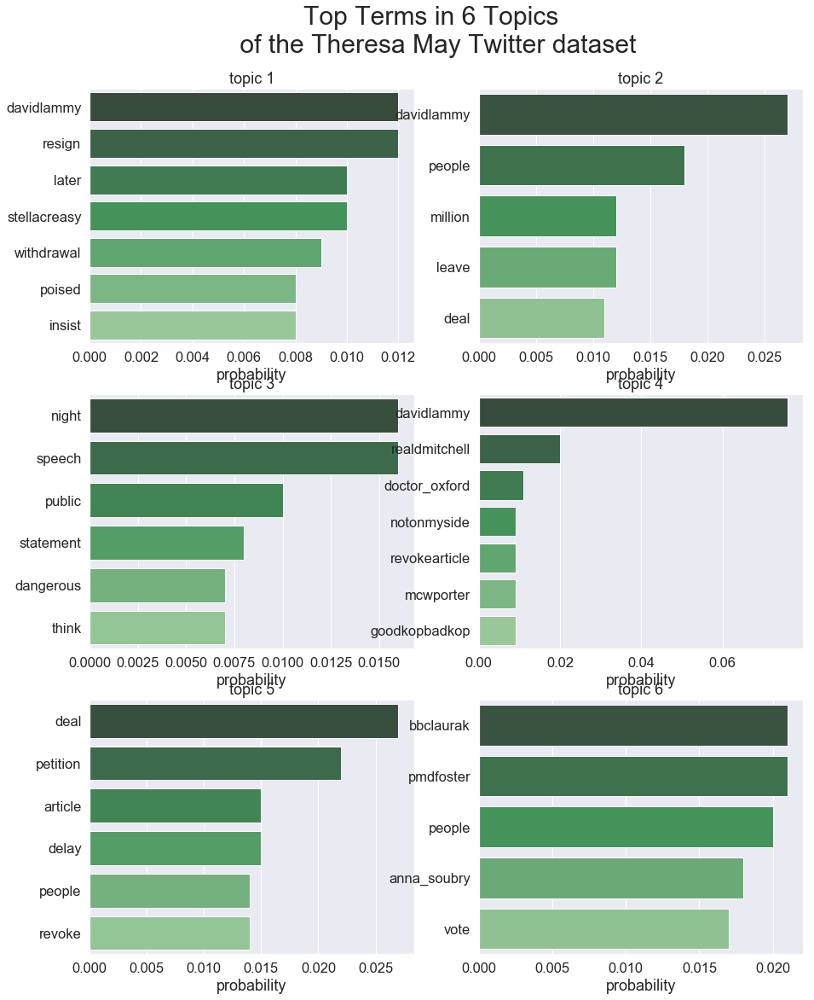

In [15]:
plt.figure(figsize=(15,3*15*((nt+1)/4))); #15
for i in range(nt):
    sns.set(font_scale = 1.5)
    df=pd.DataFrame(sss[i], columns=['term','prob']).set_index('term')
    plt.subplot(nt+1,2,i+1); #5
    plt.title('topic '+str(i+1));
    sns.barplot(x='prob', y=df.index, data=df, label='Cities', palette='Greens_d');
    plt.xlabel('probability');
    plt.ylabel('');
sst="Top Terms in %i Topics \n of %s" %(nt,st1)
plt.suptitle(sst,x=0.5, y=0.91,fontsize=30);

In [16]:
tmterms=[]
for i in range(nt):
    for j in sss[i]:
        if j[0] not in tmterms:
            tmterms.append(j[0])
print len(tmterms)
sorted(tmterms)

31


[u'anna_soubry',
 u'article',
 u'bbclaurak',
 u'dangerous',
 u'davidlammy',
 u'deal',
 u'delay',
 u'doctor_oxford',
 u'goodkopbadkop',
 u'insist',
 u'later',
 u'leave',
 u'mcwporter',
 u'million',
 u'night',
 u'notonmyside',
 u'people',
 u'petition',
 u'pmdfoster',
 u'poised',
 u'public',
 u'realdmitchell',
 u'resign',
 u'revoke',
 u'revokearticle',
 u'speech',
 u'statement',
 u'stellacreasy',
 u'think',
 u'vote',
 u'withdrawal']

In [17]:
tweets_terms_d={}
for k,v in docsd.items():
    I=[]
    sent_text = nltk.sent_tokenize(v)
    for sent in sent_text:
        sent=tokenize(sent)
        J=set(sent).intersection(set(tmterms))
        for j in J:
            if j not in I:
                I.append(j)
    tweets_terms_d[k]=I
print len(tweets_terms_d),len(mt)
for k,v in tweets_terms_d.items():
    print k,v 

4608 4608
0 [u'vote']
1 []
2 []
16388 [u'realdmitchell', u'mcwporter', u'goodkopbadkop']
8197 [u'davidlammy', u'petition']
8193 [u'night']
16392 []
9 []
16394 []
8203 [u'night']
16396 [u'leave']
15021 []
21 []
8214 [u'davidlammy']
16408 [u'davidlammy']
8217 [u'petition']
26 []
14731 []
29 []
8224 []
16418 [u'public', u'article']
13659 []
8228 []
8229 []
40 [u'people', u'think']
8233 []
8234 [u'leave', u'doctor_oxford']
7 [u'deal']
16428 [u'people']
45 []
8239 [u'stellacreasy']
16433 [u'leave']
8243 [u'million', u'davidlammy']
16436 [u'think']
8246 [u'davidlammy']
16440 []
8249 []
16442 []
13663 [u'speech']
16445 []
8254 []
63 [u'realdmitchell', u'mcwporter', u'goodkopbadkop']
8258 []
16451 []
8260 [u'anna_soubry']
16454 []
72 [u'deal', u'people']
8265 [u'vote']
76 [u'davidlammy', u'leave']
8270 [u'davidlammy', u'petition', u'vote', u'deal']
79 []
16465 []
16470 [u'davidlammy']
10937 [u'deal']
90 []
16475 [u'withdrawal']
94 []
16481 []
8290 [u'delay']
8292 []
8293 [u'stellacreasy']
8295

9389 [u'davidlammy']
17582 []
17583 []
17584 [u'pmdfoster']
17585 []
1203 [u'davidlammy', u'petition']
1204 [u'think']
9400 [u'night']
9401 [u'stellacreasy']
9402 []
17599 []
1216 [u'davidlammy']
17601 [u'speech']
17602 []
17603 []
13946 []
1222 []
17607 []
17608 [u'leave', u'public']
204 [u'petition']
9418 []
1229 []
17614 [u'davidlammy', u'public']
9423 [u'people']
9424 []
1235 []
17620 [u'davidlammy', u'deal']
9429 [u'anna_soubry']
1238 [u'people']
9431 []
17624 []
1241 []
12495 [u'people']
9436 [u'leave', u'resign']
17630 []
1247 [u'davidlammy', u'people']
9440 []
15227 [u'doctor_oxford']
9446 [u'night']
9447 []
1256 []
9156 [u'leave', u'deal']
9451 []
1260 []
1261 [u'deal']
9455 []
1265 []
17650 []
17651 []
17654 []
9463 [u'people']
9468 [u'bbclaurak', u'pmdfoster']
17662 [u'pmdfoster']
213 []
1280 [u'petition']
9476 [u'davidlammy']
11137 []
1288 []
1291 []
17676 [u'article', u'revoke']
17678 [u'poised']
1295 []
17680 [u'think']
9489 []
17682 []
1299 []
17686 []
1303 []
17689 [u'a

2297 [u'people']
2298 [u'davidlammy', u'resign']
10497 [u'article', u'revoke', u'petition']
10498 [u'realdmitchell']
10499 []
10502 []
10505 [u'vote']
10506 []
10507 [u'public']
2316 [u'million', u'davidlammy', u'petition']
10509 [u'davidlammy', u'people']
2319 []
2320 []
15406 []
10518 []
10519 [u'stellacreasy']
2329 [u'davidlammy']
10522 [u'davidlammy']
10523 []
2332 [u'deal']
14042 [u'davidlammy']
10527 [u'davidlammy']
2340 [u'resign']
10535 []
10537 [u'davidlammy', u'petition']
2348 []
70 [u'deal']
10542 [u'realdmitchell']
2352 [u'doctor_oxford']
10545 []
10546 [u'vote', u'davidlammy']
393 [u'davidlammy']
10552 []
10553 [u'davidlammy']
10554 []
8586 []
10558 [u'davidlammy', u'petition']
10559 [u'petition']
10560 []
10561 [u'vote']
15946 []
2373 []
10567 []
10571 [u'people']
2383 []
10577 []
10588 []
2398 [u'public']
10591 [u'doctor_oxford']
10592 [u'davidlammy']
8592 []
2402 [u'davidlammy']
15419 [u'doctor_oxford']
2404 []
2405 [u'people']
10599 [u'stellacreasy']
10602 [u'davidlamm

11652 []
9028 [u'stellacreasy']
3463 []
3464 [u'think']
3465 []
11659 []
14300 []
11661 [u'davidlammy']
3472 []
11665 [u'speech']
15626 []
10716 [u'people']
11673 [u'leave']
3482 []
11675 []
11677 [u'davidlammy']
11678 [u'davidlammy']
11680 [u'deal']
11681 [u'delay', u'statement']
11682 []
14235 []
3493 [u'deal']
3494 [u'vote', u'people']
3499 []
3500 [u'million', u'people']
9391 [u'revoke', u'resign']
11694 []
11695 []
11696 [u'realdmitchell']
3508 []
11704 [u'davidlammy']
15604 []
3514 []
3516 [u'davidlammy', u'million', u'petition']
12874 []
3518 []
117 [u'people']
3520 []
11713 []
11714 []
3527 []
3528 []
12876 []
11724 []
11728 []
3537 []
16172 [u'notonmyside']
11732 [u'davidlammy']
12878 []
11738 []
11741 []
11742 [u'davidlammy']
11744 []
3554 []
11749 []
11753 [u'davidlammy']
11754 [u'people']
3563 []
3565 []
11758 []
3567 []
3568 [u'leave', u'deal']
11761 []
11763 [u'deal']
11764 []
15614 []
8788 []
3579 []
11772 [u'deal']
11774 [u'davidlammy']
2847 []
11779 [u'davidlammy', u't

13076 []
3519 [u'delay']
4733 [u'leave', u'public', u'resign']
12928 [u'davidlammy', u'petition']
12929 []
12930 []
4740 [u'million', u'petition', u'vote', u'article', u'revoke']
790 []
2156 []
12938 [u'davidlammy']
12939 [u'article', u'revoke', u'petition']
4753 []
4755 []
12950 []
4759 []
4760 []
12953 [u'davidlammy']
12959 []
8615 []
13998 [u'davidlammy']
4778 [u'deal', u'people']
4780 []
4782 [u'think']
4783 []
4785 [u'leave', u'vote']
4787 []
4788 []
4789 []
4793 [u'davidlammy']
4794 []
4795 []
4797 [u'davidlammy']
4798 []
4800 []
12997 []
4806 []
801 [u'anna_soubry']
4808 [u'pmdfoster']
13001 [u'article', u'revoke']
4811 []
4816 []
13010 [u'petition']
4820 []
13013 []
4822 []
4823 []
706 []
4525 []
4826 [u'article', u'revoke', u'petition']
13020 [u'davidlammy']
13021 [u'davidlammy']
13023 []
13025 [u'bbclaurak', u'pmdfoster']
13026 []
4836 []
4837 [u'notonmyside']
13031 [u'davidlammy', u'petition']
13040 []
13041 [u'million', u'people']
13045 []
707 [u'davidlammy', u'people']
485

5904 []
5080 []
5906 []
5907 [u'night']
5909 [u'delay']
5911 []
986 []
14640 [u'article', u'petition']
987 [u'davidlammy']
14116 []
14117 [u'think']
5927 [u'davidlammy']
5928 []
988 [u'davidlammy', u'leave', u'million']
14125 [u'million', u'davidlammy']
14126 [u'davidlammy']
14127 [u'million', u'davidlammy']
5938 []
2801 [u'leave', u'million']
14134 []
15206 [u'statement']
14644 []
16292 []
14141 [u'bbclaurak', u'pmdfoster']
14142 [u'think']
5955 []
5961 [u'delay']
5964 []
5971 []
5972 [u'poised', u'later', u'insist', u'withdrawal']
14166 [u'davidlammy', u'petition']
2361 [u'davidlammy']
5976 [u'resign']
5978 [u'davidlammy']
5979 []
8928 [u'delay']
14175 []
5984 [u'deal']
16329 [u'public', u'statement', u'night']
14180 []
5989 [u'davidlammy']
5991 []
5994 [u'davidlammy']
5995 []
14189 [u'vote', u'article', u'pmdfoster']
14657 [u'davidlammy']
6461 [u'davidlammy']
14194 [u'public']
6004 []
13289 []
14200 [u'vote']
14203 []
6012 []
1002 []
14207 []
2368 []
6018 [u'davidlammy']
640 [u'real

7173 []
15487 []
15369 [u'people']
7178 []
14505 []
2562 [u'davidlammy']
13485 [u'million', u'davidlammy']
7184 [u'notonmyside']
7185 [u'davidlammy']
7877 []
7189 []
7190 []
7193 []
7194 [u'public']
1199 [u'vote', u'davidlammy']
785 []
15389 []
7201 [u'doctor_oxford']
12123 [u'statement']
7204 []
6662 []
8013 [u'article', u'deal']
15401 []
15404 [u'think', u'pmdfoster']
7214 []
7215 [u'deal']
15409 []
7218 [u'million', u'davidlammy']
15413 [u'vote', u'davidlammy', u'petition']
7222 [u'article', u'deal']
7224 []
5300 [u'article', u'revoke', u'petition', u'people']
15418 [u'leave', u'doctor_oxford', u'deal']
7227 []
15422 []
1537 [u'davidlammy']
7232 []
7233 []
15427 [u'deal']
15434 []
15435 [u'article', u'revoke', u'deal']
7244 [u'realdmitchell']
15437 [u'leave', u'anna_soubry']
1605 []
14861 []
15442 [u'night']
3939 []
2574 []
7256 []
5847 []
7262 [u'article', u'revoke', u'petition']
7263 []
15456 []
15458 [u'statement']
9050 [u'leave']
15462 [u'leave']
11426 [u'speech']
8971 []
7273 [

In [18]:
tm_terms=[]
for i in range(len(mt)):
    for k,v in tweets_terms_d.items():
        if mt.index.values[i]==k:  #i==k:  #
#             print i,v
            tm_terms.append(v)
len(tm_terms)
mt['tm_terms']=tm_terms
mt=mt[['hashtags_list','mention_tweeple','tm_terms']]
mt[-50:]

,hashtags_list,mention_tweeple,tm_terms
187,[],"[@truthsoldier14, @theresa_may]","[deal, people]"
185,[#worldpoetryday],[@oakley_doakley],"[vote, people]"
176,[],"[@seasidedad22, @DavidLammy, @theresa_may]","[million, davidlammy]"
179,[],[@YescafeEdSouth],[think]
178,[],[@Matthew_Flowers],[dangerous]
168,[],"[@bubblyhubbly51, @10DowningStreet, @theresa_may]",[]
157,[],[@theipaper],"[leave, delay, article]"
148,[],"[@BagLady83860648, @RealDMitchell, @theresa_may]","[realdmitchell, night]"
145,[],"[@wisteriawitch, @theresa_may]",[]
147,[],"[@Groundie46, @Angela_J_Bailey, @DavidLammy, @...",[davidlammy]


In [19]:
mt[-53:]

,hashtags_list,mention_tweeple,tm_terms
195,[#nodeal],"[@cheekylatte, @jeremycorbyn]",[]
190,[],"[@cazram1, @inabster, @Conservatives, @theresa...",[]
193,[],"[@Dave_offshore, @RuggybearAl, @KieranPAndrews...",[]
187,[],"[@truthsoldier14, @theresa_may]","[deal, people]"
185,[#worldpoetryday],[@oakley_doakley],"[vote, people]"
176,[],"[@seasidedad22, @DavidLammy, @theresa_may]","[million, davidlammy]"
179,[],[@YescafeEdSouth],[think]
178,[],[@Matthew_Flowers],[dangerous]
168,[],"[@bubblyhubbly51, @10DowningStreet, @theresa_may]",[]
157,[],[@theipaper],"[leave, delay, article]"


In [20]:
hashtags=[]
tweeple=[]
terms=[]
for i in range(len(mt)):
    for a in mt.iloc[i]["hashtags_list"]:
        hashtags.append(a)
    for b in mt.iloc[i]["mention_tweeple"]:
        tweeple.append(b)
    for c in mt.iloc[i]["tm_terms"]:
        terms.append(c)
print "Hashtags:", len(hashtags), len(set(hashtags))
print "Tweeple:", len(tweeple), len(set(tweeple))
print "Terms:", len(terms), len(set(terms))

Hashtags: 783 285
Tweeple: 13391 5039
Terms: 3404 30


In [21]:
x=Counter(hashtags)
x=x.most_common()
x

[(u'#brexit', 159),
 (u'#revokearticle50', 100),
 (u'#notonmyside', 46),
 (u'#peoplesvote', 20),
 (u'#maymustgo', 19),
 (u'#theresamay', 14),
 (u'#eu', 12),
 (u'#revokea50', 10),
 (u'#revokea50now', 10),
 (u'#stopbrexit', 8),
 (u'#worldpoetryday', 8),
 (u'#news', 7),
 (u'#notinmyname', 6),
 (u'#putittothepeople', 5),
 (u'#revokearticle50now', 5),
 (u'#politics', 5),
 (u'#may', 5),
 (u'#nodeal', 5),
 (u'#fbpe', 5),
 (u'#uk', 5),
 (u'#politicslive', 4),
 (u'#revokeart50', 4),
 (u'#article50', 4),
 (u'#isitok', 4),
 (u'#leavemeansleave', 4),
 (u'#remain', 4),
 (u'#brexitshambles', 3),
 (u'#brexitchaos', 3),
 (u'#macron', 3),
 (u'#finalsay', 3),
 (u'#traitor', 3),
 (u'#theresa_may', 3),
 (u'#letsgowto', 3),
 (u'#peoplesvotemarch', 3),
 (u'#exitbrexit', 2),
 (u'#mv3', 2),
 (u'#merkel', 2),
 (u'#breaking', 2),
 (u'#maymustgonow', 2),
 (u'#brexshit', 2),
 (u'#gtto', 2),
 (u'#france', 2),
 (u'#brexitextension', 2),
 (u'#brussels', 2),
 (u'#dictatormay', 2),
 (u'#leave', 2),
 (u'#stopbrexitsave

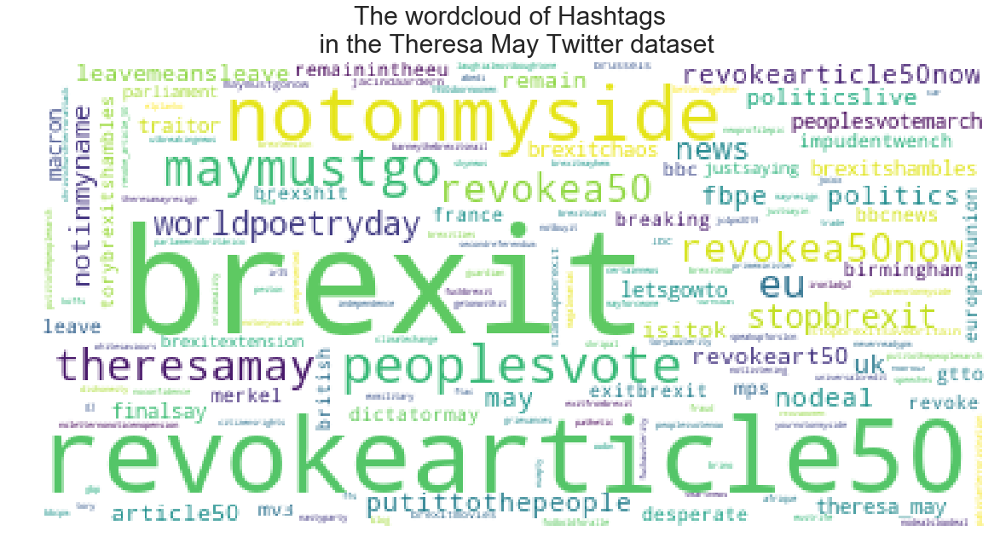

In [22]:
# t=[]
# for (i,j) in x:
#     for k in range(j):
#         t.append(i)
# tt=' '.join(t)
# wordcloud = WordCloud(collocations=False,background_color="white").generate(tt) #,width=200, height=200
# fig = plt.figure(figsize=(20,20))
# plt.imshow(wordcloud);
# sst="The wordcloud of Hashtags \n in %s" %st1
# plt.title(sst,fontsize=30)
# plt.axis("off");

Image(filename = "Figs/1.png", width=600, height=600)

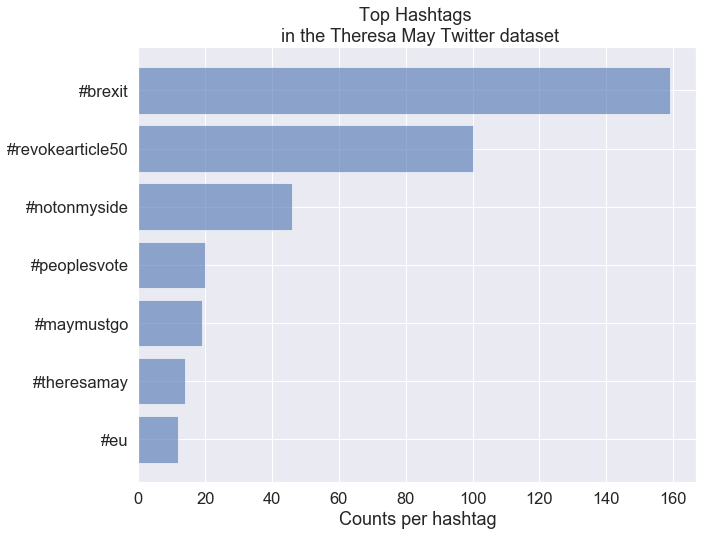

In [23]:
x=[(i,j) for (i,j) in x if j>10]
keys = [i for (i,j) in x] 
y_pos = np.arange(len(keys))
performance = [j for (i,j) in x] 
plt.figure(figsize=(10,8))
ax = plt.axes()
plt.barh(y_pos, performance, align='center', alpha=0.6) 
ax.invert_yaxis()
plt.yticks(y_pos, keys)
plt.xlabel('Counts per hashtag')
sst='Top Hashtags \n in %s' %st1
plt.title(sst)
plt.show()

In [24]:
x=Counter(tweeple)
x=x.most_common()
x

[(u'@theresa_may', 2949),
 (u'@DavidLammy', 650),
 (u'@RealDMitchell', 154),
 (u'@Conservatives', 124),
 (u'@jeremycorbyn', 98),
 (u'@pmdfoster', 82),
 (u'@10DowningStreet', 78),
 (u'@Anna_Soubry', 75),
 (u'@bbclaurak', 75),
 (u'@doctor_oxford', 70),
 (u'@MCWPorter', 66),
 (u'@GoodKopBadKop', 58),
 (u'@SamCoatesTimes', 51),
 (u'@Steven_Swinford', 51),
 (u'@wesstreeting', 47),
 (u'@stellacreasy', 47),
 (u'@GeorgeWParker', 47),
 (u'@peoplesvote_uk', 45),
 (u'@SkyNews', 44),
 (u'@Biswas18', 37),
 (u'@Nigel_Farage', 35),
 (u'@gavinesler', 31),
 (u'@HandsDot', 29),
 (u'@UKLabour', 29),
 (u'@MattScript', 29),
 (u'@sarahwollaston', 27),
 (u'@Peston', 27),
 (u'@rkhargreaves', 26),
 (u'@RichPolitical', 26),
 (u'@BBCNews', 25),
 (u'@eucopresident', 25),
 (u'@mrjamesob', 24),
 (u'@JaneMundon', 23),
 (u'@ARH1902', 22),
 (u'@BBCPolitics', 22),
 (u'@KarlTurnerMP', 22),
 (u'@ChukaUmunna', 22),
 (u'@realDonaldTrump', 21),
 (u'@PbaxterPeter', 20),
 (u'@markcarline44', 20),
 (u'@harriette_cs', 19),
 (u'

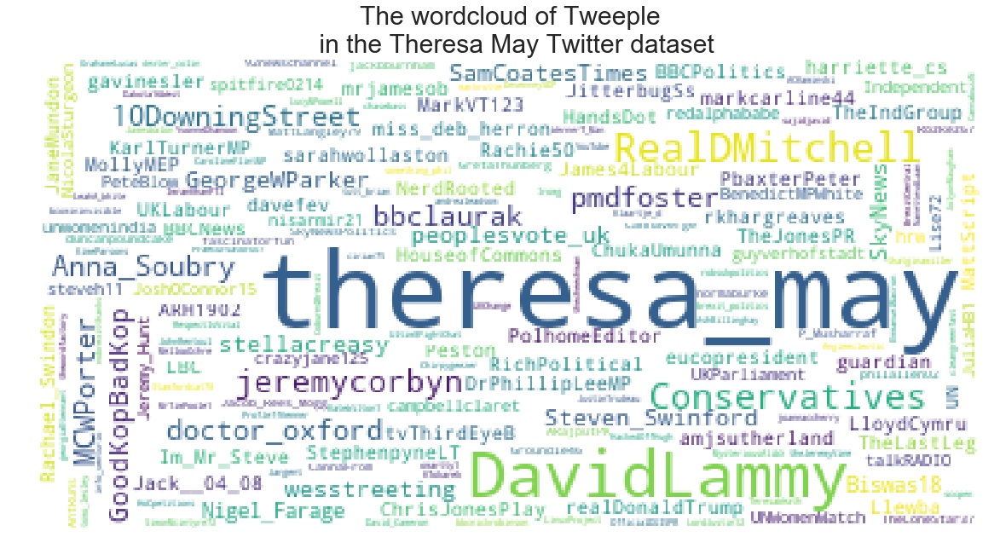

In [25]:
# t=[]
# for (i,j) in x:
#     for k in range(j):
#         t.append(i)
# tt=' '.join(t)
# wordcloud = WordCloud(collocations=False,background_color="white").generate(tt) #,width=200, height=200
# fig = plt.figure(figsize=(20,20))
# plt.imshow(wordcloud);
# sst="The wordcloud of Tweeple \n in %s" %st1
# plt.title(sst,fontsize=30)
# plt.axis("off");

Image(filename = "Figs/2.png", width=600, height=600)

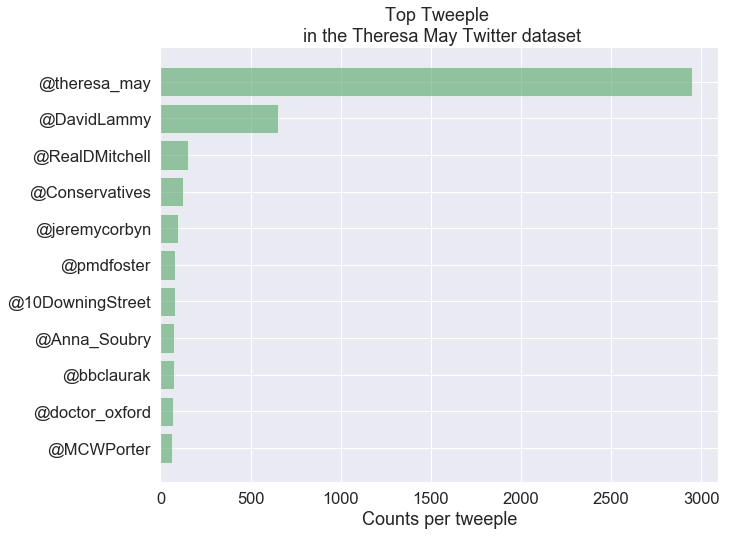

In [26]:
x=[(i,j) for (i,j) in x if j>60]
keys = [i for (i,j) in x] 
y_pos = np.arange(len(keys))
performance = [j for (i,j) in x] 
plt.figure(figsize=(10,8))
ax = plt.axes()
plt.barh(y_pos, performance, align='center',color="g", alpha=0.6) 
ax.invert_yaxis()
plt.yticks(y_pos, keys)
plt.xlabel('Counts per tweeple')
sst='Top Tweeple \n in %s' %st1
plt.title(sst)
plt.show()

In [27]:
x=Counter(terms)
x=x.most_common()
x

[(u'davidlammy', 650),
 (u'people', 312),
 (u'deal', 228),
 (u'petition', 196),
 (u'realdmitchell', 154),
 (u'leave', 148),
 (u'vote', 137),
 (u'think', 125),
 (u'million', 117),
 (u'article', 98),
 (u'delay', 96),
 (u'revoke', 91),
 (u'public', 89),
 (u'pmdfoster', 80),
 (u'anna_soubry', 75),
 (u'speech', 75),
 (u'bbclaurak', 74),
 (u'night', 74),
 (u'doctor_oxford', 69),
 (u'mcwporter', 62),
 (u'resign', 61),
 (u'goodkopbadkop', 57),
 (u'statement', 49),
 (u'withdrawal', 47),
 (u'stellacreasy', 46),
 (u'notonmyside', 45),
 (u'later', 45),
 (u'insist', 38),
 (u'poised', 37),
 (u'dangerous', 29)]

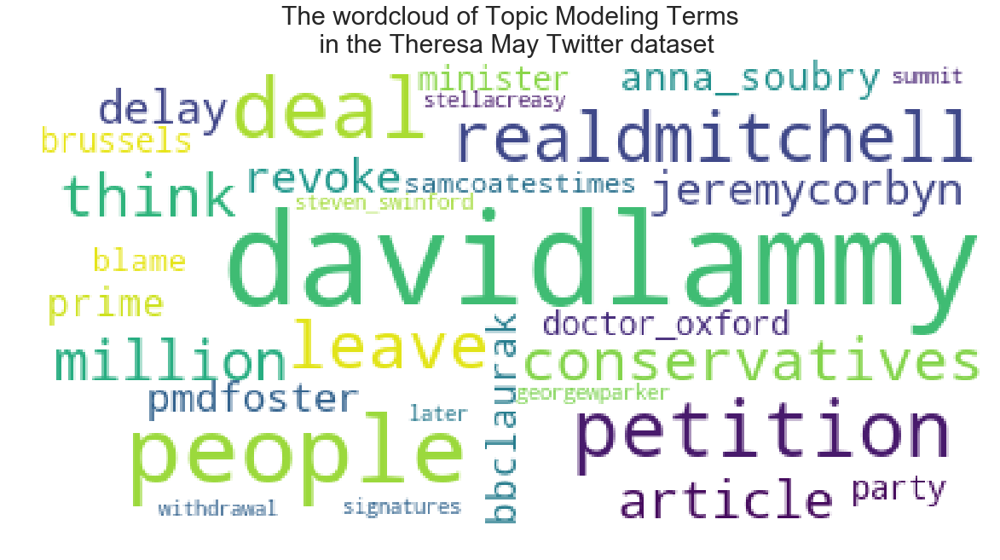

In [28]:
# t=[]
# for (i,j) in x:
#     for k in range(j):
#         t.append(i)
# tt=' '.join(t)
# wordcloud = WordCloud(collocations=False,background_color="white").generate(tt) #,width=200, height=200
# fig = plt.figure(figsize=(20,20))
# plt.imshow(wordcloud);
# sst="The wordcloud of Topic Modeling Terms \n in %s" %st1
# plt.title(sst,fontsize=30)
# plt.axis("off");

Image(filename = "Figs/3.png", width=600, height=600)

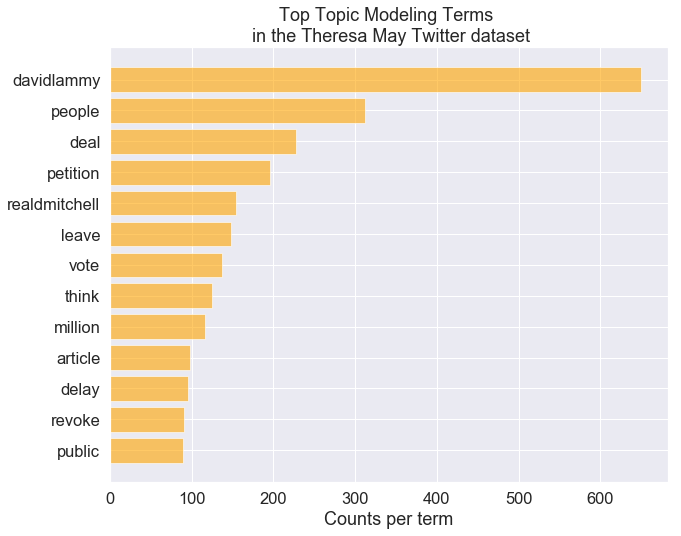

In [29]:
x=[(i,j) for (i,j) in x if j>80]
keys = [i for (i,j) in x] 
y_pos = np.arange(len(keys))
performance = [j for (i,j) in x] 
plt.figure(figsize=(10,8))
ax = plt.axes()
plt.barh(y_pos, performance, align='center',color="orange", alpha=0.6) 
ax.invert_yaxis()
plt.yticks(y_pos, keys)
plt.xlabel('Counts per term')
sst='Top Topic Modeling Terms \n in %s' %st1
plt.title(sst)
plt.show()

### 2. The Graph of All Co-Occurrences

In [30]:
coocs=[]
for i in range(len(mt)):
    ind=mt.index.values[i]
    ha=mt.iloc[i]["hashtags_list"]
    tw=mt.iloc[i]["mention_tweeple"]
    te=mt.iloc[i]["tm_terms"]
    if len(ha)>0:
        for j in itertools.combinations(ha, 2):
            if j[0]!=j[1]:
                coocs.append((j[0],j[1],ind))
    if len(tw)>0:
        for j in itertools.combinations(tw, 2):
            if j[0]!=j[1]:
                coocs.append((j[0],j[1],ind))
    if len(te)>0:
        for j in itertools.combinations(te, 2):
            if j[0]!=j[1]:
                coocs.append((j[0],j[1],ind))
    if len(ha)>0 and len(tw)>0:
        for k in ha:
            for l in tw:
                coocs.append((k,l,ind))
    if len(ha)>0 and len(te)>0:
        for k in ha:
            for l in te:
                coocs.append((k,l,ind))
    if len(te)>0 and len(tw)>0:
        for k in tw:
            for l in te:
                coocs.append((k,l,ind))
print len(coocs),len(set(coocs))
for e in coocs:
    print e

34731 34718
(u'@Nigel_Farage', u'@theresa_may', 2)
(u'@Nigel_Farage', u'@Conservatives', 2)
(u'@theresa_may', u'@Conservatives', 2)
(u'@doctor_oxford', u'@theresa_may', 0)
(u'@doctor_oxford', u'vote', 0)
(u'@theresa_may', u'vote', 0)
(u'@timchipping', u'think', 17816)
(u'@anovicekong', u'@theresa_may', 17818)
(u'@CheeksRossie', u'@theresa_may', 17813)
(u'@CheeksRossie', u'@UKIP', 17813)
(u'@theresa_may', u'@UKIP', 17813)
(u'@CheeksRossie', u'vote', 17813)
(u'@theresa_may', u'vote', 17813)
(u'@UKIP', u'vote', 17813)
(u'@LeonWatson', u'@theresa_may', 17811)
(u'@MrTrip', u'@RealDMitchell', 17810)
(u'@MrTrip', u'@theresa_may', 17810)
(u'@RealDMitchell', u'@theresa_may', 17810)
(u'realdmitchell', u'vote', 17810)
(u'@MrTrip', u'realdmitchell', 17810)
(u'@MrTrip', u'vote', 17810)
(u'@RealDMitchell', u'realdmitchell', 17810)
(u'@RealDMitchell', u'vote', 17810)
(u'@theresa_may', u'realdmitchell', 17810)
(u'@theresa_may', u'vote', 17810)
(u'@SabotagedFool2', u'@WMPolice', 17808)
(u'@SabotagedFoo

(u'@MrTimPoole1', u'@SamCoatesTimes', 17165)
(u'@MrTimPoole1', u'@Steven_Swinford', 17165)
(u'@MrTimPoole1', u'@GeorgeWParker', 17165)
(u'@ProfJeffKenner', u'@theresa_may', 17165)
(u'@ProfJeffKenner', u'@bbclaurak', 17165)
(u'@ProfJeffKenner', u'@SamCoatesTimes', 17165)
(u'@ProfJeffKenner', u'@Steven_Swinford', 17165)
(u'@ProfJeffKenner', u'@GeorgeWParker', 17165)
(u'@theresa_may', u'@bbclaurak', 17165)
(u'@theresa_may', u'@SamCoatesTimes', 17165)
(u'@theresa_may', u'@Steven_Swinford', 17165)
(u'@theresa_may', u'@GeorgeWParker', 17165)
(u'@bbclaurak', u'@SamCoatesTimes', 17165)
(u'@bbclaurak', u'@Steven_Swinford', 17165)
(u'@bbclaurak', u'@GeorgeWParker', 17165)
(u'@SamCoatesTimes', u'@Steven_Swinford', 17165)
(u'@SamCoatesTimes', u'@GeorgeWParker', 17165)
(u'@Steven_Swinford', u'@GeorgeWParker', 17165)
(u'bbclaurak', u'pmdfoster', 17165)
(u'@fascinatorfun', u'bbclaurak', 17165)
(u'@fascinatorfun', u'pmdfoster', 17165)
(u'@pmdfoster', u'bbclaurak', 17165)
(u'@pmdfoster', u'pmdfoster', 

(u'@uk_sf_writer', u'leave', 16879)
(u'@theresa_may', u'leave', 16879)
(u'@Ian56789', u'@sjparis', 16880)
(u'@Ian56789', u'@_KeyserSoze_79', 16880)
(u'@Ian56789', u'@DavidLammy', 16880)
(u'@sjparis', u'@_KeyserSoze_79', 16880)
(u'@sjparis', u'@DavidLammy', 16880)
(u'@_KeyserSoze_79', u'@DavidLammy', 16880)
(u'@Ian56789', u'davidlammy', 16880)
(u'@sjparis', u'davidlammy', 16880)
(u'@_KeyserSoze_79', u'davidlammy', 16880)
(u'@DavidLammy', u'davidlammy', 16880)
(u'@SuboptPlanet', u'@iainmartin1', 16876)
(u'@SuboptPlanet', u'@theresa_may', 16876)
(u'@iainmartin1', u'@theresa_may', 16876)
(u'@clavedoc', u'@theresa_may', 16870)
(u'@clavedoc', u'deal', 16870)
(u'@theresa_may', u'deal', 16870)
(u'@PreetiRU', u'@theresa_may', 16861)
(u'@jamesgr03053765', u'@DavidLammy', 16862)
(u'@jamesgr03053765', u'@theresa_may', 16862)
(u'@DavidLammy', u'@theresa_may', 16862)
(u'@jamesgr03053765', u'davidlammy', 16862)
(u'@DavidLammy', u'davidlammy', 16862)
(u'@theresa_may', u'davidlammy', 16862)
(u'@PaulDBr

(u'@guardian', u'@UNWomenWatch', 16481)
(u'@guardian', u'@unwomenindia', 16481)
(u'@guardian', u'@cannaverge', 16481)
(u'@guardian', u'@CannabuzzN', 16481)
(u'@UN', u'@hrw', 16481)
(u'@UN', u'@UNWomenWatch', 16481)
(u'@UN', u'@unwomenindia', 16481)
(u'@UN', u'@cannaverge', 16481)
(u'@UN', u'@CannabuzzN', 16481)
(u'@hrw', u'@UNWomenWatch', 16481)
(u'@hrw', u'@unwomenindia', 16481)
(u'@hrw', u'@cannaverge', 16481)
(u'@hrw', u'@CannabuzzN', 16481)
(u'@UNWomenWatch', u'@unwomenindia', 16481)
(u'@UNWomenWatch', u'@cannaverge', 16481)
(u'@UNWomenWatch', u'@CannabuzzN', 16481)
(u'@unwomenindia', u'@cannaverge', 16481)
(u'@unwomenindia', u'@CannabuzzN', 16481)
(u'@cannaverge', u'@CannabuzzN', 16481)
(u'@Mdreadedtwit', u'withdrawal', 16475)
(u'@VictoriaKingF', u'@DavidLammy', 16470)
(u'@VictoriaKingF', u'@theresa_may', 16470)
(u'@VictoriaKingF', u'@HughRBennett', 16470)
(u'@DavidLammy', u'@theresa_may', 16470)
(u'@DavidLammy', u'@HughRBennett', 16470)
(u'@theresa_may', u'@HughRBennett', 16470)


(u'@nadialanomade', u'@theresa_may', 15857)
(u'@HackedOffHugh', u'@theresa_may', 15857)
(u'@tucker_djt', u'@Mark_Couper', 15858)
(u'@tucker_djt', u'@theresa_may', 15858)
(u'@Mark_Couper', u'@theresa_may', 15858)
(u'@CitizenCynical', u'@HMRCVictim', 15844)
(u'@CitizenCynical', u'@LCAG_2019', 15844)
(u'@CitizenCynical', u'@loanchargeAPPG', 15844)
(u'@CitizenCynical', u'@AlecShelbrooke', 15844)
(u'@CitizenCynical', u'@MaryRobinson01', 15844)
(u'@HMRCVictim', u'@LCAG_2019', 15844)
(u'@HMRCVictim', u'@loanchargeAPPG', 15844)
(u'@HMRCVictim', u'@AlecShelbrooke', 15844)
(u'@HMRCVictim', u'@MaryRobinson01', 15844)
(u'@LCAG_2019', u'@loanchargeAPPG', 15844)
(u'@LCAG_2019', u'@AlecShelbrooke', 15844)
(u'@LCAG_2019', u'@MaryRobinson01', 15844)
(u'@loanchargeAPPG', u'@AlecShelbrooke', 15844)
(u'@loanchargeAPPG', u'@MaryRobinson01', 15844)
(u'@AlecShelbrooke', u'@MaryRobinson01', 15844)
(u'@AdamKoszary', u'speech', 15846)
(u'@mcwarthog', u'@Jacob_Rees_Mogg', 15836)
(u'@mcwarthog', u'public', 15836)

(u'@IofWBobSeely', u'@Conservatives', 15198)
(u'@Nigel_Farage', u'@theresa_may', 15198)
(u'@Nigel_Farage', u'@Conservatives', 15198)
(u'@theresa_may', u'@Conservatives', 15198)
(u'@spencerwilson8', u'@mrjamesob', 15192)
(u'@spencerwilson8', u'@LBC', 15192)
(u'@spencerwilson8', u'@theresa_may', 15192)
(u'@mrjamesob', u'@LBC', 15192)
(u'@mrjamesob', u'@theresa_may', 15192)
(u'@LBC', u'@theresa_may', 15192)
(u'#revokearticle50now', u'@spencerwilson8', 15192)
(u'#revokearticle50now', u'@mrjamesob', 15192)
(u'#revokearticle50now', u'@LBC', 15192)
(u'#revokearticle50now', u'@theresa_may', 15192)
(u'@suzi_is_cake', u'@theresa_may', 15190)
(u'@maroonman1874', u'@theresa_may', 15186)
(u'@New_Narrative', u'delay', 15181)
(u'@Tomfurness2', u'@Mancman10', 15173)
(u'@Tomfurness2', u'@david_clarke91', 15173)
(u'@Tomfurness2', u'@theresa_may', 15173)
(u'@Tomfurness2', u'@mrclatimer1985', 15173)
(u'@Mancman10', u'@david_clarke91', 15173)
(u'@Mancman10', u'@theresa_may', 15173)
(u'@Mancman10', u'@mrcla

(u'@ScottTh79863772', u'@DavidLammy', 14530)
(u'@ScottTh79863772', u'@theresa_may', 14530)
(u'@DavidLammy', u'@theresa_may', 14530)
(u'@ScottTh79863772', u'davidlammy', 14530)
(u'@DavidLammy', u'davidlammy', 14530)
(u'@theresa_may', u'davidlammy', 14530)
(u'@K28Pygmalion', u'@Gurnardpink', 14522)
(u'@K28Pygmalion', u'@sazmeister88', 14522)
(u'@K28Pygmalion', u'@theresa_may', 14522)
(u'@Gurnardpink', u'@sazmeister88', 14522)
(u'@Gurnardpink', u'@theresa_may', 14522)
(u'@sazmeister88', u'@theresa_may', 14522)
(u'@KimBru49', u'@FXMC1957', 14517)
(u'@1AndyPurchase', u'@Shortbloke', 14514)
(u'@1AndyPurchase', u'@jeremycorbyn', 14514)
(u'@Shortbloke', u'@jeremycorbyn', 14514)
(u'@Tobes1234', u'@DavidLammy', 14512)
(u'@Tobes1234', u'@theresa_may', 14512)
(u'@DavidLammy', u'@theresa_may', 14512)
(u'leave', u'davidlammy', 14512)
(u'leave', u'public', 14512)
(u'davidlammy', u'public', 14512)
(u'@Tobes1234', u'leave', 14512)
(u'@Tobes1234', u'davidlammy', 14512)
(u'@Tobes1234', u'public', 14512)


(u'@theresa_may', u'realdmitchell', 13777)
(u'@LittlebroGaymer', u'@theresa_may', 13769)
(u'@Biswas18', u'@gillinghamjoe', 13771)
(u'@Biswas18', u'@theresa_may', 13771)
(u'@gillinghamjoe', u'@theresa_may', 13771)
(u'@Biswas18', u'deal', 13771)
(u'@gillinghamjoe', u'deal', 13771)
(u'@theresa_may', u'deal', 13771)
(u'@TiggerTherese', u'@theresa_may', 13762)
(u'@TiggerTherese', u'@HoCpetitions', 13762)
(u'@theresa_may', u'@HoCpetitions', 13762)
(u'#revokearticle50', u'@TiggerTherese', 13762)
(u'#revokearticle50', u'@theresa_may', 13762)
(u'#revokearticle50', u'@HoCpetitions', 13762)
(u'#revokearticle50', u'petition', 13762)
(u'@TiggerTherese', u'petition', 13762)
(u'@theresa_may', u'petition', 13762)
(u'@HoCpetitions', u'petition', 13762)
(u'@JamieLeeBrett', u'@georgiaEtennant', 13765)
(u'@JamieLeeBrett', u'@theresa_may', 13765)
(u'@georgiaEtennant', u'@theresa_may', 13765)
(u'@JamieLeeBrett', u'public', 13765)
(u'@georgiaEtennant', u'public', 13765)
(u'@theresa_may', u'public', 13765)
(u

(u'@ARajputPK', u'@92newschannel', 13160)
(u'@ARajputPK', u'@OfficialDGISPR', 13160)
(u'@ARajputPK', u'@realDonaldTrump', 13160)
(u'@ARajputPK', u'@JustinTrudeau', 13160)
(u'@ARajputPK', u'@ImranKhanPTI', 13160)
(u'@ARajputPK', u'@P_Musharraf', 13160)
(u'@ARajputPK', u'@theresa_may', 13160)
(u'@92newschannel', u'@OfficialDGISPR', 13160)
(u'@92newschannel', u'@realDonaldTrump', 13160)
(u'@92newschannel', u'@JustinTrudeau', 13160)
(u'@92newschannel', u'@ImranKhanPTI', 13160)
(u'@92newschannel', u'@P_Musharraf', 13160)
(u'@92newschannel', u'@theresa_may', 13160)
(u'@OfficialDGISPR', u'@realDonaldTrump', 13160)
(u'@OfficialDGISPR', u'@JustinTrudeau', 13160)
(u'@OfficialDGISPR', u'@ImranKhanPTI', 13160)
(u'@OfficialDGISPR', u'@P_Musharraf', 13160)
(u'@OfficialDGISPR', u'@theresa_may', 13160)
(u'@realDonaldTrump', u'@JustinTrudeau', 13160)
(u'@realDonaldTrump', u'@ImranKhanPTI', 13160)
(u'@realDonaldTrump', u'@P_Musharraf', 13160)
(u'@realDonaldTrump', u'@theresa_may', 13160)
(u'@JustinTrude

(u'@pliget', u'@fnbarker', 12607)
(u'@pliget', u'@theresa_may', 12607)
(u'@DalekWhitehurst', u'@chelsian', 12607)
(u'@DalekWhitehurst', u'@fnbarker', 12607)
(u'@DalekWhitehurst', u'@theresa_may', 12607)
(u'@chelsian', u'@fnbarker', 12607)
(u'@chelsian', u'@theresa_may', 12607)
(u'@fnbarker', u'@theresa_may', 12607)
(u'@GarethEdwards78', u'@doctor_oxford', 12594)
(u'@GarethEdwards78', u'@R_J_Foster', 12594)
(u'@GarethEdwards78', u'@theresa_may', 12594)
(u'@doctor_oxford', u'@R_J_Foster', 12594)
(u'@doctor_oxford', u'@theresa_may', 12594)
(u'@R_J_Foster', u'@theresa_may', 12594)
(u'@GarethEdwards78', u'doctor_oxford', 12594)
(u'@doctor_oxford', u'doctor_oxford', 12594)
(u'@R_J_Foster', u'doctor_oxford', 12594)
(u'@theresa_may', u'doctor_oxford', 12594)
(u'@Jimboprat', u'@drama_mc', 12588)
(u'@Jimboprat', u'@RealDMitchell', 12588)
(u'@Jimboprat', u'@theresa_may', 12588)
(u'@drama_mc', u'@RealDMitchell', 12588)
(u'@drama_mc', u'@theresa_may', 12588)
(u'@RealDMitchell', u'@theresa_may', 125

(u'@markhyson', u'@AnchorCake', 11998)
(u'@markhyson', u'vote', 11998)
(u'@AnchorCake', u'vote', 11998)
(u'@FranWright2', u'@step_emma', 11992)
(u'@FranWright2', u'@RealDMitchell', 11992)
(u'@FranWright2', u'@theresa_may', 11992)
(u'@step_emma', u'@RealDMitchell', 11992)
(u'@step_emma', u'@theresa_may', 11992)
(u'@RealDMitchell', u'@theresa_may', 11992)
(u'@FranWright2', u'realdmitchell', 11992)
(u'@step_emma', u'realdmitchell', 11992)
(u'@RealDMitchell', u'realdmitchell', 11992)
(u'@theresa_may', u'realdmitchell', 11992)
(u'@Knightsaber_ks', u'@theresa_may', 11991)
(u'@MaahesMennie', u'@EUCouncilPress', 11986)
(u'@MaahesMennie', u'@Coburn4Brexit', 11986)
(u'@MaahesMennie', u'@eucopresident', 11986)
(u'@MaahesMennie', u'@theresa_may', 11986)
(u'@EUCouncilPress', u'@Coburn4Brexit', 11986)
(u'@EUCouncilPress', u'@eucopresident', 11986)
(u'@EUCouncilPress', u'@theresa_may', 11986)
(u'@Coburn4Brexit', u'@eucopresident', 11986)
(u'@Coburn4Brexit', u'@theresa_may', 11986)
(u'@eucopresident',

(u'@DavidLammy', u'@theresa_may', 11459)
(u'million', u'davidlammy', 11459)
(u'@sebbrown86', u'million', 11459)
(u'@sebbrown86', u'davidlammy', 11459)
(u'@DavidLammy', u'million', 11459)
(u'@DavidLammy', u'davidlammy', 11459)
(u'@theresa_may', u'million', 11459)
(u'@theresa_may', u'davidlammy', 11459)
(u'@D_West1978', u'@theresa_may', 11457)
(u'people', u'leave', 11457)
(u'@D_West1978', u'people', 11457)
(u'@D_West1978', u'leave', 11457)
(u'@theresa_may', u'people', 11457)
(u'@theresa_may', u'leave', 11457)
(u'@0nContradiction', u'vote', 11456)
(u'#revokearticle50', u'#theresamayresign', 11448)
(u'@heyitisrebecca', u'@theresa_may', 11448)
(u'#revokearticle50', u'@heyitisrebecca', 11448)
(u'#revokearticle50', u'@theresa_may', 11448)
(u'#theresamayresign', u'@heyitisrebecca', 11448)
(u'#theresamayresign', u'@theresa_may', 11448)
(u'#revokearticle50', u'resign', 11448)
(u'#theresamayresign', u'resign', 11448)
(u'@heyitisrebecca', u'resign', 11448)
(u'@theresa_may', u'resign', 11448)
(u'@m

(u'#revokeart50', u'@loadofbillhooks', 10774)
(u'#revokeart50', u'@theresa_may', 10774)
(u'#notonmyside', u'notonmyside', 10774)
(u'#revokeart50', u'notonmyside', 10774)
(u'@loadofbillhooks', u'notonmyside', 10774)
(u'@theresa_may', u'notonmyside', 10774)
(u'@CELESTRON1957', u'@theresa_may', 10766)
(u'@kensgriffin', u'@theresa_may', 10763)
(u'@kensgriffin', u'think', 10763)
(u'@theresa_may', u'think', 10763)
(u'@AndrewFurr3', u'@DavidLammy', 10760)
(u'@AndrewFurr3', u'@theresa_may', 10760)
(u'@DavidLammy', u'@theresa_may', 10760)
(u'davidlammy', u'people', 10760)
(u'@AndrewFurr3', u'davidlammy', 10760)
(u'@AndrewFurr3', u'people', 10760)
(u'@DavidLammy', u'davidlammy', 10760)
(u'@DavidLammy', u'people', 10760)
(u'@theresa_may', u'davidlammy', 10760)
(u'@theresa_may', u'people', 10760)
(u'@sisfridge', u'speech', 10758)
(u'@beccycarr', u'@RealDMitchell', 10750)
(u'@beccycarr', u'@theresa_may', 10750)
(u'@RealDMitchell', u'@theresa_may', 10750)
(u'realdmitchell', u'people', 10750)
(u'@bec

(u'@sjparis', u'@_KeyserSoze_79', 10078)
(u'@sjparis', u'@DavidLammy', 10078)
(u'@_KeyserSoze_79', u'@DavidLammy', 10078)
(u'@Ian56789', u'davidlammy', 10078)
(u'@sjparis', u'davidlammy', 10078)
(u'@_KeyserSoze_79', u'davidlammy', 10078)
(u'@DavidLammy', u'davidlammy', 10078)
(u'night', u'public', 10076)
(u'night', u'withdrawal', 10076)
(u'public', u'withdrawal', 10076)
(u'#brexit', u'@BreakfastNT', 10076)
(u'#brexit', u'night', 10076)
(u'#brexit', u'public', 10076)
(u'#brexit', u'withdrawal', 10076)
(u'@BreakfastNT', u'night', 10076)
(u'@BreakfastNT', u'public', 10076)
(u'@BreakfastNT', u'withdrawal', 10076)
(u'@KevinSmyth', u'@stellacreasy', 10073)
(u'@KevinSmyth', u'@theresa_may', 10073)
(u'@stellacreasy', u'@theresa_may', 10073)
(u'@KevinSmyth', u'stellacreasy', 10073)
(u'@stellacreasy', u'stellacreasy', 10073)
(u'@theresa_may', u'stellacreasy', 10073)
(u'@kenahodson', u'@Marbar24604616', 10067)
(u'@kenahodson', u'@Anna_Soubry', 10067)
(u'@kenahodson', u'@IngramIngramgsm', 10067)
(

(u'@theresa_may', u'davidlammy', 9533)
(u'@theresa_may', u'petition', 9533)
(u'@aardgoose', u'@BenFoskett', 9529)
(u'@aardgoose', u'@pmdfoster', 9529)
(u'@aardgoose', u'@theresa_may', 9529)
(u'@BenFoskett', u'@pmdfoster', 9529)
(u'@BenFoskett', u'@theresa_may', 9529)
(u'@pmdfoster', u'@theresa_may', 9529)
(u'@aardgoose', u'pmdfoster', 9529)
(u'@BenFoskett', u'pmdfoster', 9529)
(u'@pmdfoster', u'pmdfoster', 9529)
(u'@theresa_may', u'pmdfoster', 9529)
(u'@BiggestBear1967', u'@stellacreasy', 9531)
(u'@BiggestBear1967', u'@theresa_may', 9531)
(u'@stellacreasy', u'@theresa_may', 9531)
(u'@BiggestBear1967', u'stellacreasy', 9531)
(u'@stellacreasy', u'stellacreasy', 9531)
(u'@theresa_may', u'stellacreasy', 9531)
(u'@sunken_road', u'@AyrshireBog', 9525)
(u'@sunken_road', u'@theresa_may', 9525)
(u'@AyrshireBog', u'@theresa_may', 9525)
(u'@thomaashill', u'@RyanCrumbz', 9523)
(u'@thomaashill', u'@Scouse_ma', 9523)
(u'@thomaashill', u'@theresa_may', 9523)
(u'@RyanCrumbz', u'@Scouse_ma', 9523)
(u'@

(u'@Anna_Soubry', u'@peoplesvote_uk', 8762)
(u'@IngramIngramgsm', u'@theresa_may', 8762)
(u'@IngramIngramgsm', u'@peoplesvote_uk', 8762)
(u'@theresa_may', u'@peoplesvote_uk', 8762)
(u'@kenahodson', u'anna_soubry', 8762)
(u'@Marbar24604616', u'anna_soubry', 8762)
(u'@Anna_Soubry', u'anna_soubry', 8762)
(u'@IngramIngramgsm', u'anna_soubry', 8762)
(u'@theresa_may', u'anna_soubry', 8762)
(u'@peoplesvote_uk', u'anna_soubry', 8762)
(u'@KrishnaKdatta43', u'people', 8757)
(u'@Hafizul_Islam_M', u'delay', 8755)
(u'@DigitalMurderer', u'@Angieeclectic', 8750)
(u'@DigitalMurderer', u'@Sillyshib', 8750)
(u'@DigitalMurderer', u'@theresa_may', 8750)
(u'@DigitalMurderer', u'@10DowningStreet', 8750)
(u'@Angieeclectic', u'@Sillyshib', 8750)
(u'@Angieeclectic', u'@theresa_may', 8750)
(u'@Angieeclectic', u'@10DowningStreet', 8750)
(u'@Sillyshib', u'@theresa_may', 8750)
(u'@Sillyshib', u'@10DowningStreet', 8750)
(u'@theresa_may', u'@10DowningStreet', 8750)
(u'@DamienVFletcher', u'@DavidLammy', 8748)
(u'@Dam

(u'@RationalAl', u'withdrawal', 7997)
(u'@ShreddedReTweet', u'@stevemaythe1st', 7993)
(u'@ShreddedReTweet', u'@stellacreasy', 7993)
(u'@ShreddedReTweet', u'@theresa_may', 7993)
(u'@stevemaythe1st', u'@stellacreasy', 7993)
(u'@stevemaythe1st', u'@theresa_may', 7993)
(u'@stellacreasy', u'@theresa_may', 7993)
(u'@ShreddedReTweet', u'stellacreasy', 7993)
(u'@stevemaythe1st', u'stellacreasy', 7993)
(u'@stellacreasy', u'stellacreasy', 7993)
(u'@theresa_may', u'stellacreasy', 7993)
(u'@KeithSargent19', u'@DavidLammy', 7989)
(u'@KeithSargent19', u'@theresa_may', 7989)
(u'@DavidLammy', u'@theresa_may', 7989)
(u'@KeithSargent19', u'davidlammy', 7989)
(u'@DavidLammy', u'davidlammy', 7989)
(u'@theresa_may', u'davidlammy', 7989)
(u'@Foxgoose', u'@ManzurHannah', 7986)
(u'@Foxgoose', u'@theresa_may', 7986)
(u'@ManzurHannah', u'@theresa_may', 7986)
(u'@michaelhunt1969', u'@GoodKopBadKop', 7983)
(u'@michaelhunt1969', u'@MCWPorter', 7983)
(u'@michaelhunt1969', u'@RealDMitchell', 7983)
(u'@michaelhunt196

(u'@theresa_may', u'@UKHouseofLords', 7362)
(u'@jeremycorbyn', u'@HouseofCommons', 7362)
(u'@jeremycorbyn', u'@UKHouseofLords', 7362)
(u'@HouseofCommons', u'@UKHouseofLords', 7362)
(u'@AdamPaigge', u'@theresa_may', 7353)
(u'vote', u'think', 7343)
(u'@Ziggy_Tzardust', u'vote', 7343)
(u'@Ziggy_Tzardust', u'think', 7343)
(u'@annbaker_uk', u'@DavidLammy', 7348)
(u'@annbaker_uk', u'@theresa_may', 7348)
(u'@DavidLammy', u'@theresa_may', 7348)
(u'@annbaker_uk', u'davidlammy', 7348)
(u'@DavidLammy', u'davidlammy', 7348)
(u'@theresa_may', u'davidlammy', 7348)
(u'#revokearticle50', u'@SDobson1979', 7347)
(u'#revokearticle50', u'petition', 7347)
(u'@SDobson1979', u'petition', 7347)
(u'#revokearticle50', u'@devilsavocato', 7341)
(u'#revokearticle50', u'petition', 7341)
(u'@devilsavocato', u'petition', 7341)
(u'@MICHAELMCQUAD13', u'@FeelingAntsy', 7340)
(u'@MICHAELMCQUAD13', u'@PoetTaxiDriver', 7340)
(u'@MICHAELMCQUAD13', u'@Peston', 7340)
(u'@MICHAELMCQUAD13', u'@Keir_Starmer', 7340)
(u'@MICHAELMC

(u'@messrs_and', u'@theresa_may', 6539)
(u'@jjasq', u'@theresa_may', 6539)
(u'@miss_deb_herron', u'@JaneMundon', 6535)
(u'@miss_deb_herron', u'@sincesixaneagle', 6535)
(u'@miss_deb_herron', u'@markcarline44', 6535)
(u'@miss_deb_herron', u'@Rachie50', 6535)
(u'@miss_deb_herron', u'@PbaxterPeter', 6535)
(u'@miss_deb_herron', u'@amjsutherland', 6535)
(u'@miss_deb_herron', u'@theresa_may', 6535)
(u'@JaneMundon', u'@sincesixaneagle', 6535)
(u'@JaneMundon', u'@markcarline44', 6535)
(u'@JaneMundon', u'@Rachie50', 6535)
(u'@JaneMundon', u'@PbaxterPeter', 6535)
(u'@JaneMundon', u'@amjsutherland', 6535)
(u'@JaneMundon', u'@theresa_may', 6535)
(u'@sincesixaneagle', u'@markcarline44', 6535)
(u'@sincesixaneagle', u'@Rachie50', 6535)
(u'@sincesixaneagle', u'@PbaxterPeter', 6535)
(u'@sincesixaneagle', u'@amjsutherland', 6535)
(u'@sincesixaneagle', u'@theresa_may', 6535)
(u'@markcarline44', u'@Rachie50', 6535)
(u'@markcarline44', u'@PbaxterPeter', 6535)
(u'@markcarline44', u'@amjsutherland', 6535)
(u'

(u'@DunkelsKing', u'@Sime0nStylites', 5483)
(u'@DunkelsKing', u'@pmdfoster', 5483)
(u'@TomMcTague', u'@A50Challenge', 5483)
(u'@TomMcTague', u'@ottocrat', 5483)
(u'@TomMcTague', u'@iainmartin1', 5483)
(u'@TomMcTague', u'@BrunoBrussels', 5483)
(u'@TomMcTague', u'@Sime0nStylites', 5483)
(u'@TomMcTague', u'@pmdfoster', 5483)
(u'@A50Challenge', u'@ottocrat', 5483)
(u'@A50Challenge', u'@iainmartin1', 5483)
(u'@A50Challenge', u'@BrunoBrussels', 5483)
(u'@A50Challenge', u'@Sime0nStylites', 5483)
(u'@A50Challenge', u'@pmdfoster', 5483)
(u'@ottocrat', u'@iainmartin1', 5483)
(u'@ottocrat', u'@BrunoBrussels', 5483)
(u'@ottocrat', u'@Sime0nStylites', 5483)
(u'@ottocrat', u'@pmdfoster', 5483)
(u'@iainmartin1', u'@BrunoBrussels', 5483)
(u'@iainmartin1', u'@Sime0nStylites', 5483)
(u'@iainmartin1', u'@pmdfoster', 5483)
(u'@BrunoBrussels', u'@Sime0nStylites', 5483)
(u'@BrunoBrussels', u'@pmdfoster', 5483)
(u'@Sime0nStylites', u'@pmdfoster', 5483)
(u'@DunkelsKing', u'pmdfoster', 5483)
(u'@TomMcTague', u

(u'@Theresa_OC', u'@cbctom', 4704)
(u'@GriselRodrique2', u'@Change', 4692)
(u'@GriselRodrique2', u'petition', 4692)
(u'@Change', u'petition', 4692)
(u'@DavyJGee', u'@Kevin_Maguire', 4694)
(u'@mywonderfulbest', u'@theresa_may', 4686)
(u'#brexit', u'@mywonderfulbest', 4686)
(u'#brexit', u'@theresa_may', 4686)
(u'#brexit', u'people', 4686)
(u'@mywonderfulbest', u'people', 4686)
(u'@theresa_may', u'people', 4686)
(u'@dbarrs1', u'@woodsman333', 4684)
(u'@dbarrs1', u'@GreenJennyJones', 4684)
(u'@dbarrs1', u'@theresa_may', 4684)
(u'@woodsman333', u'@GreenJennyJones', 4684)
(u'@woodsman333', u'@theresa_may', 4684)
(u'@GreenJennyJones', u'@theresa_may', 4684)
(u'@Ontheleftfoot', u'@RichardVaughan1', 4683)
(u'@Ontheleftfoot', u'@PolhomeEditor', 4683)
(u'@Ontheleftfoot', u'@wesstreeting', 4683)
(u'@Ontheleftfoot', u'@theresa_may', 4683)
(u'@RichardVaughan1', u'@PolhomeEditor', 4683)
(u'@RichardVaughan1', u'@wesstreeting', 4683)
(u'@RichardVaughan1', u'@theresa_may', 4683)
(u'@PolhomeEditor', u'@w

(u'@LeonC1963', u'davidlammy', 3904)
(u'@SamuelM35427190', u'davidlammy', 3904)
(u'@DavidLammy', u'davidlammy', 3904)
(u'@theresa_may', u'davidlammy', 3904)
(u'@LabLeftVoice', u'@MellowOchre', 3890)
(u'@LabLeftVoice', u'@theresa_may', 3890)
(u'@MellowOchre', u'@theresa_may', 3890)
(u'@CardinalBiggle2', u'@Holborn20', 3885)
(u'@CardinalBiggle2', u'@fascinatorfun', 3885)
(u'@CardinalBiggle2', u'@brexit_sham', 3885)
(u'@CardinalBiggle2', u'@Anna_Soubry', 3885)
(u'@CardinalBiggle2', u'@theresa_may', 3885)
(u'@CardinalBiggle2', u'@peoplesvote_uk', 3885)
(u'@CardinalBiggle2', u'@annasoubrymp', 3885)
(u'@Holborn20', u'@fascinatorfun', 3885)
(u'@Holborn20', u'@brexit_sham', 3885)
(u'@Holborn20', u'@Anna_Soubry', 3885)
(u'@Holborn20', u'@theresa_may', 3885)
(u'@Holborn20', u'@peoplesvote_uk', 3885)
(u'@Holborn20', u'@annasoubrymp', 3885)
(u'@fascinatorfun', u'@brexit_sham', 3885)
(u'@fascinatorfun', u'@Anna_Soubry', 3885)
(u'@fascinatorfun', u'@theresa_may', 3885)
(u'@fascinatorfun', u'@peoples

(u'@Steven_Swinford', u'bbclaurak', 3207)
(u'@Steven_Swinford', u'pmdfoster', 3207)
(u'@GeorgeWParker', u'bbclaurak', 3207)
(u'@GeorgeWParker', u'pmdfoster', 3207)
(u'@gsondheit', u'@GrouciDjamila', 3203)
(u'@gsondheit', u'@theresa_may', 3203)
(u'@GrouciDjamila', u'@theresa_may', 3203)
(u'@DJacksonGolf', u'@PioppiBot', 3199)
(u'@DJacksonGolf', u'@theresa_may', 3199)
(u'@PioppiBot', u'@theresa_may', 3199)
(u'@1to10days', u'@BBCPolitics', 3202)
(u'@sarahjordan79', u'@theresa_may', 3194)
(u'@JaneEjackson', u'@ianadlington', 3189)
(u'@JaneEjackson', u'@theresa_may', 3189)
(u'@JaneEjackson', u'@darrenpjones', 3189)
(u'@ianadlington', u'@theresa_may', 3189)
(u'@ianadlington', u'@darrenpjones', 3189)
(u'@theresa_may', u'@darrenpjones', 3189)
(u'@Jacob_The_First', u'@Ontheleftfoot', 3192)
(u'@Jacob_The_First', u'@RichardVaughan1', 3192)
(u'@Jacob_The_First', u'@PolhomeEditor', 3192)
(u'@Jacob_The_First', u'@wesstreeting', 3192)
(u'@Jacob_The_First', u'@theresa_may', 3192)
(u'@Ontheleftfoot', u

(u'@seaprod100', u'@abcnews', 2277)
(u'@seaprod100', u'@samanthahawley', 2277)
(u'@seaprod100', u'@bevvo14', 2277)
(u'@seaprod100', u'@theresa_may', 2277)
(u'@abcnews', u'@samanthahawley', 2277)
(u'@abcnews', u'@bevvo14', 2277)
(u'@abcnews', u'@theresa_may', 2277)
(u'@samanthahawley', u'@bevvo14', 2277)
(u'@samanthahawley', u'@theresa_may', 2277)
(u'@bevvo14', u'@theresa_may', 2277)
(u'@Alleninvest', u'@sarahwollaston', 2275)
(u'@Alleninvest', u'@theresa_may', 2275)
(u'@sarahwollaston', u'@theresa_may', 2275)
(u'@Rachelbullock67', u'@DavidLammy', 2273)
(u'@Rachelbullock67', u'@theresa_may', 2273)
(u'@DavidLammy', u'@theresa_may', 2273)
(u'@Rachelbullock67', u'davidlammy', 2273)
(u'@DavidLammy', u'davidlammy', 2273)
(u'@theresa_may', u'davidlammy', 2273)
(u'@susengland', u'delay', 2266)
(u'@Sam_Flynn_x', u'@theresa_may', 2269)
(u'#revokearticle50', u'@Sam_Flynn_x', 2269)
(u'#revokearticle50', u'@theresa_may', 2269)
(u'@Gahox2', u'@BBCPolitics', 2258)
(u'@Gahox2', u'@theresa_may', 2258)


(u'@kengray1967', u'@theresa_may', 931)
(u'@pmdfoster', u'@GuitarMoog', 931)
(u'@pmdfoster', u'@theresa_may', 931)
(u'@GuitarMoog', u'@theresa_may', 931)
(u'@kengray1967', u'pmdfoster', 931)
(u'@pmdfoster', u'pmdfoster', 931)
(u'@GuitarMoog', u'pmdfoster', 931)
(u'@theresa_may', u'pmdfoster', 931)
(u'@moggsy95', u'@Anna_Soubry', 930)
(u'@moggsy95', u'@theresa_may', 930)
(u'@moggsy95', u'@peoplesvote_uk', 930)
(u'@Anna_Soubry', u'@theresa_may', 930)
(u'@Anna_Soubry', u'@peoplesvote_uk', 930)
(u'@theresa_may', u'@peoplesvote_uk', 930)
(u'@moggsy95', u'anna_soubry', 930)
(u'@Anna_Soubry', u'anna_soubry', 930)
(u'@theresa_may', u'anna_soubry', 930)
(u'@peoplesvote_uk', u'anna_soubry', 930)
(u'poised', u'later', 923)
(u'poised', u'insist', 923)
(u'poised', u'withdrawal', 923)
(u'later', u'insist', 923)
(u'later', u'withdrawal', 923)
(u'insist', u'withdrawal', 923)
(u'@HansELundblad', u'poised', 923)
(u'@HansELundblad', u'later', 923)
(u'@HansELundblad', u'insist', 923)
(u'@HansELundblad', u

(u'@PollyPolti', u'@theresa_may', 100)
(u'@JMBEuansSon', u'@Jeremy_Hunt', 100)
(u'@JMBEuansSon', u'@theresa_may', 100)
(u'@Jeremy_Hunt', u'@theresa_may', 100)
(u'@AnthonyMortlock', u'@thatginamiller', 87)
(u'@AnthonyMortlock', u'@theresa_may', 87)
(u'@thatginamiller', u'@theresa_may', 87)
(u'#brexit', u'#politics', 94)
(u'#brexit', u'@brexit_politics', 94)
(u'#politics', u'@brexit_politics', 94)
(u'#brexit', u'#politics', 90)
(u'#brexit', u'@brexit_politics', 90)
(u'#politics', u'@brexit_politics', 90)
(u'@FriendofHarlow', u'@theresa_may', 78)
(u'@FriendofHarlow', u'@ConHome', 78)
(u'@FriendofHarlow', u'@UKLabour', 78)
(u'@theresa_may', u'@ConHome', 78)
(u'@theresa_may', u'@UKLabour', 78)
(u'@ConHome', u'@UKLabour', 78)
(u'@davepenhallow', u'@DavidLammy', 76)
(u'@davepenhallow', u'@theresa_may', 76)
(u'@DavidLammy', u'@theresa_may', 76)
(u'davidlammy', u'leave', 76)
(u'@davepenhallow', u'davidlammy', 76)
(u'@davepenhallow', u'leave', 76)
(u'@DavidLammy', u'davidlammy', 76)
(u'@DavidLam

In [31]:
G=nx.MultiGraph()
for k,v in dict(Counter(coocs)).items():
    G.add_edge(k[0],k[1],tid=k[2])
print "The co-occurrence graph has %i nodes and %i edges" %(len(G.nodes()),len(G.edges()))
han=[n for n in G.nodes() if n in set(hashtags)]
twn=[n for n in G.nodes() if n in set(tweeple)]
ten=[n for n in G.nodes() if n in set(terms)]
print "The nodes of the co-occurrence graph are:"
print len(han), "hashtags"
print len(twn), "tweeple"
print len(ten), "terms"
if nx.is_connected(G)==True:
    print "This multigraph is connected"
else:
    print "This multigraph is not connected and has", nx.number_connected_components(G), "connected components"
Gl = sorted((G.subgraph(c).copy() for c in nx.connected_components(G)), key = len, reverse=True)
Gc=G.subgraph(Gl[0])
print 'The largest connected component has:'
print "%i nodes and %i edges" %(len(Gc.nodes()), len(Gc.edges()))
hanc=[n for n in Gc.nodes() if n in set(hashtags)]
twnc=[n for n in Gc.nodes() if n in set(tweeple)]
tenc=[n for n in Gc.nodes() if n in set(terms)]
print "The nodes of the largest connected component of the co-occurrence graph are:"
print len(hanc), "hashtags"
print len(twnc), "tweeple"
print len(tenc), "terms"

The co-occurrence graph has 4921 nodes and 34718 edges
The nodes of the co-occurrence graph are:
285 hashtags
4606 tweeple
30 terms
This multigraph is not connected and has 133 connected components
The largest connected component has:
4570 nodes and 34230 edges
The nodes of the largest connected component of the co-occurrence graph are:
257 hashtags
4283 tweeple
30 terms


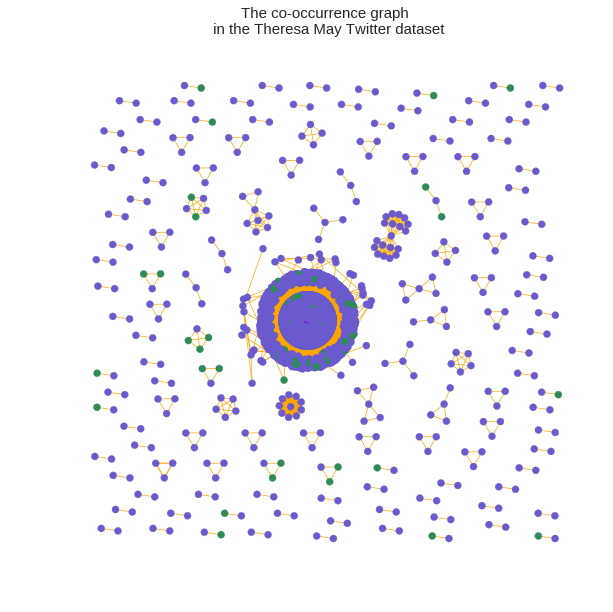

In [32]:
# weight={(x,y):v for (x, y), v in Counter(G.edges()).items()}
# w_edges=[(x,y,z) for (x,y),z in weight.items()]
# Gw = nx.Graph()
# Gw.add_weighted_edges_from(w_edges)
# edge_width=[Gw[u][v]['weight'] for u,v in Gw.edges()]
# edge_width=[math.log(1+w) for w in edge_width]

# figsize=(10,10)
# posGw=graphviz_layout(Gw)  #nx.spring_layout(HaGw,k=0.3) # #w) 
# pos=posGw
# # node_color="seagreen"  #"g" #"#ffb3b3"
# # node_border_color="r"
# node_color=[]
# for n in Gw.nodes():
#     if n in han:
#         node_color.append("seagreen")
#     elif n in twn:
#         node_color.append("slateblue")
#     else:
#         node_color.append("darkviolet")
# edge_color="orange" #"b" #"#668cff"

# plt.figure(figsize=figsize);
# nodes = nx.draw_networkx_nodes(Gw, pos, node_color=node_color,node_size=50)
# # nodes.set_edgecolor(node_border_color)
# nx.draw_networkx_edges(Gw, pos, edge_color=edge_color,width=edge_width)
# # nx.draw_networkx_edge_labels(G,pos,edge_labels=elabels);
# labels={}
# for n in Gw.nodes():
#     labels[n]=''
# nx.draw_networkx_labels(Gw, pos,labels=labels)
# plt.axis('off');
# # yoffset = {}
# # y_off = -10 #0.05  # offset on the y axis
# # for k, v in pos.items():
# #     yoffset[k] = (v[0], v[1]+y_off)
# # nx.draw_networkx_labels(G, yoffset,font_size=10);
# sst="The co-occurrence graph \n in %s" %st1
# plt.title(sst,fontsize=15);
# plt.margins(x=0.1, y=0.1) 

Image(filename = "Figs/4.png", width=600, height=600)

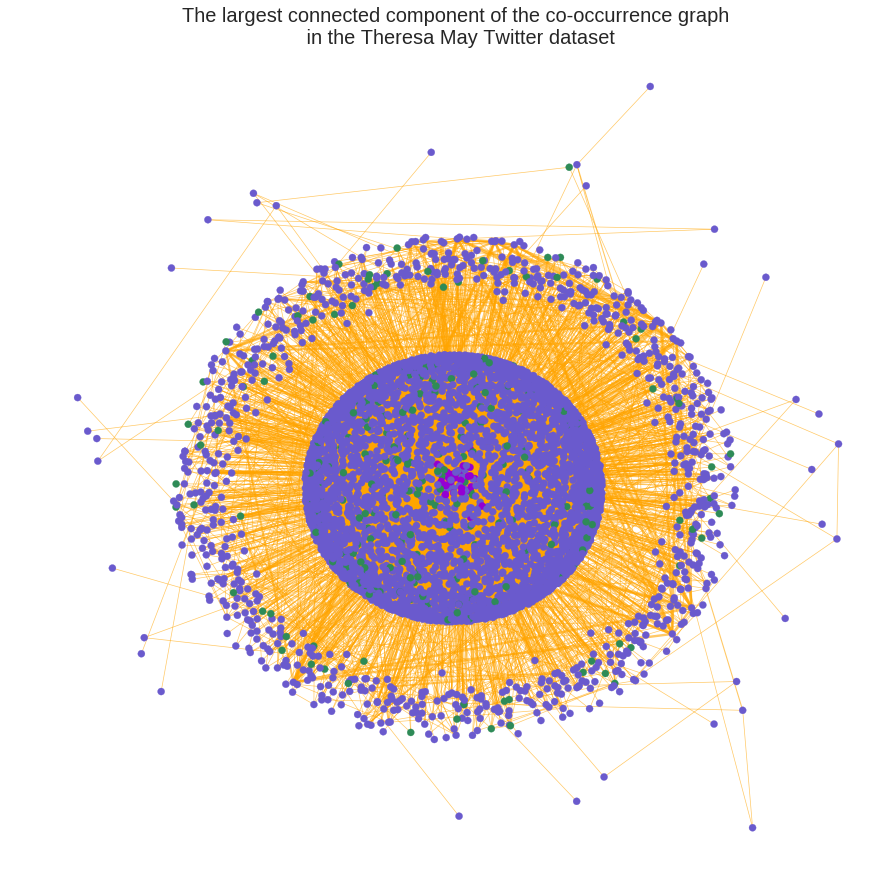

In [33]:
# weight={(x,y):v for (x, y), v in Counter(Gc.edges()).items()}
# w_edges=[(x,y,z) for (x,y),z in weight.items()]
# Gcw = nx.Graph()
# Gcw.add_weighted_edges_from(w_edges)
# edge_width=[Gcw[u][v]['weight'] for u,v in Gcw.edges()]
# edge_width=[math.log(1+w) for w in edge_width]

# posGc=graphviz_layout(Gcw)  #nx.spring_layout(HaGcw,k=0.4) #0.7) #
# pos=posGc
# plt.figure(figsize=(15,15));
# node_color=[]
# for n in Gcw.nodes():
#     if n in hanc:
#         node_color.append("seagreen")
#     elif n in twnc:
#         node_color.append("slateblue")
#     else:
#         node_color.append("darkviolet")
# # node_shape=[]
# # for n in Gcw.nodes():
# #     if n in hanc:
# #         node_shape.append("O")
# #     elif n in twnc:
# #         node_shape.append("D")
# #     else:
# #         node_shape.append("*")
# nodes = nx.draw_networkx_nodes(Gcw, pos,node_size=50, node_color=node_color) #,node_shape=node_shape); #, alpha=0.3) #"g"
# nx.draw_networkx_edges(Gcw, pos,arrowsize=20, edge_color="orange",width=edge_width, alpha=0.6) #"b"
# labels={}
# for n in Gcw.nodes():
#     labels[n]=''
# nx.draw_networkx_labels(Gcw, pos,labels=labels,font_size=10)
# plt.axis('off');
# sst="The largest connected component of the co-occurrence graph \n in %s" %st1
# plt.title(sst,fontsize=20);

Image(filename = "Figs/5.png", width=600, height=600)

### 3. Communities of the Co-Occurrence Graph

The co-occurrence graph has 184 communities and modularity coefficient equal to 0.5178



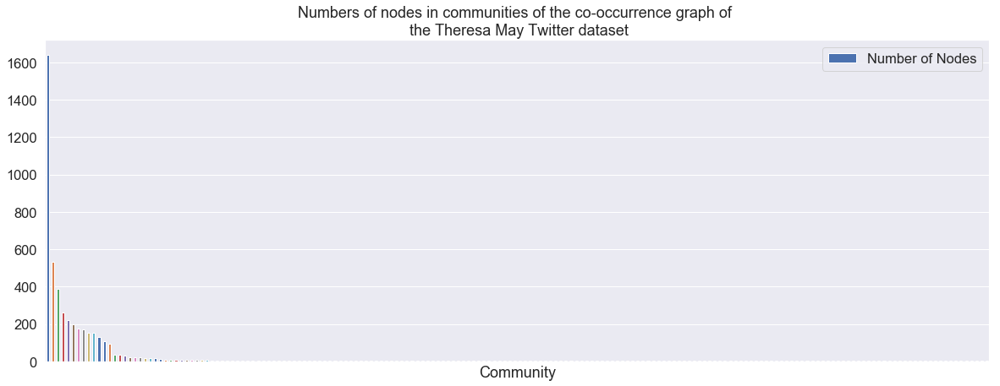

In [34]:
weight={(x,y):v for (x, y), v in Counter(G.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
Gw = nx.Graph()
Gw.add_weighted_edges_from(w_edges)
edge_width=[Gw[u][v]['weight'] for u,v in Gw.edges()]

partition = community.best_partition(Gw)
# print partition

kk=len(set(partition.values()))
modularity=community.modularity(partition, Gw, weight='weight')
print 'The co-occurrence graph has %i communities and modularity coefficient equal to %.4f' %(kk,modularity)
print

cml=[]
for j in range(kk):
    cj=[]
    for k,v in partition.items():
        if v==j:
            cj.append(k)
    cml.append(cj)
cmd={}
for j in range(kk):
    cmd[tuple(cml[j])]=len(cml[j])
cmd
ocmd=sorted(cmd.iteritems(), key=operator.itemgetter(1), reverse=True)
eocmd=enumerate(ocmd)
commsd={}
comm_membership={}
for i in eocmd:
#     print 'Community', i[0], 'with', i[1][1], 'nodes:'
#     print [x for x in i[1][0]]
    commsd[i[0]]=i[1][1] 
    ts=[x for x in i[1][0]]
    comm_membership[i[0]]=ts 
#     print
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(20,7),rot=0);
plt.xticks([], []);
sst="Numbers of nodes in communities of the co-occurrence graph of \n %s" %st1
plt.title(sst);

The largest connected component of the co-occurrence graph has 60 communities and modularity coefficient equal to 0.5158



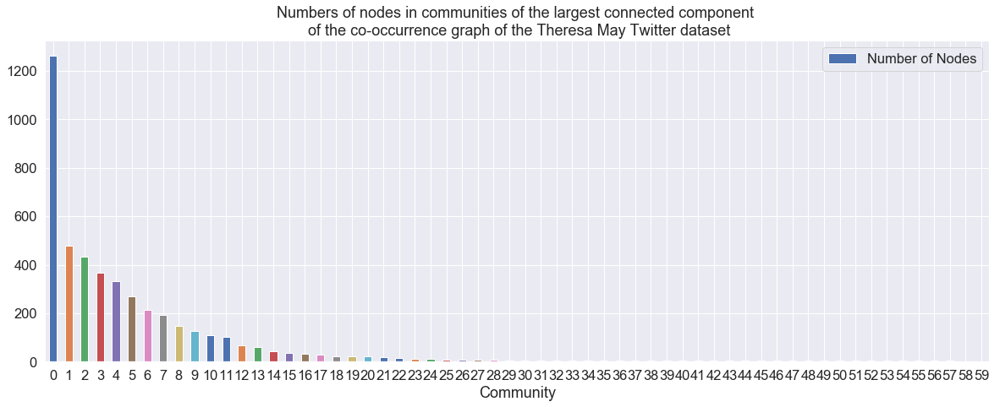

In [35]:
weight={(x,y):v for (x, y), v in Counter(Gc.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
Gcw = nx.Graph()
Gcw.add_weighted_edges_from(w_edges)
edge_width=[Gcw[u][v]['weight'] for u,v in Gcw.edges()]

partition = community.best_partition(Gcw)
# print partition

kk=len(set(partition.values()))
modularity=community.modularity(partition, Gcw, weight='weight')
print 'The largest connected component of the co-occurrence graph has %i communities and modularity coefficient equal to %.4f' %(kk,modularity)
print

cml=[]
for j in range(kk):
    cj=[]
    for k,v in partition.items():
        if v==j:
            cj.append(k)
    cml.append(cj)
cmd={}
for j in range(kk):
    cmd[tuple(cml[j])]=len(cml[j])
cmd
ocmd=sorted(cmd.iteritems(), key=operator.itemgetter(1), reverse=True)
eocmd=enumerate(ocmd)
commsd={}
lcc_comm_membership={}
for i in eocmd:
#     print 'Community', i[0], 'with', i[1][1], 'nodes:'
#     print [x for x in i[1][0]]
    commsd[i[0]]=i[1][1] 
    ts=[x for x in i[1][0]]
    lcc_comm_membership[i[0]]=ts 
#     print
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(20,7),rot=0);
# plt.xticks([], []);
sst="Numbers of nodes in communities of the largest connected component \n of the co-occurrence graph of %s" %st1
plt.title(sst);

In [36]:
ha_comm_membership={}
tw_comm_membership={}
te_comm_membership={}
for k,v in comm_membership.items():
    vv=set(v).intersection(set(hashtags))
    ha_comm_membership[k]=[w for w in vv]
    vv=set(v).intersection(set(tweeple))
    tw_comm_membership[k]=[w for w in vv]
    vv=set(v).intersection(set(terms))
    te_comm_membership[k]=[w for w in vv]

c1=0
c2=0
c3=0
for k,v in ha_comm_membership.items():
    c1+=len(v)
for k,v in tw_comm_membership.items():
    c2+=len(v)
for k,v in te_comm_membership.items():
    c3+=len(v)
print c1,len(han)
print c2,len(twn)
print c3,len(ten)
print len(G)

285 285
4606 4606
30 30
4921


### 4. The Layer of Hashtags

In [37]:
HaG=G.subgraph(han)
print "The hashtags layer has %i nodes and %i edges" %(len(HaG.nodes()),len(HaG.edges()))
if nx.is_connected(HaG)==True:
    print "This multigraph is connected"
else:
    print "This multigraph is not connected and has", nx.number_connected_components(HaG), "connected components"
HaGl = sorted((HaG.subgraph(c).copy() for c in nx.connected_components(HaG)), key = len, reverse=True)
HaGc=HaG.subgraph(HaGl[0])
print 'The largest connected component has:'
print "%i nodes and %i edges" %(len(HaGc.nodes()), len(HaGc.edges()))

The hashtags layer has 285 nodes and 408 edges
This multigraph is not connected and has 118 connected components
The largest connected component has:
132 nodes and 351 edges


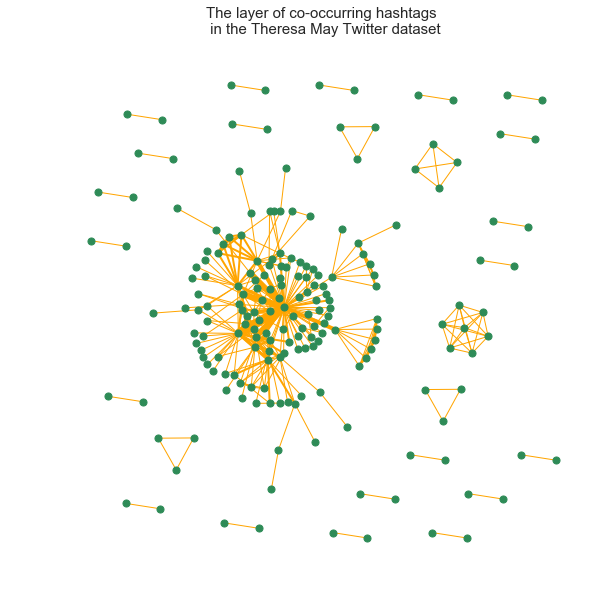

In [38]:
weight={(x,y):v for (x, y), v in Counter(HaG.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
HaGw = nx.Graph()
HaGw.add_weighted_edges_from(w_edges)
edge_width=[HaGw[u][v]['weight'] for u,v in HaGw.edges()]

figsize=(10,10)
posHa=graphviz_layout(HaGw)  #nx.spring_layout(HaGw,k=0.3) # #w) 
pos=posHa
node_color="seagreen"  #"g" #"#ffb3b3"
# node_border_color="r"
edge_color="orange" #"b" #"#668cff"

plt.figure(figsize=figsize);
nodes = nx.draw_networkx_nodes(HaGw, pos, node_color=node_color,node_size=50)
# nodes.set_edgecolor(node_border_color)
nx.draw_networkx_edges(HaGw, pos, edge_color=edge_color,width=edge_width)
# nx.draw_networkx_edge_labels(G,pos,edge_labels=elabels);
labels={}
for n in HaGw.nodes():
    labels[n]=''
nx.draw_networkx_labels(HaGw, pos,labels=labels)
plt.axis('off');
# yoffset = {}
# y_off = -10 #0.05  # offset on the y axis
# for k, v in pos.items():
#     yoffset[k] = (v[0], v[1]+y_off)
# nx.draw_networkx_labels(G, yoffset,font_size=10);
sst="The layer of co-occurring hashtags \n in %s" %st1
plt.title(sst,fontsize=15);
plt.margins(x=0.1, y=0.1) 

In [39]:
x={}
for n in HaGw.nodes():
    x[n]=HaGw.degree(n)
print max(x.values())
xx={i:j for i,j in x.items() if j>10}
sorted_xx = sorted(xx.items(), key=operator.itemgetter(1),reverse=True)
sorted_xx

67


[(u'#brexit', 67),
 (u'#revokearticle50', 29),
 (u'#theresamay', 18),
 (u'#notonmyside', 16),
 (u'#stopbrexit', 14),
 (u'#eu', 14),
 (u'#peoplesvote', 14),
 (u'#fbpe', 13),
 (u'#maymustgo', 13)]

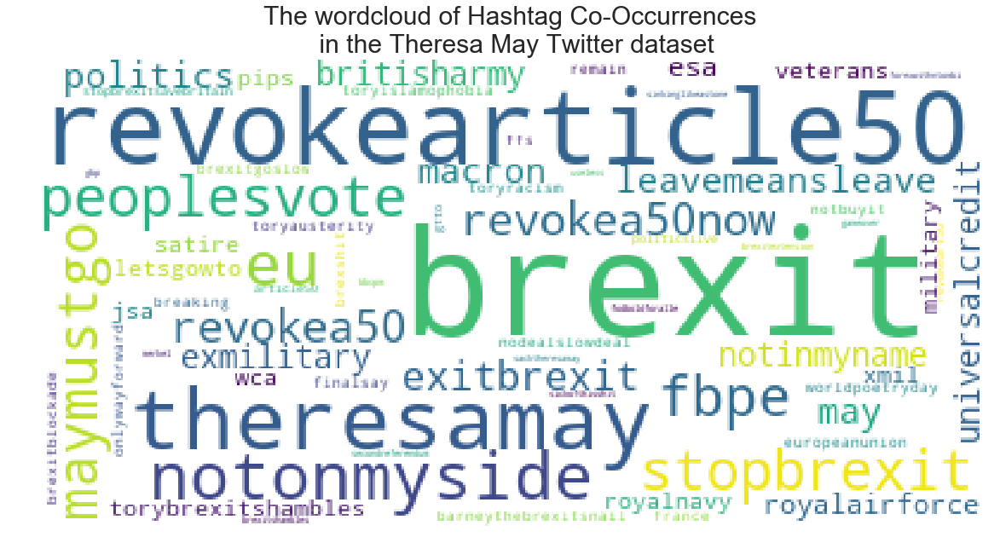

In [40]:
# t=[]
# for (i,j) in x.items():
#     for k in range(j):
#         t.append(i)
# tt=' '.join(t)
# wordcloud = WordCloud(collocations=False,background_color="white").generate(tt) #,width=200, height=200
# fig = plt.figure(figsize=(20,20))
# plt.imshow(wordcloud);
# sst="The wordcloud of Hashtag Co-Occurrences \n in %s" %st1
# plt.title(sst,fontsize=30)
# plt.axis("off");

Image(filename = "Figs/6.png", width=600, height=600)

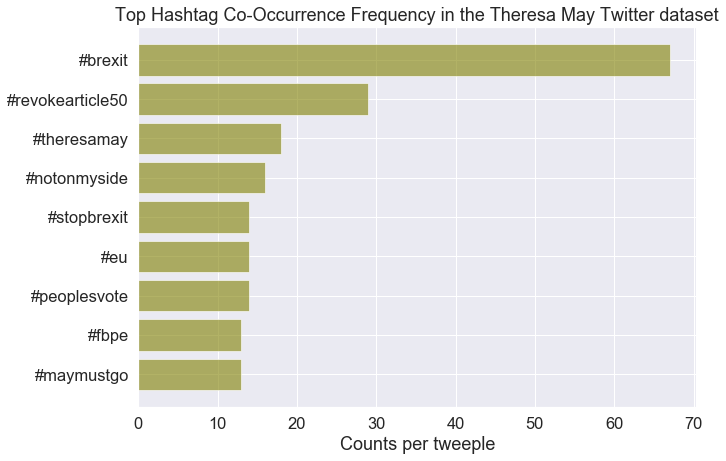

In [41]:
xx={i:j for i,j in x.items() if j>10}
sorted_xx = sorted(xx.items(), key=operator.itemgetter(1),reverse=True)
sorted_xx
keys=[i[0] for i in sorted_xx]
y_pos = np.arange(len(keys))
performance=[i[1] for i in sorted_xx]
plt.figure(figsize=(10,7))
ax = plt.axes()
plt.barh(y_pos, performance, align='center', color="olive",alpha=0.6) #xerr=error, 
ax.invert_yaxis()
plt.yticks(y_pos, keys)
plt.xlabel('Counts per tweeple')
sst='Top Hashtag Co-Occurrence Frequency in %s' %st1
plt.title(sst)
plt.show()

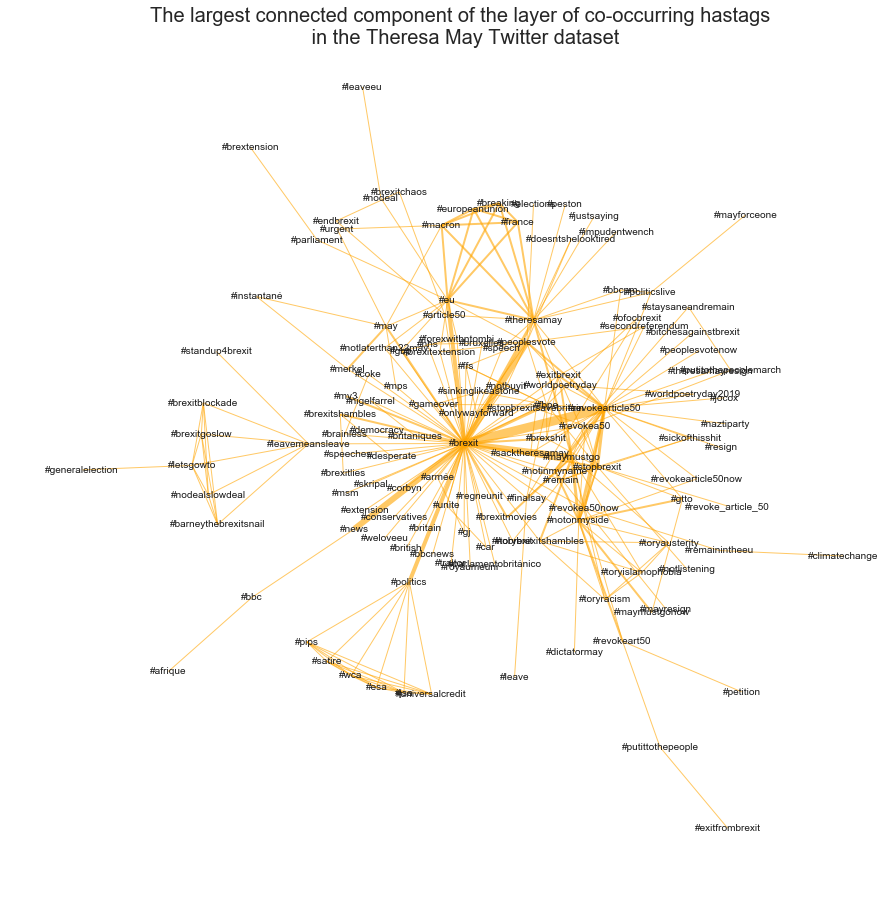

In [42]:
weight={(x,y):v for (x, y), v in Counter(HaGc.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
HaGcw = nx.Graph()
HaGcw.add_weighted_edges_from(w_edges)
edge_width=[HaGcw[u][v]['weight'] for u,v in HaGcw.edges()]

posHac=graphviz_layout(HaGcw)  #nx.spring_layout(HaGcw,k=0.4) #0.7) #
pos=posHac
plt.figure(figsize=(15,15));
nodes = nx.draw_networkx_nodes(HaGcw, pos,node_size=0, node_color="seagreen", alpha=0.3) #"g"
nx.draw_networkx_edges(HaGcw, pos,arrowsize=20, edge_color="orange",width=edge_width, alpha=0.6) #"b"
nx.draw_networkx_labels(HaGcw, pos,font_size=10)
plt.axis('off');
sst="The largest connected component of the layer of co-occurring hastags \n in %s" %st1
plt.title(sst,fontsize=20);

### 5. Communities of the Layer of Hashtags

The hashtags co-occurrence layer has 34 communities and modularity coefficient equal to 0.5961



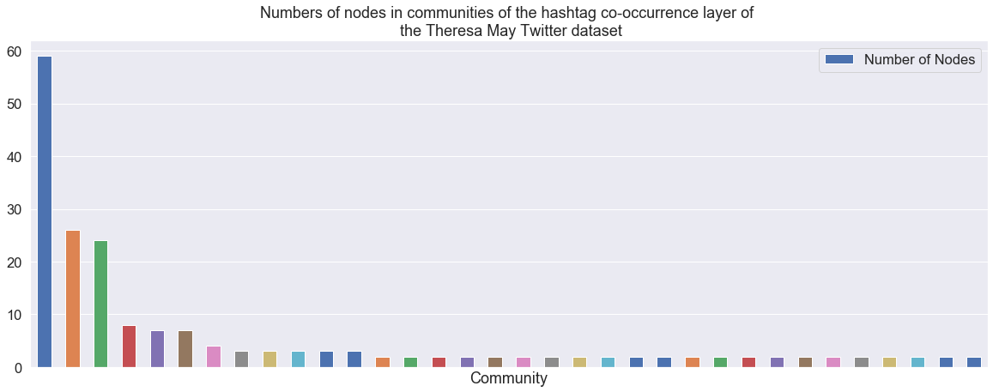

In [43]:
partition = community.best_partition(HaGw)
# print partition

kk=len(set(partition.values()))
modularity=community.modularity(partition, HaGw, weight='weight')
print 'The hashtags co-occurrence layer has %i communities and modularity coefficient equal to %.4f' %(kk,modularity)
print

cml=[]
for j in range(kk):
    cj=[]
    for k,v in partition.items():
        if v==j:
            cj.append(k)
    cml.append(cj)
cmd={}
for j in range(kk):
    cmd[tuple(cml[j])]=len(cml[j])
cmd
ocmd=sorted(cmd.iteritems(), key=operator.itemgetter(1), reverse=True)
eocmd=enumerate(ocmd)
commsd={}
ha_comm_membership={}
for i in eocmd:
#     print 'Community', i[0], 'with', i[1][1], 'nodes:'
#     print [x for x in i[1][0]]
    commsd[i[0]]=i[1][1] 
    ts=[x for x in i[1][0]]
    ha_comm_membership[i[0]]=ts 
#     print
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(20,7),rot=0);
plt.xticks([], []);
sst="Numbers of nodes in communities of the hashtag co-occurrence layer of \n %s" %st1
plt.title(sst);

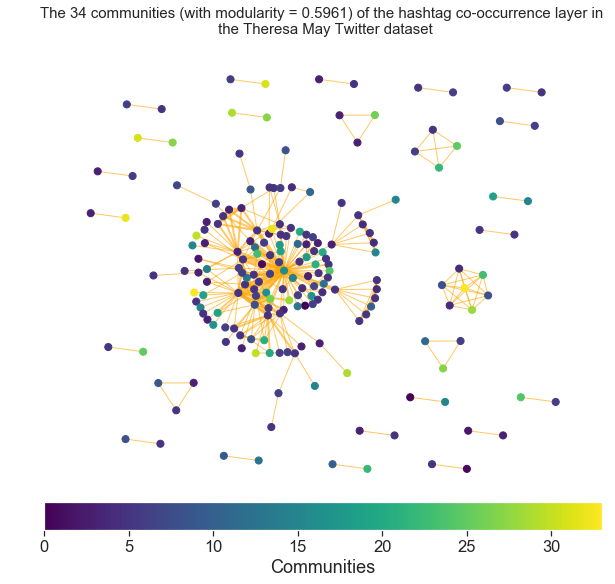

In [44]:
weight={(x,y):v for (x, y), v in Counter(HaG.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
HaGw = nx.Graph()
HaGw.add_weighted_edges_from(w_edges)
edge_width=[HaGw[u][v]['weight'] for u,v in HaGw.edges()]

node_color=partition.values()
vmin = min(node_color) #df['color'].min()
vmax = max(node_color) #df['color'].max()
cmap=plt.cm.viridis #plt.cm.coolwarm #plt.cm.Blues #
pos=posHa
# pos=graphviz_layout(HaGw)  #nx.spring_layout(HaGw,k=0.3)
plt.figure(figsize=(10,10));
# node_border_color='k'
nodes = nx.draw_networkx_nodes(HaGw, pos, node_color=node_color,node_size=50, cmap=cmap, vmin=vmin, vmax=vmax)
# nodes.set_edgecolor(node_border_color)
nx.draw_networkx_edges(HaGw, pos,edge_color='orange',width=edge_width,alpha=0.6)
plt.axis('off');
yoffset = {}
y_off = -0.05 #0.05  # offset on the y axis
for k, v in pos.items():
    yoffset[k] = (v[0], v[1]+y_off)
# nx.draw_networkx_labels(HaGw, yoffset,font_size=12);
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar = plt.colorbar(sm,label="Communities", orientation='horizontal', pad=-0.01)
sst="The %i communities (with modularity = %.4f) of the hashtag co-occurrence layer in \n %s" %(kk,modularity,st1)
plt.title(sst,fontsize=15);
plt.margins(x=0.1, y=0.1) 

The largest connected component of the hashtags co-occurrence layer has 7 communities and modularity coefficient equal to 0.5264



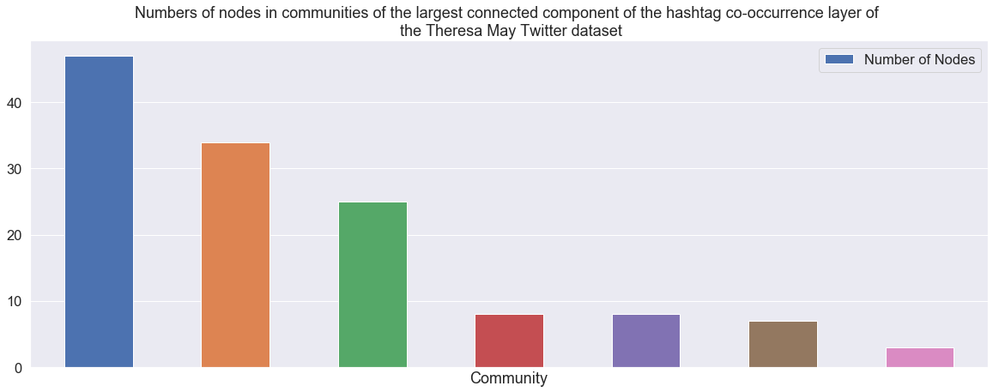

In [45]:
partition = community.best_partition(HaGcw)
# print partition

kk=len(set(partition.values()))
modularity=community.modularity(partition, HaGcw, weight='weight')
print 'The largest connected component of the hashtags co-occurrence layer has %i communities and modularity coefficient equal to %.4f' %(kk,modularity)
print

cml=[]
for j in range(kk):
    cj=[]
    for k,v in partition.items():
        if v==j:
            cj.append(k)
    cml.append(cj)
cmd={}
for j in range(kk):
    cmd[tuple(cml[j])]=len(cml[j])
cmd
ocmd=sorted(cmd.iteritems(), key=operator.itemgetter(1), reverse=True)
eocmd=enumerate(ocmd)
commsd={}
hac_comm_membership={}
for i in eocmd:
#     print 'Community', i[0], 'with', i[1][1], 'nodes:'
#     print [x for x in i[1][0]]
    commsd[i[0]]=i[1][1] 
    ts=[x for x in i[1][0]]
    hac_comm_membership[i[0]]=ts 
#     print
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(20,7),rot=0);
plt.xticks([], []);
sst="Numbers of nodes in communities of the largest connected component of the hashtag co-occurrence layer of \n %s" %st1
plt.title(sst);

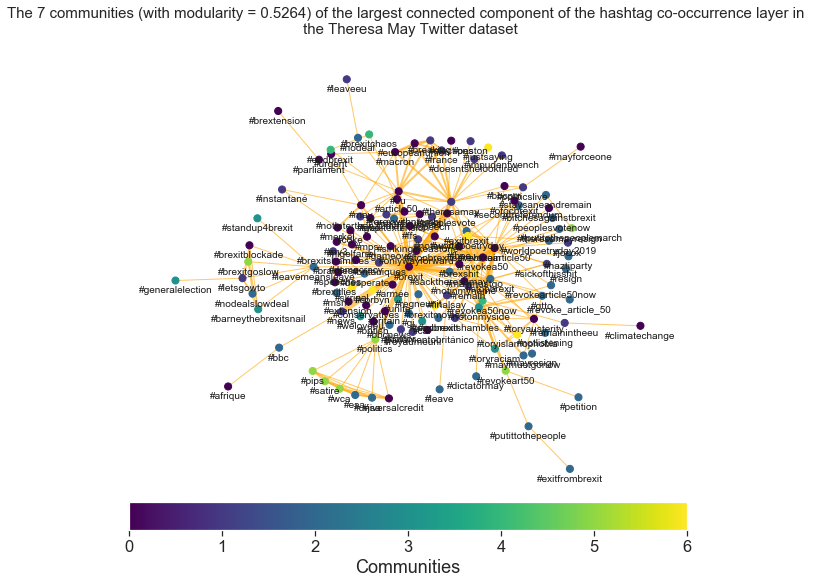

In [46]:
weight={(x,y):v for (x, y), v in Counter(HaGc.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
HaGcw = nx.Graph()
HaGcw.add_weighted_edges_from(w_edges)
edge_width=[HaGcw[u][v]['weight'] for u,v in HaGcw.edges()]

node_color=partition.values()
vmin = min(node_color) #df['color'].min()
vmax = max(node_color) #df['color'].max()
cmap=plt.cm.viridis #plt.cm.coolwarm #plt.cm.Blues #
pos=posHac
# pos=graphviz_layout(HaGw)  #nx.spring_layout(HaGw,k=0.3)
plt.figure(figsize=(10,10));
# node_border_color='k'
nodes = nx.draw_networkx_nodes(HaGcw, pos, node_color=node_color,node_size=50, cmap=cmap, vmin=vmin, vmax=vmax)
# nodes.set_edgecolor(node_border_color)
nx.draw_networkx_edges(HaGcw, pos,edge_color='orange',width=edge_width,alpha=0.6)
plt.axis('off');
yoffset = {}
y_off = -15 #0.05  # offset on the y axis
for k, v in pos.items():
    yoffset[k] = (v[0], v[1]+y_off)
nx.draw_networkx_labels(HaGcw, yoffset,font_size=10);
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar = plt.colorbar(sm,label="Communities", orientation='horizontal', pad=-0.01)
sst="The %i communities (with modularity = %.4f) of the largest connected component of the hashtag co-occurrence layer in \n %s" %(kk,modularity,st1)
plt.title(sst,fontsize=15);
plt.margins(x=0.1, y=0.1) 

### 6. The Layer of Tweeple

In [47]:
TwG=G.subgraph(twn)
print "The tweeple layer has %i nodes and %i edges" %(len(TwG.nodes()),len(TwG.edges()))
if nx.is_connected(TwG)==True:
    print "This multigraph is connected"
else:
    print "This multigraph is not connected and has", nx.number_connected_components(TwG), "connected components"
TwGl = sorted((TwG.subgraph(c).copy() for c in nx.connected_components(TwG)), key = len, reverse=True)
TwGc=TwG.subgraph(TwGl[0])
print 'The largest connected component has:'
print "%i nodes and %i edges" %(len(TwGc.nodes()), len(TwGc.edges()))

The tweeple layer has 4606 nodes and 20391 edges
This multigraph is not connected and has 677 connected components
The largest connected component has:
3658 nodes and 19845 edges


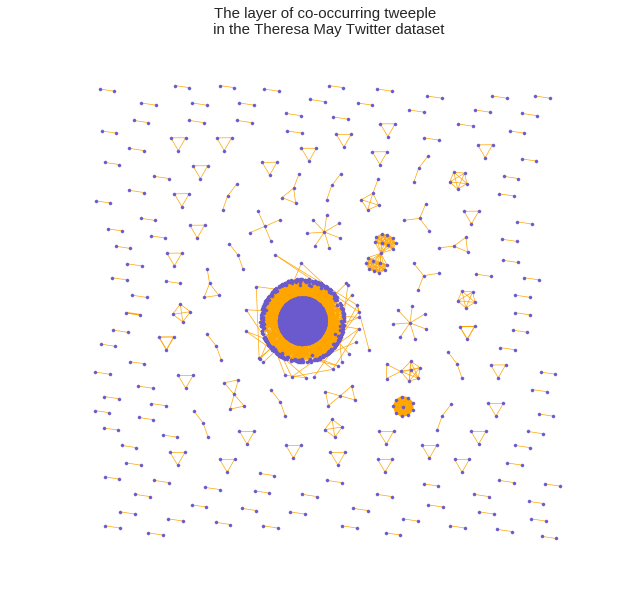

In [48]:
weight={(x,y):v for (x, y), v in Counter(TwG.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
TwGw = nx.Graph()
TwGw.add_weighted_edges_from(w_edges)
edge_width=[TwGw[u][v]['weight'] for u,v in TwGw.edges()]
edge_width=[math.log(1+w) for w in edge_width]

# figsize=(10,10)
posTw=graphviz_layout(TwGw)  #nx.spring_layout(HaGw,k=0.3) # #w) 
# pos=posTw
# node_color="slateblue"  #"g" #"#ffb3b3"
# # node_border_color="r"
# edge_color="orange" #"b" #"#668cff"

# plt.figure(figsize=figsize);
# nodes = nx.draw_networkx_nodes(TwGw, pos, node_color=node_color,node_size=10)
# # nodes.set_edgecolor(node_border_color)
# nx.draw_networkx_edges(TwGw, pos, edge_color=edge_color,width=edge_width)
# # nx.draw_networkx_edge_labels(G,pos,edge_labels=elabels);
# labels={}
# for n in TwGw.nodes():
#     labels[n]=''
# nx.draw_networkx_labels(TwGw, pos,labels=labels)
# plt.axis('off');
# # yoffset = {}
# # y_off = -10 #0.05  # offset on the y axis
# # for k, v in pos.items():
# #     yoffset[k] = (v[0], v[1]+y_off)
# # nx.draw_networkx_labels(G, yoffset,font_size=10);
# sst="The layer of co-occurring tweeple \n in %s" %st1
# plt.title(sst,fontsize=15);
# plt.margins(x=0.1, y=0.1)

Image(filename = "Figs/7.png", width=600, height=600)

In [49]:
x={}
for n in TwGw.nodes():
    x[n]=TwGw.degree(n)
print max(x.values())
xx={i:j for i,j in x.items() if j>50}
sorted_xx = sorted(xx.items(), key=operator.itemgetter(1),reverse=True)
sorted_xx

3293


[(u'@theresa_may', 3293),
 (u'@DavidLammy', 646),
 (u'@jeremycorbyn', 174),
 (u'@Conservatives', 169),
 (u'@RealDMitchell', 122),
 (u'@bbclaurak', 100),
 (u'@10DowningStreet', 100),
 (u'@doctor_oxford', 95),
 (u'@Anna_Soubry', 91),
 (u'@SkyNews', 86),
 (u'@pmdfoster', 86),
 (u'@peoplesvote_uk', 69),
 (u'@wesstreeting', 66),
 (u'@UKLabour', 64),
 (u'@Peston', 59),
 (u'@eucopresident', 52),
 (u'@BBCNews', 52),
 (u'@Nigel_Farage', 51)]

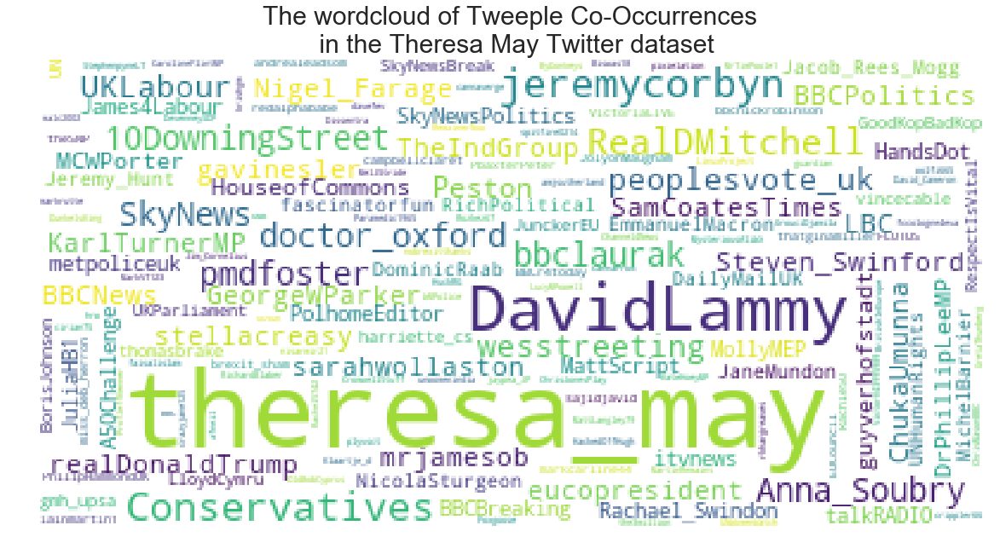

In [50]:
# t=[]
# for (i,j) in x.items():
#     for k in range(j):
#         t.append(i)
# tt=' '.join(t)
# wordcloud = WordCloud(collocations=False,background_color="white").generate(tt) #,width=200, height=200
# fig = plt.figure(figsize=(20,20))
# plt.imshow(wordcloud);
# sst="The wordcloud of Tweeple Co-Occurrences \n in %s" %st1
# plt.title(sst,fontsize=30)
# plt.axis("off");

Image(filename = "Figs/8.png", width=600, height=600)

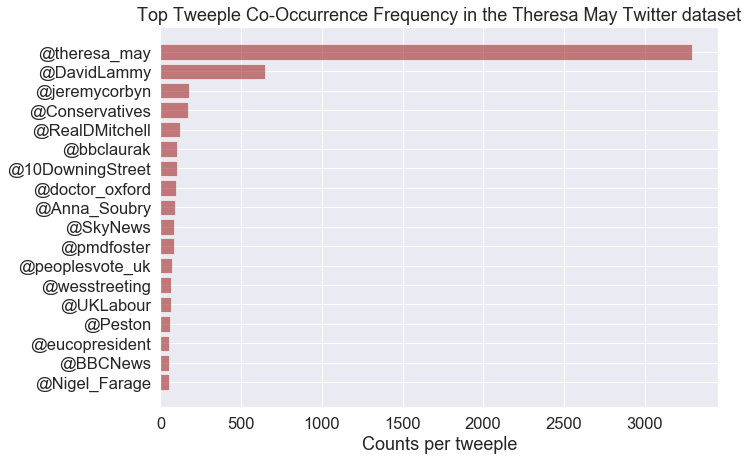

In [51]:
xx={i:j for i,j in x.items() if j>50}
sorted_xx = sorted(xx.items(), key=operator.itemgetter(1),reverse=True)
sorted_xx
keys=[i[0] for i in sorted_xx]
y_pos = np.arange(len(keys))
performance=[i[1] for i in sorted_xx]
plt.figure(figsize=(10,7))
ax = plt.axes()
plt.barh(y_pos, performance, align='center', color="brown",alpha=0.6) #xerr=error, 
ax.invert_yaxis()
plt.yticks(y_pos, keys)
plt.xlabel('Counts per tweeple')
sst='Top Tweeple Co-Occurrence Frequency in %s' %st1
plt.title(sst)
plt.show()

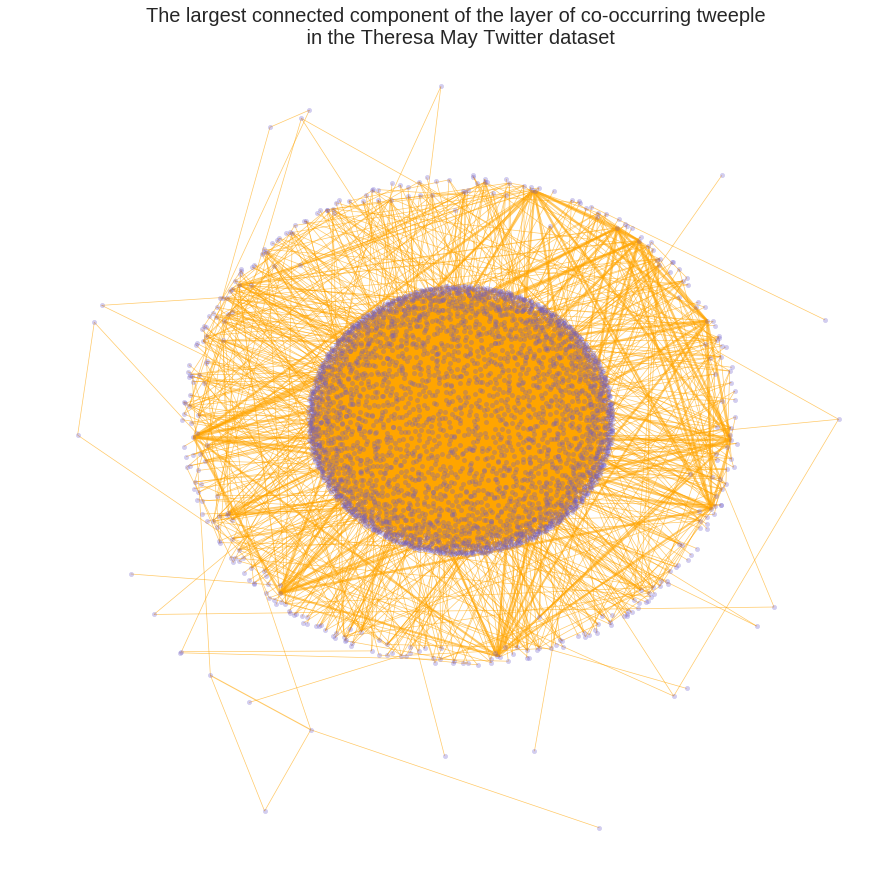

In [52]:
weight={(x,y):v for (x, y), v in Counter(TwGc.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
TwGcw = nx.Graph()
TwGcw.add_weighted_edges_from(w_edges)
edge_width=[TwGcw[u][v]['weight'] for u,v in TwGcw.edges()]
edge_width=[math.log(1+w) for w in edge_width]

posTwc=graphviz_layout(TwGcw)  #nx.spring_layout(HaGcw,k=0.4) #0.7) #
# pos=posTwc
# plt.figure(figsize=(15,15));
# nodes = nx.draw_networkx_nodes(TwGcw, pos,node_size=20, node_color="slateblue", alpha=0.3) #"g"
# nx.draw_networkx_edges(TwGcw, pos,arrowsize=20, edge_color="orange",width=edge_width, alpha=0.6) #"b"
# # nx.draw_networkx_labels(TwGcw, pos,font_size=10)
# plt.axis('off');
# sst="The largest connected component of the layer of co-occurring tweeple \n in %s" %st1
# plt.title(sst,fontsize=20);

Image(filename = "Figs/9.png", width=600, height=600)

### 7. Communities of the Layer of Tweeple

The tweeple co-occurrence layer has 252 communities and modularity coefficient equal to 0.5571



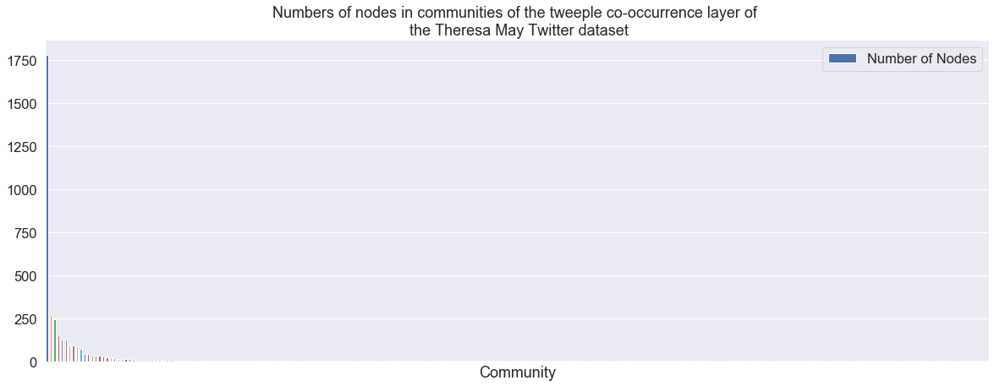

In [53]:
partition = community.best_partition(TwGw)
# print partition

kk=len(set(partition.values()))
modularity=community.modularity(partition, TwGw, weight='weight')
print 'The tweeple co-occurrence layer has %i communities and modularity coefficient equal to %.4f' %(kk,modularity)
print

cml=[]
for j in range(kk):
    cj=[]
    for k,v in partition.items():
        if v==j:
            cj.append(k)
    cml.append(cj)
cmd={}
for j in range(kk):
    cmd[tuple(cml[j])]=len(cml[j])
cmd
ocmd=sorted(cmd.iteritems(), key=operator.itemgetter(1), reverse=True)
eocmd=enumerate(ocmd)
commsd={}
tw_comm_membership={}
for i in eocmd:
#     print 'Community', i[0], 'with', i[1][1], 'nodes:'
#     print [x for x in i[1][0]]
    commsd[i[0]]=i[1][1] 
    ts=[x for x in i[1][0]]
    tw_comm_membership[i[0]]=ts 
#     print
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(20,7),rot=0);
plt.xticks([], []);
sst="Numbers of nodes in communities of the tweeple co-occurrence layer of \n %s" %st1
plt.title(sst);

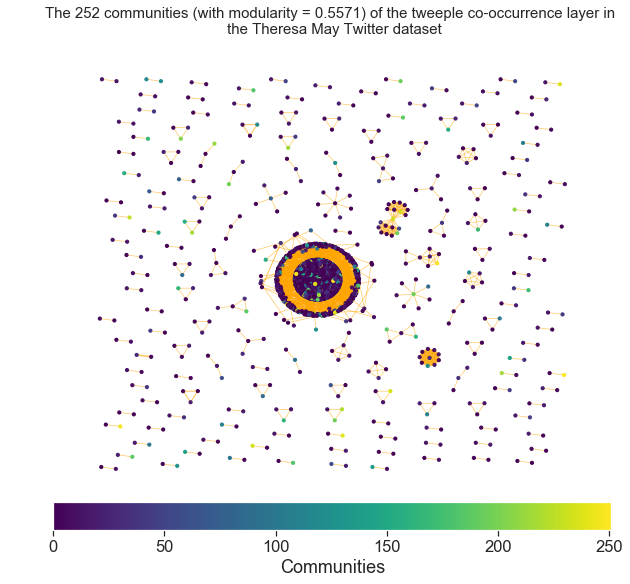

In [54]:
kk=len(set(partition.values()))

weight={(x,y):v for (x, y), v in Counter(TwG.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
TwGw = nx.Graph()
TwGw.add_weighted_edges_from(w_edges)
edge_width=[TwGw[u][v]['weight'] for u,v in TwGw.edges()]
edge_width=[math.log(1+w) for w in edge_width]

node_color=partition.values()
vmin = min(node_color) #df['color'].min()
vmax = max(node_color) #df['color'].max()
cmap=plt.cm.viridis #plt.cm.coolwarm #plt.cm.Blues #
pos=posTw
# pos=graphviz_layout(HaGw)  #nx.spring_layout(HaGw,k=0.3)
plt.figure(figsize=(10,10));
# node_border_color='k'
nodes = nx.draw_networkx_nodes(TwGw, pos, node_color=node_color,node_size=10, cmap=cmap, vmin=vmin, vmax=vmax)
# nodes.set_edgecolor(node_border_color)
nx.draw_networkx_edges(TwGw, pos,edge_color='orange',width=edge_width,alpha=0.6)
plt.axis('off');
yoffset = {}
y_off = -0.05 #0.05  # offset on the y axis
for k, v in pos.items():
    yoffset[k] = (v[0], v[1]+y_off)
# nx.draw_networkx_labels(HaGw, yoffset,font_size=12);
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar = plt.colorbar(sm,label="Communities", orientation='horizontal', pad=-0.01)
sst="The %i communities (with modularity = %.4f) of the tweeple co-occurrence layer in \n %s" %(kk,modularity,st1)
plt.title(sst,fontsize=15);
plt.margins(x=0.1, y=0.1) 

# Image(filename = "Figs/10.png", width=600, height=600)

The largest connected component of the tweeple co-occurrence layer has 81 communities and modularity coefficient equal to 0.5461



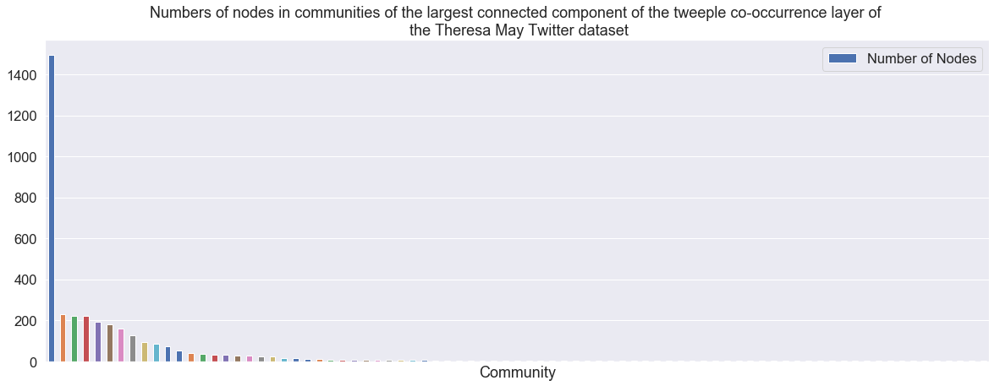

In [55]:
partition = community.best_partition(TwGcw)
# print partition

kk=len(set(partition.values()))
modularity=community.modularity(partition, TwGcw, weight='weight')
print 'The largest connected component of the tweeple co-occurrence layer has %i communities and modularity coefficient equal to %.4f' %(kk,modularity)
print

cml=[]
for j in range(kk):
    cj=[]
    for k,v in partition.items():
        if v==j:
            cj.append(k)
    cml.append(cj)
cmd={}
for j in range(kk):
    cmd[tuple(cml[j])]=len(cml[j])
cmd
ocmd=sorted(cmd.iteritems(), key=operator.itemgetter(1), reverse=True)
eocmd=enumerate(ocmd)
commsd={}
twc_comm_membership={}
for i in eocmd:
#     print 'Community', i[0], 'with', i[1][1], 'nodes:'
#     print [x for x in i[1][0]]
    commsd[i[0]]=i[1][1] 
    ts=[x for x in i[1][0]]
    twc_comm_membership[i[0]]=ts 
#     print
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(20,7),rot=0);
plt.xticks([], []);
sst="Numbers of nodes in communities of the largest connected component of the tweeple co-occurrence layer of \n %s" %st1
plt.title(sst);

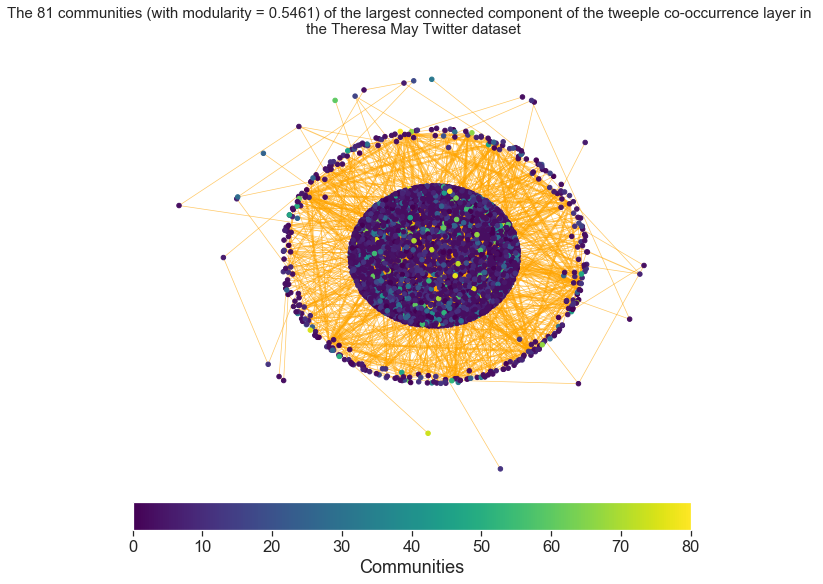

In [56]:
weight={(x,y):v for (x, y), v in Counter(TwGc.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
TwGcw = nx.Graph()
TwGcw.add_weighted_edges_from(w_edges)
edge_width=[TwGcw[u][v]['weight'] for u,v in TwGcw.edges()]
edge_width=[math.log(1+w) for w in edge_width]

node_color=partition.values()
vmin = min(node_color) #df['color'].min()
vmax = max(node_color) #df['color'].max()
cmap=plt.cm.viridis #plt.cm.coolwarm #plt.cm.Blues #
pos=posTwc
# pos=graphviz_layout(HaGw)  #nx.spring_layout(HaGw,k=0.3)
plt.figure(figsize=(10,10));
# node_border_color='k'
nodes = nx.draw_networkx_nodes(TwGcw, pos, node_color=node_color,node_size=20, cmap=cmap, vmin=vmin, vmax=vmax)
# nodes.set_edgecolor(node_border_color)
nx.draw_networkx_edges(TwGcw, pos,edge_color='orange',width=edge_width,alpha=0.6)
plt.axis('off');
yoffset = {}
y_off = -15 #0.05  # offset on the y axis
for k, v in pos.items():
    yoffset[k] = (v[0], v[1]+y_off)
# nx.draw_networkx_labels(HaGcw, yoffset,font_size=10);
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar = plt.colorbar(sm,label="Communities", orientation='horizontal', pad=-0.01)
sst="The %i communities (with modularity = %.4f) of the largest connected component of the tweeple co-occurrence layer in \n %s" %(kk,modularity,st1)
plt.title(sst,fontsize=15);
plt.margins(x=0.1, y=0.1) 

# Image(filename = "Figs/11.png", width=600, height=600)

### 8. The Layer of Topic Modeling Terms

In [57]:
ToG=G.subgraph(ten)
print "The topic modeling terms layer has %i nodes and %i edges" %(len(ToG.nodes()),len(ToG.edges()))
if nx.is_connected(ToG)==True:
    print "This multigraph is connected"
else:
    print "This multigraph is not connected and has", nx.number_connected_components(ToG), "connected components"
# ToGl = sorted((ToG.subgraph(c).copy() for c in nx.connected_components(ToG)), key = len, reverse=True)
# ToGc=ToG.subgraph(ToGl[0])
# print 'The largest connected component has:'
# print "%i nodes and %i edges" %(len(ToGc.nodes()), len(ToGc.edges()))

The topic modeling terms layer has 30 nodes and 1508 edges
This multigraph is connected


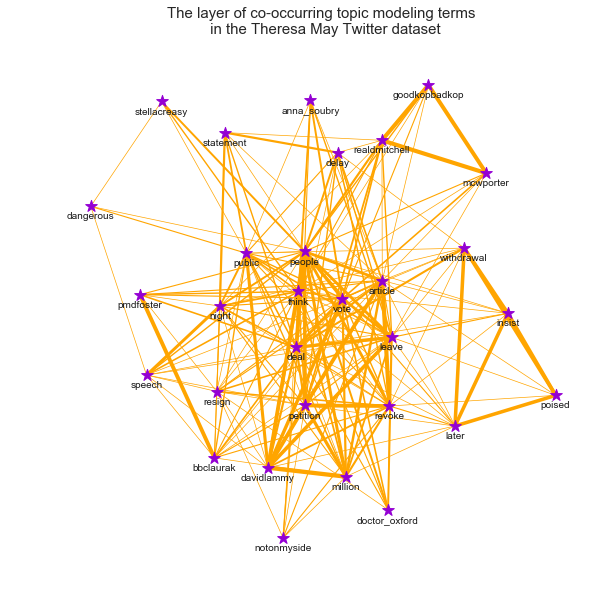

In [58]:
weight={(x,y):v for (x, y), v in Counter(ToG.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
ToGw = nx.Graph()
ToGw.add_weighted_edges_from(w_edges)
edge_width=[ToGw[u][v]['weight'] for u,v in ToGw.edges()]
edge_width=[math.log(1+w) for w in edge_width]

figsize=(10,10)
posTo=graphviz_layout(ToGw)  #nx.spring_layout(HaGw,k=0.3) # #w) 
pos=posTo
node_color="darkviolet"  #"g" #"#ffb3b3"
# node_border_color="r"
edge_color="orange" #"b" #"#668cff"

plt.figure(figsize=figsize);
nodes = nx.draw_networkx_nodes(ToGw, pos, node_color=node_color,node_size=150,node_shape="*")
# nodes.set_edgecolor(node_border_color)
nx.draw_networkx_edges(ToGw, pos, edge_color=edge_color,width=edge_width)
# nx.draw_networkx_edge_labels(G,pos,edge_labels=elabels);
labels={}
for n in ToGw.nodes():
    labels[n]=n  #''
# nx.draw_networkx_labels(ToGw, pos,labels=labels)
plt.axis('off');
yoffset = {}
y_off = -4 #0.05  # offset on the y axis
for k, v in pos.items():
    yoffset[k] = (v[0], v[1]+y_off)
nx.draw_networkx_labels(ToGw, yoffset,labels=labels,font_size=10);
sst="The layer of co-occurring topic modeling terms \n in %s" %st1
plt.title(sst,fontsize=15);
plt.margins(x=0.1, y=0.1) 

In [59]:
x={}
for n in ToGw.nodes():
    x[n]=ToGw.degree(n)
print max(x.values())
xx={i:j for i,j in x.items() if j>10}
sorted_xx = sorted(xx.items(), key=operator.itemgetter(1),reverse=True)
sorted_xx

26


[(u'people', 26),
 (u'article', 24),
 (u'think', 23),
 (u'leave', 23),
 (u'deal', 21),
 (u'vote', 21),
 (u'revoke', 20),
 (u'public', 20),
 (u'petition', 18),
 (u'night', 17),
 (u'resign', 16),
 (u'million', 14),
 (u'davidlammy', 14),
 (u'bbclaurak', 13),
 (u'later', 12),
 (u'realdmitchell', 11),
 (u'speech', 11),
 (u'withdrawal', 11)]

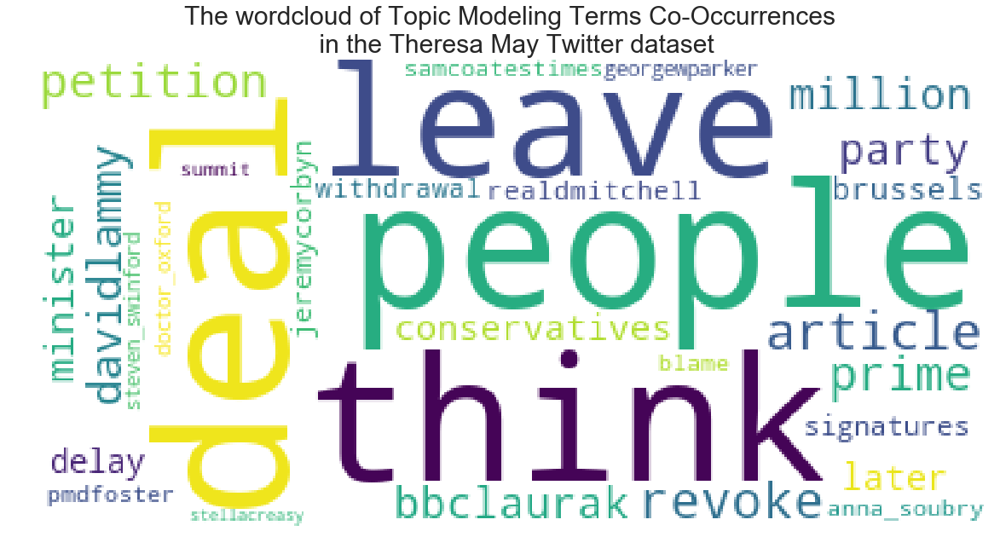

In [60]:
# t=[]
# for (i,j) in x.items():
#     for k in range(j):
#         t.append(i)
# tt=' '.join(t)
# wordcloud = WordCloud(collocations=False,background_color="white").generate(tt) #,width=200, height=200
# fig = plt.figure(figsize=(20,20))
# plt.imshow(wordcloud);
# sst="The wordcloud of Topic Modeling Terms Co-Occurrences \n in %s" %st1
# plt.title(sst,fontsize=30)
# plt.axis("off");

Image(filename = "Figs/12.png", width=600, height=600)

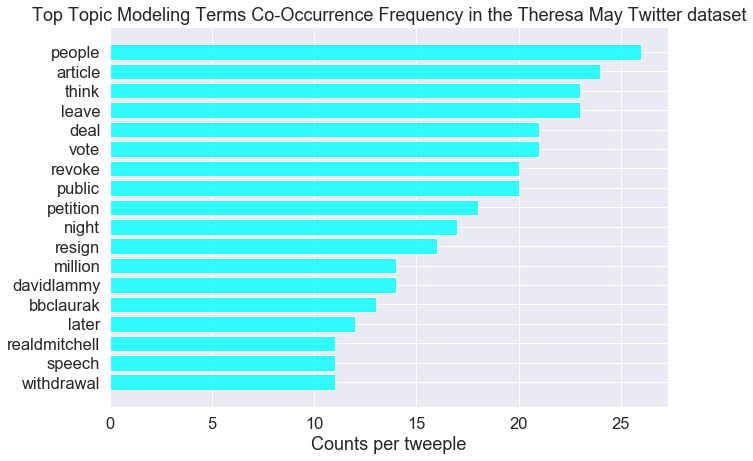

In [61]:
xx={i:j for i,j in x.items() if j>10}
sorted_xx = sorted(xx.items(), key=operator.itemgetter(1),reverse=True)
sorted_xx
keys=[i[0] for i in sorted_xx]
y_pos = np.arange(len(keys))
performance=[i[1] for i in sorted_xx]
plt.figure(figsize=(10,7))
ax = plt.axes()
plt.barh(y_pos, performance, align='center', color="cyan",alpha=0.8) #xerr=error, 
ax.invert_yaxis()
plt.yticks(y_pos, keys)
plt.xlabel('Counts per tweeple')
sst='Top Topic Modeling Terms Co-Occurrence Frequency in %s' %st1
plt.title(sst)
plt.show()

### 9. Communities of the Layer of Topic Modeling Terms

The co-occurrence layer of topic modeling terms has 6 communities and modularity coefficient equal to 0.4531



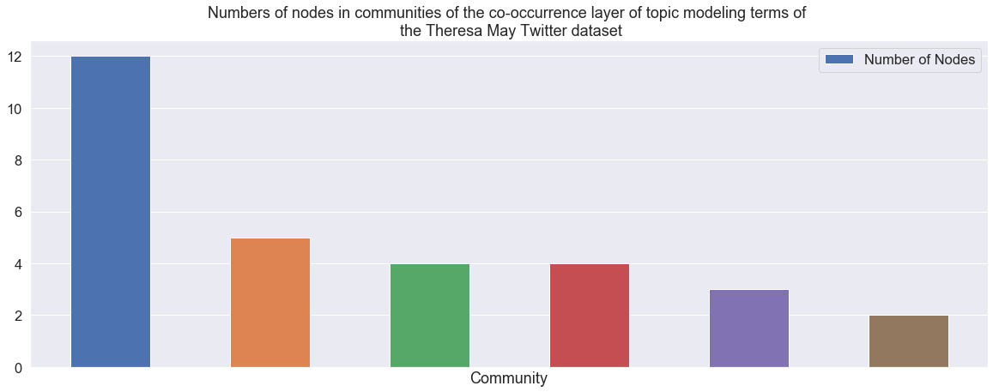

In [62]:
partition = community.best_partition(ToGw)
# print partition

kk=len(set(partition.values()))
modularity=community.modularity(partition, ToGw, weight='weight')
print 'The co-occurrence layer of topic modeling terms has %i communities and modularity coefficient equal to %.4f' %(kk,modularity)
print

cml=[]
for j in range(kk):
    cj=[]
    for k,v in partition.items():
        if v==j:
            cj.append(k)
    cml.append(cj)
cmd={}
for j in range(kk):
    cmd[tuple(cml[j])]=len(cml[j])
cmd
ocmd=sorted(cmd.iteritems(), key=operator.itemgetter(1), reverse=True)
eocmd=enumerate(ocmd)
commsd={}
te_comm_membership={}
for i in eocmd:
#     print 'Community', i[0], 'with', i[1][1], 'nodes:'
#     print [x for x in i[1][0]]
    commsd[i[0]]=i[1][1] 
    ts=[x for x in i[1][0]]
    te_comm_membership[i[0]]=ts 
#     print
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(20,7),rot=0);
plt.xticks([], []);
sst="Numbers of nodes in communities of the co-occurrence layer of topic modeling terms of \n %s" %st1
plt.title(sst);

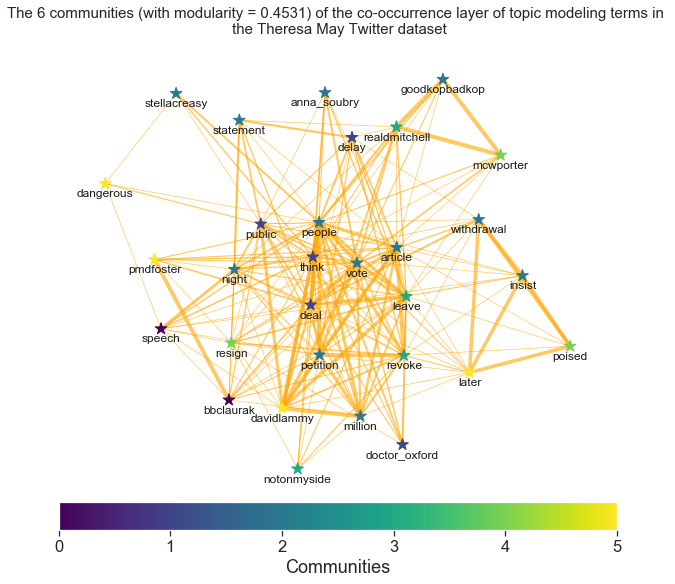

In [63]:
weight={(x,y):v for (x, y), v in Counter(ToG.edges()).items()}
w_edges=[(x,y,z) for (x,y),z in weight.items()]
ToGw = nx.Graph()
ToGw.add_weighted_edges_from(w_edges)
edge_width=[ToGw[u][v]['weight'] for u,v in ToGw.edges()]
edge_width=[math.log(1+w) for w in edge_width]

node_color=partition.values()
vmin = min(node_color) #df['color'].min()
vmax = max(node_color) #df['color'].max()
cmap=plt.cm.viridis #plt.cm.coolwarm #plt.cm.Blues #
pos=posTo
# pos=graphviz_layout(HaGw)  #nx.spring_layout(HaGw,k=0.3)
plt.figure(figsize=(10,10));
# node_border_color='k'
nodes = nx.draw_networkx_nodes(ToGw, pos, node_color=node_color,node_size=150,node_shape="*", cmap=cmap, vmin=vmin, vmax=vmax)
# nodes.set_edgecolor(node_border_color)
nx.draw_networkx_edges(ToGw, pos,edge_color='orange',width=edge_width,alpha=0.6)
plt.axis('off');
yoffset = {}
y_off = -5 #0.05  # offset on the y axis
for k, v in pos.items():
    yoffset[k] = (v[0], v[1]+y_off)
nx.draw_networkx_labels(ToGw, yoffset,font_size=12);
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
cbar = plt.colorbar(sm,label="Communities", orientation='horizontal', pad=-0.01)
sst="The %i communities (with modularity = %.4f) of the co-occurrence layer of topic modeling terms in \n %s" %(kk,modularity,st1)
plt.title(sst,fontsize=15);
plt.margins(x=0.1, y=0.1) 

### 10. Comparing Topics with Communities on the Layer of Topic Modeling Terms

In [64]:
def jacci(A,B):
    a=set(A).intersection(set(B))
    b=set(A).union(set(B))
    return len(a)/float(len(b))

def comp_m(dict1,dict2):
    tt=[]
    for k2,v2 in dict2.items():
        t=[]
        for k1,v1 in dict1.items():
            t.append(jacci(v1,v2))
        tt.append(t)
    return np.array(tt)

def comp_hm(dict1,dict2,prefix1,prefix2):
    t0=[]
    for k1 in dict1.keys():
        t0.append(prefix1+"_"+str(k1))
    tt=[]
    for k2,v2 in dict2.items():
        t=[]
        for k1,v1 in dict1.items():
            t.append(jacci(v1,v2))
        tt.append(t)
    hmdf=pd.DataFrame({"":t0})
    for j,k in enumerate(dict2.keys()):
#         if prefix2=="":
#             prfx=str(k)
#         else:
#             prfx=prefix2+"_"+str(k)
        prfx=prefix2+"_"+str(k)
        hmdf[prfx]=tt[j]
    return hmdf

In [65]:
n_topics_terms_d={}
for k,v in topics_terms_d.items():
    k=int(k.replace("Topic_",""))
    n_topics_terms_d[k]=v

In [66]:
dict1=te_comm_membership
prefix1="Community"
dict2=n_topics_terms_d
prefix2="Topic"  #""  
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,Topic_0,Topic_1,Topic_2,Topic_3,Topic_4,Topic_5
0,Community_0,0.117647,0.416667,0.200000,0.117647,0.125000,0.214286
1,Community_1,0.090909,0.000000,0.000000,0.090909,0.375000,0.000000
2,Community_2,0.000000,0.000000,0.428571,0.000000,0.111111,0.000000
3,Community_3,0.571429,0.000000,0.000000,0.000000,0.000000,0.000000
4,Community_4,0.000000,0.000000,0.000000,0.428571,0.000000,0.000000
5,Community_5,0.000000,0.000000,0.000000,0.000000,0.000000,0.400000


In [67]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities of Terms and Topics')

,,Topic_0,Topic_1,Topic_2,Topic_3,Topic_4,Topic_5
0,Community_0,0.117647,0.416667,0.2,0.117647,0.125,0.214286
1,Community_1,0.0909091,0,0,0.0909091,0.375,0
2,Community_2,0,0,0.428571,0,0.111111,0
3,Community_3,0.571429,0,0,0,0,0
4,Community_4,0,0,0,0.428571,0,0
5,Community_5,0,0,0,0,0,0.4


In [68]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 0.5714 for Community_3 and Topic_0


### 11. The Inter-Layer Multipartite Graph of All Co-Occurrences

In [69]:
icoocs=[]
for i in range(len(mt)):
    ind=mt.index.values[i]
    ha=mt.iloc[i]["hashtags_list"]
    tw=mt.iloc[i]["mention_tweeple"]
    te=mt.iloc[i]["tm_terms"]
    if len(ha)>0 and len(tw)>0:
        for k in ha:
            for l in tw:
                icoocs.append((k,l,ind))
    if len(ha)>0 and len(te)>0:
        for k in ha:
            for l in te:
                icoocs.append((k,l,ind))
    if len(te)>0 and len(tw)>0:
        for k in tw:
            for l in te:
                icoocs.append((k,l,ind))
print len(icoocs),len(set(icoocs))
for e in icoocs:
    print e

12424 12411
(u'@doctor_oxford', u'vote', 0)
(u'@theresa_may', u'vote', 0)
(u'@timchipping', u'think', 17816)
(u'@CheeksRossie', u'vote', 17813)
(u'@theresa_may', u'vote', 17813)
(u'@UKIP', u'vote', 17813)
(u'@MrTrip', u'realdmitchell', 17810)
(u'@MrTrip', u'vote', 17810)
(u'@RealDMitchell', u'realdmitchell', 17810)
(u'@RealDMitchell', u'vote', 17810)
(u'@theresa_may', u'realdmitchell', 17810)
(u'@theresa_may', u'vote', 17810)
(u'@scottboxley', u'davidlammy', 17807)
(u'@scottboxley', u'think', 17807)
(u'@DavidLammy', u'davidlammy', 17807)
(u'@DavidLammy', u'think', 17807)
(u'@theresa_may', u'davidlammy', 17807)
(u'@theresa_may', u'think', 17807)
(u'#brussels', u'@TrueNewsNG', 17796)
(u'@RatbiteJ', u'realdmitchell', 17800)
(u'@RealDMitchell', u'realdmitchell', 17800)
(u'@theresa_may', u'realdmitchell', 17800)
(u'@Rimbeux', u'bbclaurak', 17784)
(u'@Rimbeux', u'pmdfoster', 17784)
(u'@ianbeckett', u'bbclaurak', 17784)
(u'@ianbeckett', u'pmdfoster', 17784)
(u'@mattholehouse', u'bbclaurak', 1

(u'@ProfJeffKenner', u'bbclaurak', 16648)
(u'@ProfJeffKenner', u'pmdfoster', 16648)
(u'@theresa_may', u'bbclaurak', 16648)
(u'@theresa_may', u'pmdfoster', 16648)
(u'@bbclaurak', u'bbclaurak', 16648)
(u'@bbclaurak', u'pmdfoster', 16648)
(u'@SamCoatesTimes', u'bbclaurak', 16648)
(u'@SamCoatesTimes', u'pmdfoster', 16648)
(u'@Steven_Swinford', u'bbclaurak', 16648)
(u'@Steven_Swinford', u'pmdfoster', 16648)
(u'@whypad', u'people', 16630)
(u'@JohnbwMayes', u'people', 16630)
(u'@davidschneider', u'people', 16630)
(u'#aahhbisto', u'@BellaWalter_', 16621)
(u'@harriette_cs', u'vote', 16610)
(u'@sccpen', u'vote', 16610)
(u'@LloydCymru', u'vote', 16610)
(u'@RichPolitical', u'vote', 16610)
(u'@theresa_may', u'vote', 16610)
(u'#revokearticle50', u'@The_ChrisShaw', 16608)
(u'#revokearticle50', u'@theresa_may', 16608)
(u'#brexit', u'@The_ChrisShaw', 16608)
(u'#brexit', u'@theresa_may', 16608)
(u'#revokearticle50', u'speech', 16608)
(u'#brexit', u'speech', 16608)
(u'@The_ChrisShaw', u'speech', 16608)
(

(u'@NicolaRBartlett', u'vote', 15593)
(u'@theresa_may', u'leave', 15593)
(u'@theresa_may', u'vote', 15593)
(u'@numb15', u'think', 15582)
(u'@numb15', u'deal', 15582)
(u'@numb15', u'pmdfoster', 15582)
(u'@pmdfoster', u'think', 15582)
(u'@pmdfoster', u'deal', 15582)
(u'@pmdfoster', u'pmdfoster', 15582)
(u'@theresa_may', u'think', 15582)
(u'@theresa_may', u'deal', 15582)
(u'@theresa_may', u'pmdfoster', 15582)
(u'#revokea50', u'@RoaringNurse', 15579)
(u'#revokea50', u'@theresa_may', 15579)
(u'#stopbrexitsavebritain', u'@RoaringNurse', 15579)
(u'#stopbrexitsavebritain', u'@theresa_may', 15579)
(u'#revokea50', u'people', 15579)
(u'#stopbrexitsavebritain', u'people', 15579)
(u'@RoaringNurse', u'people', 15579)
(u'@theresa_may', u'people', 15579)
(u'@LinuxProject', u'petition', 15559)
(u'@theresa_may', u'petition', 15559)
(u'@Nervana_1', u'public', 15552)
(u'@SpadesRSpades', u'davidlammy', 15546)
(u'@CromwellStuff', u'davidlammy', 15546)
(u'@DavidLammy', u'davidlammy', 15546)
(u'@theresa_may',

(u'@DavidLammy', u'davidlammy', 14375)
(u'@theresa_may', u'davidlammy', 14375)
(u'@johanscouse', u'davidlammy', 14368)
(u'@DavidLammy', u'davidlammy', 14368)
(u'@theresa_may', u'davidlammy', 14368)
(u'@KiraDarknessTV', u'realdmitchell', 14365)
(u'@RealDMitchell', u'realdmitchell', 14365)
(u'@theresa_may', u'realdmitchell', 14365)
(u'#revokearticle50', u'@davidiwanow', 14362)
(u'#revokearticle50', u'@theresa_may', 14362)
(u'#revokearticle50', u'@GOVUK', 14362)
(u'@PhilipHunn1', u'bbclaurak', 14351)
(u'@PhilipHunn1', u'petition', 14351)
(u'@johnmead134', u'bbclaurak', 14351)
(u'@johnmead134', u'petition', 14351)
(u'@JohnStanners', u'bbclaurak', 14351)
(u'@JohnStanners', u'petition', 14351)
(u'@bbclaurak', u'bbclaurak', 14351)
(u'@bbclaurak', u'petition', 14351)
(u'@theresa_may', u'bbclaurak', 14351)
(u'@theresa_may', u'petition', 14351)
(u'@nadiakhomami', u'night', 14342)
(u'@bablu121', u'dangerous', 14341)
(u'@BenedictMPWhite', u'bbclaurak', 14326)
(u'@BenedictMPWhite', u'pmdfoster', 14

(u'@Llewba', u'goodkopbadkop', 13000)
(u'@rkhargreaves', u'realdmitchell', 13000)
(u'@rkhargreaves', u'think', 13000)
(u'@rkhargreaves', u'mcwporter', 13000)
(u'@rkhargreaves', u'goodkopbadkop', 13000)
(u'@GoodKopBadKop', u'realdmitchell', 13000)
(u'@GoodKopBadKop', u'think', 13000)
(u'@GoodKopBadKop', u'mcwporter', 13000)
(u'@GoodKopBadKop', u'goodkopbadkop', 13000)
(u'@MCWPorter', u'realdmitchell', 13000)
(u'@MCWPorter', u'think', 13000)
(u'@MCWPorter', u'mcwporter', 13000)
(u'@MCWPorter', u'goodkopbadkop', 13000)
(u'@RealDMitchell', u'realdmitchell', 13000)
(u'@RealDMitchell', u'think', 13000)
(u'@RealDMitchell', u'mcwporter', 13000)
(u'@RealDMitchell', u'goodkopbadkop', 13000)
(u'@theresa_may', u'realdmitchell', 13000)
(u'@theresa_may', u'think', 13000)
(u'@theresa_may', u'mcwporter', 13000)
(u'@theresa_may', u'goodkopbadkop', 13000)
(u'@ksamyui', u'davidlammy', 12953)
(u'@DavidLammy', u'davidlammy', 12953)
(u'@theresa_may', u'davidlammy', 12953)
(u'@jarvis_not', u'davidlammy', 129

(u'@LukeDyer1997', u'goodkopbadkop', 12115)
(u'@rkhargreaves', u'realdmitchell', 12115)
(u'@rkhargreaves', u'mcwporter', 12115)
(u'@rkhargreaves', u'goodkopbadkop', 12115)
(u'@Lise72', u'realdmitchell', 12115)
(u'@Lise72', u'mcwporter', 12115)
(u'@Lise72', u'goodkopbadkop', 12115)
(u'@Llewba', u'realdmitchell', 12115)
(u'@Llewba', u'mcwporter', 12115)
(u'@Llewba', u'goodkopbadkop', 12115)
(u'@GoodKopBadKop', u'realdmitchell', 12115)
(u'@GoodKopBadKop', u'mcwporter', 12115)
(u'@GoodKopBadKop', u'goodkopbadkop', 12115)
(u'@MCWPorter', u'realdmitchell', 12115)
(u'@MCWPorter', u'mcwporter', 12115)
(u'@MCWPorter', u'goodkopbadkop', 12115)
(u'@RealDMitchell', u'realdmitchell', 12115)
(u'@RealDMitchell', u'mcwporter', 12115)
(u'@RealDMitchell', u'goodkopbadkop', 12115)
(u'@theresa_may', u'realdmitchell', 12115)
(u'@theresa_may', u'mcwporter', 12115)
(u'@theresa_may', u'goodkopbadkop', 12115)
(u'@dan_3man', u'later', 12108)
(u'@dan_3man', u'deal', 12108)
(u'@theresa_may', u'later', 12108)
(u'@

(u'@DavidLammy', u'davidlammy', 10953)
(u'@theresa_may', u'davidlammy', 10953)
(u'#neverreadypm', u'@MilesMBennett1', 10949)
(u'#neverreadypm', u'@theresa_may', 10949)
(u'#pmino', u'@MilesMBennett1', 10949)
(u'#pmino', u'@theresa_may', 10949)
(u'@RichardVaughan1', u'speech', 10947)
(u'@RichardVaughan1', u'night', 10947)
(u'@theresa_may', u'speech', 10947)
(u'@theresa_may', u'night', 10947)
(u'@bobgunstone', u'think', 10943)
(u'@Hillchaser', u'deal', 10937)
(u'#notonmyside', u'@Anyado', 10933)
(u'#notonmyside', u'@theresa_may', 10933)
(u'#notonmyside', u'notonmyside', 10933)
(u'@Anyado', u'notonmyside', 10933)
(u'@theresa_may', u'notonmyside', 10933)
(u'@william_kirwan', u'davidlammy', 10920)
(u'@Adeplum', u'davidlammy', 10920)
(u'@DavidLammy', u'davidlammy', 10920)
(u'@theresa_may', u'davidlammy', 10920)
(u'@DarrenLewitt', u'deal', 10913)
(u'@theresa_may', u'deal', 10913)
(u'@peoples_unite', u'doctor_oxford', 10910)
(u'@doctor_oxford', u'doctor_oxford', 10910)
(u'@theresa_may', u'docto

(u'@RealDMitchell', u'realdmitchell', 8856)
(u'@theresa_may', u'realdmitchell', 8856)
(u'@tvThirdEyeB', u'delay', 8846)
(u'@timrayner4673', u'davidlammy', 8827)
(u'@timrayner4673', u'people', 8827)
(u'@MattScript', u'davidlammy', 8827)
(u'@MattScript', u'people', 8827)
(u'@HandsDot', u'davidlammy', 8827)
(u'@HandsDot', u'people', 8827)
(u'@DavidLammy', u'davidlammy', 8827)
(u'@DavidLammy', u'people', 8827)
(u'@theresa_may', u'davidlammy', 8827)
(u'@theresa_may', u'people', 8827)
(u'#notonmyside', u'@AshleeMorgan66', 8828)
(u'#notonmyside', u'@theresa_may', 8828)
(u'#maymustgo', u'@AshleeMorgan66', 8828)
(u'#maymustgo', u'@theresa_may', 8828)
(u'#notonmyside', u'notonmyside', 8828)
(u'#maymustgo', u'notonmyside', 8828)
(u'@AshleeMorgan66', u'notonmyside', 8828)
(u'@theresa_may', u'notonmyside', 8828)
(u'#maymustgo', u'@ArthurJGriffith', 8806)
(u'#eu', u'@verocrok', 8808)
(u'#may', u'@verocrok', 8808)
(u'#numpty', u'@seonemesis', 8810)
(u'#numpty', u'@DavidLammy', 8810)
(u'#numpty', u'@t

(u'#brexit', u'@jordibaro', 7043)
(u'@katecmorrison', u'vote', 7045)
(u'@katecmorrison', u'deal', 7045)
(u'#notonmyside', u'@SirWayneKerr', 7032)
(u'#notonmyside', u'notonmyside', 7032)
(u'@SirWayneKerr', u'notonmyside', 7032)
(u'@BongoThePongo', u'people', 7030)
(u'@LBC', u'people', 7030)
(u'@mrjamesob', u'people', 7030)
(u'@G4YMT', u'million', 7014)
(u'@G4YMT', u'davidlammy', 7014)
(u'@DavidLammy', u'million', 7014)
(u'@DavidLammy', u'davidlammy', 7014)
(u'@theresa_may', u'million', 7014)
(u'@theresa_may', u'davidlammy', 7014)
(u'@MysteriousAliWz', u'doctor_oxford', 7000)
(u'@malc2002', u'doctor_oxford', 7000)
(u'@birkonian', u'doctor_oxford', 7000)
(u'@doctor_oxford', u'doctor_oxford', 7000)
(u'@theresa_may', u'doctor_oxford', 7000)
(u'@RemainerNow', u'doctor_oxford', 7000)
(u'@athen3579', u'davidlammy', 6992)
(u'@NicolineRoxel', u'davidlammy', 6992)
(u'@KielRobinson', u'davidlammy', 6992)
(u'@DavidLammy', u'davidlammy', 6992)
(u'@theresa_may', u'davidlammy', 6992)
(u'#revokearticle

(u'@moranicly', u'anna_soubry', 5074)
(u'@KimeParsons', u'anna_soubry', 5074)
(u'@nevillefarmer', u'anna_soubry', 5074)
(u'@Manupurself', u'anna_soubry', 5074)
(u'@Anna_Soubry', u'anna_soubry', 5074)
(u'@theresa_may', u'anna_soubry', 5074)
(u'#revokearticle50', u'@_MP88_', 5076)
(u'#revokearticle50', u'petition', 5076)
(u'@_MP88_', u'petition', 5076)
(u'@merrinbarnard', u'people', 5064)
(u'@theresa_may', u'people', 5064)
(u'@steveh11', u'deal', 5053)
(u'@PeteBlow', u'deal', 5053)
(u'@TheLastLeg', u'deal', 5053)
(u'@theresa_may', u'deal', 5053)
(u'@crippler66', u'doctor_oxford', 5046)
(u'@bridgetjonesni', u'doctor_oxford', 5046)
(u'@EmmaH1289', u'doctor_oxford', 5046)
(u'@Askwilson', u'doctor_oxford', 5046)
(u'@MeMyselfandAng', u'doctor_oxford', 5046)
(u'@doctor_oxford', u'doctor_oxford', 5046)
(u'@theresa_may', u'doctor_oxford', 5046)
(u'@BethMcLe', u'doctor_oxford', 5045)
(u'@JohnGate8458704', u'doctor_oxford', 5045)
(u'@IndependentAndi', u'doctor_oxford', 5045)
(u'@doctor_oxford', u'

(u'@Owen_geeson', u'realdmitchell', 3661)
(u'@Owen_geeson', u'mcwporter', 3661)
(u'@Owen_geeson', u'goodkopbadkop', 3661)
(u'@MCWPorter', u'realdmitchell', 3661)
(u'@MCWPorter', u'mcwporter', 3661)
(u'@MCWPorter', u'goodkopbadkop', 3661)
(u'@GoodKopBadKop', u'realdmitchell', 3661)
(u'@GoodKopBadKop', u'mcwporter', 3661)
(u'@GoodKopBadKop', u'goodkopbadkop', 3661)
(u'@RealDMitchell', u'realdmitchell', 3661)
(u'@RealDMitchell', u'mcwporter', 3661)
(u'@RealDMitchell', u'goodkopbadkop', 3661)
(u'@theresa_may', u'realdmitchell', 3661)
(u'@theresa_may', u'mcwporter', 3661)
(u'@theresa_may', u'goodkopbadkop', 3661)
(u'@Rafer1981', u'anna_soubry', 3655)
(u'@REDARMY02431576', u'anna_soubry', 3655)
(u'@Anna_Soubry', u'anna_soubry', 3655)
(u'@iansharpe4lboro', u'anna_soubry', 3655)
(u'@theresa_may', u'anna_soubry', 3655)
(u'@peoplesvote_uk', u'anna_soubry', 3655)
(u'@NickyMorgan01', u'anna_soubry', 3655)
(u'@mikehinford', u'petition', 3651)
(u'@mikehinford', u'people', 3651)
(u'@JackLopresti', u'

(u'#revokearticle50', u'@MadBennett', 3104)
(u'#revokearticle50', u'petition', 3104)
(u'@MadBennett', u'petition', 3104)
(u'#brexitenquiry', u'@coperni70550271', 3093)
(u'#brexitenquiry', u'@theresa_may', 3093)
(u'#brexitenquiry', u'@RideforTruth', 3093)
(u'#brexitenquiry', u'@wolchover', 3093)
(u'@steveh11', u'leave', 3074)
(u'@steveh11', u'revoke', 3074)
(u'@PeteBlow', u'leave', 3074)
(u'@PeteBlow', u'revoke', 3074)
(u'@TheLastLeg', u'leave', 3074)
(u'@TheLastLeg', u'revoke', 3074)
(u'@theresa_may', u'leave', 3074)
(u'@theresa_may', u'revoke', 3074)
(u'#brexit', u'@mattgreenough', 3073)
(u'#speeches', u'@mattgreenough', 3073)
(u'#brexit', u'speech', 3073)
(u'#brexit', u'dangerous', 3073)
(u'#speeches', u'speech', 3073)
(u'#speeches', u'dangerous', 3073)
(u'@mattgreenough', u'speech', 3073)
(u'@mattgreenough', u'dangerous', 3073)
(u'#brexit', u'@IslaBeet', 3069)
(u'#brexit', u'@theresa_may', 3069)
(u'#brexit', u'@Hayness01', 3058)
(u'#brexit', u'@DavidLammy', 3058)
(u'#brexit', u'@the

(u'@DavidLammy', u'davidlammy', 641)
(u'@theresa_may', u'davidlammy', 641)
(u'@ARealTory', u'think', 638)
(u'@ARealTory', u'public', 638)
(u'@theresa_may', u'think', 638)
(u'@theresa_may', u'public', 638)
(u'@locard1000', u'davidlammy', 635)
(u'@locard1000', u'petition', 635)
(u'@DavidLammy', u'davidlammy', 635)
(u'@DavidLammy', u'petition', 635)
(u'@theresa_may', u'davidlammy', 635)
(u'@theresa_may', u'petition', 635)
(u'@Lady_yassaie', u'resign', 608)
(u'@AjMillsey1', u'resign', 608)
(u'@theresa_may', u'resign', 608)
(u'#nastyparty', u'@Tallphotography', 611)
(u'#nastyparty', u'@theresa_may', 611)
(u'#toriesout', u'@Tallphotography', 611)
(u'#toriesout', u'@theresa_may', 611)
(u'#fuckausterity', u'@Tallphotography', 611)
(u'#fuckausterity', u'@theresa_may', 611)
(u'@Devonomicon', u'davidlammy', 618)
(u'@DavidLammy', u'davidlammy', 618)
(u'@theresa_may', u'davidlammy', 618)
(u'@Edward_Duncan', u'public', 600)
(u'@YouTube', u'public', 600)
(u'@Mimmle', u'think', 585)
(u'@davidallengree

In [70]:
H=nx.MultiGraph()
for k,v in dict(Counter(icoocs)).items():
    H.add_edge(k[0],k[1],tid=k[2])
print "The co-occurrence multipartite graph has %i nodes and %i edges" %(len(H.nodes()),len(H.edges()))
ihan=[n for n in H.nodes() if n in set(hashtags)]
itwn=[n for n in H.nodes() if n in set(tweeple)]
iten=[n for n in H.nodes() if n in set(terms)]
print "The nodes of the co-occurrence graph are:"
print len(ihan), "hashtags"
print len(itwn), "tweeple"
print len(iten), "terms"
if nx.is_connected(H)==True:
    print "This multigraph is connected"
else:
    print "This multigraph is not connected and has", nx.number_connected_components(H), "connected components"
Hl = sorted((H.subgraph(c).copy() for c in nx.connected_components(H)), key = len, reverse=True)
Hc=H.subgraph(Hl[0])
print 'The largest connected component has:'
print "%i nodes and %i edges" %(len(Hc.nodes()), len(Hc.edges()))
ihanc=[n for n in Hc.nodes() if n in set(hashtags)]
itwnc=[n for n in Hc.nodes() if n in set(tweeple)]
itenc=[n for n in Hc.nodes() if n in set(terms)]
print "The nodes of the largest connected component of the co-occurrence multipartite graph are:"
print len(ihanc), "hashtags"
print len(itwnc), "tweeple"
print len(itenc), "terms"

The co-occurrence multipartite graph has 3154 nodes and 12411 edges
The nodes of the co-occurrence graph are:
285 hashtags
2839 tweeple
30 terms
This multigraph is not connected and has 21 connected components
The largest connected component has:
3104 nodes and 12379 edges
The nodes of the largest connected component of the co-occurrence multipartite graph are:
257 hashtags
2817 tweeple
30 terms


In [71]:
# weight={(x,y):v for (x, y), v in Counter(H.edges()).items()}
# w_edges=[(x,y,z) for (x,y),z in weight.items()]
# Hw = nx.Graph()
# Hw.add_weighted_edges_from(w_edges)
# edge_width=[Hw[u][v]['weight'] for u,v in Hw.edges()]

# figsize=(10,10)
# posHw=graphviz_layout(Hw)  #nx.spring_layout(HaGw,k=0.3) # #w) 
# pos=posHw
# # node_color="seagreen"  #"g" #"#ffb3b3"
# # node_border_color="r"
# node_color=[]
# for n in Hw.nodes():
#     if n in ihan:
#         node_color.append("seagreen")
#     elif n in itwn:
#         node_color.append("slateblue")
#     else:
#         node_color.append("darkviolet")
# edge_color="orange" #"b" #"#668cff"

# plt.figure(figsize=figsize);
# nodes = nx.draw_networkx_nodes(Hw, pos, node_color=node_color,node_size=50)
# # nodes.set_edgecolor(node_border_color)
# nx.draw_networkx_edges(Hw, pos, edge_color=edge_color) #,width=edge_width)
# # nx.draw_networkx_edge_labels(G,pos,edge_labels=elabels);
# labels={}
# for n in Hw.nodes():
#     labels[n]=''
# nx.draw_networkx_labels(Hw, pos,labels=labels)
# plt.axis('off');
# # yoffset = {}
# # y_off = -10 #0.05  # offset on the y axis
# # for k, v in pos.items():
# #     yoffset[k] = (v[0], v[1]+y_off)
# # nx.draw_networkx_labels(G, yoffset,font_size=10);
# sst="The co-occurrence multipartite graph \n in %s" %st1
# plt.title(sst,fontsize=15);
# plt.margins(x=0.1, y=0.1) 

# Image(filename = "Figs/13.png", width=600, height=600)

In [72]:
# weight={(x,y):v for (x, y), v in Counter(Hc.edges()).items()}
# w_edges=[(x,y,z) for (x,y),z in weight.items()]
# Hcw = nx.Graph()
# Hcw.add_weighted_edges_from(w_edges)
# edge_width=[Hcw[u][v]['weight'] for u,v in Hcw.edges()]

# posHc=graphviz_layout(Gcw)  #nx.spring_layout(HaGcw,k=0.4) #0.7) #
# pos=posHc
# plt.figure(figsize=(15,15));
# node_color=[]
# for n in Hcw.nodes():
#     if n in hanc:
#         node_color.append("seagreen")
#     elif n in twnc:
#         node_color.append("slateblue")
#     else:
#         node_color.append("darkviolet")
# # node_shape=[]
# # for n in Gcw.nodes():
# #     if n in hanc:
# #         node_shape.append("O")
# #     elif n in twnc:
# #         node_shape.append("D")
# #     else:
# #         node_shape.append("*")
# nodes = nx.draw_networkx_nodes(Hcw, pos,node_size=50, node_color=node_color) #,node_shape=node_shape); #, alpha=0.3) #"g"
# nx.draw_networkx_edges(Hcw, pos,arrowsize=20, edge_color="orange", alpha=0.6) #"b"
# labels={}
# for n in Hcw.nodes():
#     labels[n]=''
# nx.draw_networkx_labels(Hcw, pos,labels=labels,font_size=10)
# plt.axis('off');
# sst="The largest connected component of the co-occurrence multipartite graph \n in %s" %st1
# plt.title(sst,fontsize=20);

# Image(filename = "Figs/14.png", width=600, height=600)

In [73]:
### 12. Communities of the Co-Occurrence Multipartite Graph

In [74]:
# weight={(x,y):v for (x, y), v in Counter(H.edges()).items()}
# w_edges=[(x,y,z) for (x,y),z in weight.items()]
# Hw = nx.Graph()
# Hw.add_weighted_edges_from(w_edges)
# edge_width=[Hw[u][v]['weight'] for u,v in Hw.edges()]

# partition = community.best_partition(Hw)
# # print partition

# kk=len(set(partition.values()))
# modularity=community.modularity(partition, Hw, weight='weight')
# print 'The co-occurrence multipartite graph has %i communities and modularity coefficient equal to %.4f' %(kk,modularity)
# print

# cml=[]
# for j in range(kk):
#     cj=[]
#     for k,v in partition.items():
#         if v==j:
#             cj.append(k)
#     cml.append(cj)
# cmd={}
# for j in range(kk):
#     cmd[tuple(cml[j])]=len(cml[j])
# cmd
# ocmd=sorted(cmd.iteritems(), key=operator.itemgetter(1), reverse=True)
# eocmd=enumerate(ocmd)
# commsd={}
# i_comm_membership={}
# for i in eocmd:
# #     print 'Community', i[0], 'with', i[1][1], 'nodes:'
# #     print [x for x in i[1][0]]
#     commsd[i[0]]=i[1][1] 
#     ts=[x for x in i[1][0]]
#     i_comm_membership[i[0]]=ts 
# #     print
    
# ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
# ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(20,7),rot=0);
# plt.xticks([], []);
# sst="Numbers of nodes in communities of the co-occurrence multipartite graph of \n %s" %st1
# plt.title(sst);

In [75]:
# weight={(x,y):v for (x, y), v in Counter(Hc.edges()).items()}
# w_edges=[(x,y,z) for (x,y),z in weight.items()]
# Hcw = nx.Graph()
# Hcw.add_weighted_edges_from(w_edges)
# edge_width=[Hcw[u][v]['weight'] for u,v in Hcw.edges()]

# partition = community.best_partition(Hcw)
# # print partition

# kk=len(set(partition.values()))
# modularity=community.modularity(partition, Hcw, weight='weight')
# print 'The largest connected component of the co-occurrence multipartite graph has %i communities and modularity coefficient equal to %.4f' %(kk,modularity)
# print

# cml=[]
# for j in range(kk):
#     cj=[]
#     for k,v in partition.items():
#         if v==j:
#             cj.append(k)
#     cml.append(cj)
# cmd={}
# for j in range(kk):
#     cmd[tuple(cml[j])]=len(cml[j])
# cmd
# ocmd=sorted(cmd.iteritems(), key=operator.itemgetter(1), reverse=True)
# eocmd=enumerate(ocmd)
# commsd={}
# i_lcc_comm_membership={}
# for i in eocmd:
# #     print 'Community', i[0], 'with', i[1][1], 'nodes:'
# #     print [x for x in i[1][0]]
#     commsd[i[0]]=i[1][1] 
#     ts=[x for x in i[1][0]]
#     i_lcc_comm_membership[i[0]]=ts 
# #     print
    
# ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
# ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(20,7),rot=0);
# # plt.xticks([], []);
# sst="Numbers of nodes in communities of the largest connected component \n of the co-occurrence multipartite graph of %s" %st1
# plt.title(sst);

### 12. Comparing Communities of Layers with Projections on Layers of the Communities of the Co-Occurrence Graph

#### 12.1 Projection on Hashtags

In [76]:
HaP_comm_membership={}
TwP_comm_membership={}
TeP_comm_membership={}
for k,v in comm_membership.items():
    t=[]
    for vv in v:
        if vv in han:
            t.append(vv)
    if len(t)>0:
        HaP_comm_membership[k]=v
    t=[]
    for vv in v:
        if vv in twn:
            t.append(vv)
    if len(t)>0:
        TwP_comm_membership[k]=v
    t=[]
    for vv in v:
        if vv in ten:
            t.append(vv)
    if len(t)>0:
        TeP_comm_membership[k]=v

In [77]:
dict1=ha_comm_membership
prefix1="Community"
dict2=HaP_comm_membership
prefix2="P_C"
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,P_C_0,P_C_1,P_C_2,P_C_3,P_C_4,P_C_5,P_C_6,P_C_7,P_C_8,...,P_C_151,P_C_181,P_C_141,P_C_82,P_C_89,P_C_94,P_C_103,P_C_104,P_C_108,P_C_146
0,Community_0,0.002953,0.062837,0.018182,0.006250,0.003597,0.000000,0.0,0.000000,0.028846,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
1,Community_1,0.001805,0.029466,0.007282,0.010490,0.000000,0.000000,0.0,0.005076,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
2,Community_2,0.001204,0.001799,0.000000,0.000000,0.000000,0.013575,0.0,0.000000,0.111801,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
3,Community_3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
4,Community_4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
5,Community_5,0.000000,0.013133,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
6,Community_6,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
7,Community_7,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
8,Community_8,0.000000,0.003745,0.000000,0.003774,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
9,Community_9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0


In [78]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Projected Communities of Hashtags')

In [79]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 0.8750 for Community_4 and P_C_19


#### 12.2 Projection on Tweeple

In [80]:
dict1=tw_comm_membership
prefix1="Community"
dict2=TwP_comm_membership
prefix2="P_C"
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,P_C_0,P_C_1,P_C_2,P_C_3,P_C_4,P_C_5,P_C_6,P_C_7,P_C_8,...,P_C_174,P_C_175,P_C_176,P_C_177,P_C_178,P_C_179,P_C_180,P_C_181,P_C_182,P_C_183
0,Community_0,0.610273,0.027111,0.057073,0.036041,0.000000,0.000506,0.001539,0.038892,0.021670,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Community_1,0.004737,0.005006,0.007645,0.005660,0.004098,0.132530,0.203252,0.023148,0.046798,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Community_2,0.006410,0.020997,0.009554,0.000000,0.830709,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Community_3,0.030495,0.007353,0.044402,0.000000,0.000000,0.209622,0.000000,0.000000,0.003268,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Community_4,0.001700,0.023184,0.003876,0.000000,0.000000,0.107744,0.010000,0.020339,0.003534,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,Community_5,0.000000,0.000000,0.001942,0.010363,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,Community_6,0.004049,0.000000,0.006211,0.000000,0.000000,0.000000,0.472826,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,Community_7,0.001157,0.003210,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,Community_8,0.034751,0.000000,0.019231,0.060423,0.000000,0.000000,0.000000,0.003861,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,Community_9,0.001753,0.028765,0.024283,0.000000,0.000000,0.175214,0.004032,0.008163,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [81]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Projected Communities of Tweeple')

In [82]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 1.0000 for Community_ 16  18  19  23  26  28  30  34  39  43  46  47  48  51  53  55  56  60
  63  64  68  71  72  82  83  84  85  86  89  90  92  93  94  95  97  98
 102 104 105 108 110 111 112 113 115 116 117 118 119 122 123 125 126 128
 129 133 134 136 137 138 141 142 143 144 145 146 149 152 153 155 157 158
 159 161 162 163 165 166 167 168 171 172 173 175 176 177 178 179 180 181
 183 185 186 187 190 191 192 193 195 197 200 201 202 203 204 205 206 207
 208 210 214 215 217 219 220 223 224 225 226 227 228 229 230 232 233 236
 238 239 240 241 243 244 245 248 249 251 and P_C_ 16  19  21  24  28  29  27  30  36  34  33  32  37  35  45  42  39  46
  40  48  44  41  49  66  83  55  81  64  56  65  91  61  77  60  93  63
  90  67  68  69  75  70  71  87  72  62  78  73  74  76  52  79  54  80
  85  88  57  92  86  84  59  95 171 140 101  97  99 100  98 157 153 107
 162 150 172 102 109 170 144 112  96 164 114 116 117 124 118 119 121 122
 110 129 125 130 113 131 13

#### 12.3 Projection on Topic Modeling Terms

In [83]:
dict1=te_comm_membership
prefix1="Community"
dict2=TeP_comm_membership
prefix2="P_C"
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,P_C_0,P_C_1,P_C_2,P_C_3,P_C_6,P_C_7,P_C_8,P_C_10,P_C_11,P_C_12
0,Community_0,0.002429,0.001838,0.002500,0.007326,0.000000,0.010989,0.000000,0.000000,0.008403,0.009615
1,Community_1,0.000609,0.000000,0.007673,0.000000,0.000000,0.000000,0.006289,0.000000,0.000000,0.000000
2,Community_2,0.000000,0.007505,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,Community_3,0.000000,0.007505,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,Community_4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.023256,0.000000,0.000000
5,Community_5,0.000000,0.000000,0.000000,0.000000,0.011494,0.000000,0.000000,0.000000,0.000000,0.000000


In [84]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Projected Communities of Topic Modeling Terms')

,,P_C_0,P_C_1,P_C_2,P_C_3,P_C_6,P_C_7,P_C_8,P_C_10,P_C_11,P_C_12
0,Community_0,0.00242866,0.00183824,0.0025,0.00732601,0,0.010989,0,0,0.00840336,0.00961538
1,Community_1,0.000608643,0,0.00767263,0,0,0,0.00628931,0,0,0
2,Community_2,0,0.00750469,0,0,0,0,0,0,0,0
3,Community_3,0,0.00750469,0,0,0,0,0,0,0,0
4,Community_4,0,0,0,0,0,0,0,0.0232558,0,0
5,Community_5,0,0,0,0,0.0114943,0,0,0,0,0


In [85]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 0.0233 for Community_4 and P_C_7


In [86]:
#### Through the co-occurrence multipartite graph

In [87]:
# HaP_i_comm_membership={}
# TwP_i_comm_membership={}
# TeP_i_comm_membership={}
# for k,v in i_comm_membership.items():
#     t=[]
#     for vv in v:
#         if vv in han:
#             t.append(vv)
#     if len(t)>0:
#         HaP_i_comm_membership[k]=v
#     t=[]
#     for vv in v:
#         if vv in twn:
#             t.append(vv)
#     if len(t)>0:
#         TwP_i_comm_membership[k]=v
#     t=[]
#     for vv in v:
#         if vv in ten:
#             t.append(vv)
#     if len(t)>0:
#         TeP_i_comm_membership[k]=v

In [88]:
# dict1=ha_comm_membership
# prefix1="Community"
# dict2=HaP_i_comm_membership
# prefix2="P_C"
# hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
# hmdf

In [89]:
# hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Projected Communities of Hashtags')

In [90]:
# M=comp_m(dict1,dict2)
# M=M.transpose()
# cos=np.where(M == np.amax(M))     
# print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

In [91]:
# dict1=tw_comm_membership
# prefix1="Community"
# dict2=TwP_i_comm_membership
# prefix2="P_C"
# hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
# hmdf

In [92]:
# hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Projected Communities of Tweeple')

In [93]:
# M=comp_m(dict1,dict2)
# M=M.transpose()
# cos=np.where(M == np.amax(M))     
# print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

In [94]:
# dict1=te_comm_membership
# prefix1="Community"
# dict2=TeP_i_comm_membership
# prefix2="P_C"
# hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
# hmdf

In [95]:
# hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Projected Communities of Topic Modeling Terms')

In [96]:
# M=comp_m(dict1,dict2)
# M=M.transpose()
# cos=np.where(M == np.amax(M))     
# print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

### 13. Comparing Communities of Layers with Reflections on Layers of the Communities of the Dual Layers

#### 12.1a Reflection of Tweeple on Hashtags 

In [97]:
Tw_to_Ha_d={}
for n in itwn:  
    t=[]
    for e in H.edges():
        if e[0]==n and e[1] in ihan:
            if e[1] not in t:
                t.append(e[1])
        if e[1]==n and e[0] in ihan:
            if e[0] not in t:
                t.append(e[0])
    if len(t)>0:
        Tw_to_Ha_d[n]=t
for k,v in Tw_to_Ha_d.items():
    print k,v

@BBCNews [u'#grievances']
@mattgreenough [u'#brexit', u'#speeches']
@coperni70550271 [u'#brexitenquiry']
@yoyo_gbiker [u'#brexit']
@istacec [u'#infopunaises']
@JamesMelville [u'#revokea50now', u'#mayresign']
@ArgyleLoz [u'#revokearticle50']
@IntaComm [u'#brexitshambles']
@djjohnhays [u'#employment', u'#throwbackthursday', u'#notonmyside']
@Bregretears [u'#trump']
@anna_chant [u'#revokearticle50']
@gillferrell [u'#citizensrights']
@whitehorsemanor [u'#jc4pm2019']
@larrietiernan [u'#revokearticle50']
@kundisanwal [u'#birmingham']
@Watson76Neil [u'#brainless', u'#coke', u'#eu', u'#brexit', u'#brexshit', u'#tweetsfrommamanddadshouseinmyunderpants']
@pr0udwhite [u'#britain', u'#brexit']
@RevJaneWillis [u'#justsaying']
@Rossredunited [u'#leavemeansleave']
@anLFCfan [u'#revokearticle50']
@SkyNews [u'#lbc', u'#revokearticle50', u'#revokea50', u'#brexit', u'#peoplesvote', u'#elections', u'#grievances']
@WeWantEU [u'#notonmyside']
@audreid72 [u'#badnotmad']
@TimDunsmuir [u'#brexit']
@CSpillmann 

@FXstreetNews [u'#brexit']
@drphilhammond [u'#fatthumbs']
@QuentinMunroe [u'#brino']
@DeborahTheaker [u'#revokearticle50now']
@dominikdirekt [u'#nobrexit', u'#brexit', u'#remain']
@EmilyMates [u'#revokearticle50']
@ronin47 [u'#royalairforce', u'#xmil', u'#military', u'#veterans', u'#royalnavy', u'#britisharmy', u'#exmilitary']
@theSNP [u'#bettertogether']
@Avaaz [u'#brexit']
@qbp [u'#revokearticle50', u'#brexit']
@MikGough [u'#remain']
@chevenix [u'#revokearticle50', u'#brexit']
@EllyDavis [u'#putittothepeople']
@cirian75 [u'#hitler', u'#badnotmad']
@PhilLeotardo5 [u'#notonmyside']
@hermitsholiday [u'#brexit']
@Char_lotte777 [u'#brexit']


In [98]:
HaR_Tw_comm_membership={}
tt=[]
for k,v in tw_comm_membership.items():
    for vv in v:
        if vv in Tw_to_Ha_d.keys():
            for i in Tw_to_Ha_d[vv]:
                if i not in t:
                    t.append(i)
    HaR_Tw_comm_membership[k]=t
for n in HaG.nodes():
    for v in HaR_Tw_comm_membership.values():
        if n not in v:
            tt.append(n)
HaR_Tw_comm_membership[len(tw_comm_membership)]=tt
# for k,v in HaR_Tw_comm_membership.items():
#     print k,v

In [99]:
dict1=ha_comm_membership
prefix1="Community"
dict2=HaR_Tw_comm_membership
prefix2="Re_Tw_C"
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,Re_Tw_C_0,Re_Tw_C_1,Re_Tw_C_2,Re_Tw_C_3,Re_Tw_C_4,Re_Tw_C_5,Re_Tw_C_6,Re_Tw_C_7,Re_Tw_C_8,...,Re_Tw_C_243,Re_Tw_C_244,Re_Tw_C_245,Re_Tw_C_246,Re_Tw_C_247,Re_Tw_C_248,Re_Tw_C_249,Re_Tw_C_250,Re_Tw_C_251,Re_Tw_C_252
0,Community_0,0.168831,0.168831,0.168831,0.168831,0.168831,0.168831,0.168831,0.168831,0.168831,...,0.168831,0.168831,0.168831,0.168831,0.168831,0.168831,0.168831,0.168831,0.168831,0.176991
1,Community_1,0.087156,0.087156,0.087156,0.087156,0.087156,0.087156,0.087156,0.087156,0.087156,...,0.087156,0.087156,0.087156,0.087156,0.087156,0.087156,0.087156,0.087156,0.087156,0.075269
2,Community_2,0.098131,0.098131,0.098131,0.098131,0.098131,0.098131,0.098131,0.098131,0.098131,...,0.098131,0.098131,0.098131,0.098131,0.098131,0.098131,0.098131,0.098131,0.098131,0.031579
3,Community_3,0.037915,0.037915,0.037915,0.037915,0.037915,0.037915,0.037915,0.037915,0.037915,...,0.037915,0.037915,0.037915,0.037915,0.037915,0.037915,0.037915,0.037915,0.037915,0.000000
4,Community_4,0.033175,0.033175,0.033175,0.033175,0.033175,0.033175,0.033175,0.033175,0.033175,...,0.033175,0.033175,0.033175,0.033175,0.033175,0.033175,0.033175,0.033175,0.033175,0.000000
5,Community_5,0.004608,0.004608,0.004608,0.004608,0.004608,0.004608,0.004608,0.004608,0.004608,...,0.004608,0.004608,0.004608,0.004608,0.004608,0.004608,0.004608,0.004608,0.004608,0.080000
6,Community_6,0.018957,0.018957,0.018957,0.018957,0.018957,0.018957,0.018957,0.018957,0.018957,...,0.018957,0.018957,0.018957,0.018957,0.018957,0.018957,0.018957,0.018957,0.018957,0.000000
7,Community_7,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,...,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.000000
8,Community_8,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,...,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.000000
9,Community_9,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,...,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.014218,0.000000


In [100]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Tweeple Reflected Communities of Hashtags')

In [101]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 0.1770 for Community_0 and Re_Tw_C_252


#### 12.1b Reflection of Topic Modeling Terms on Hashtags 

In [102]:
Te_to_Ha_d={}
for n in iten:  
    t=[]
    for e in H.edges():
        if e[0]==n and e[1] in ihan:
            if e[1] not in t:
                t.append(e[1])
        if e[1]==n and e[0] in ihan:
            if e[0] not in t:
                t.append(e[0])
    if len(t)>0:
        Te_to_Ha_d[n]=t
for k,v in Te_to_Ha_d.items():
    print k,v

bbclaurak [u'#brexit', u'#brexitcast']
revoke [u'#revokearticle50', u'#endbrexit', u'#breakingnews', u'#politicslive', u'#brexitchaos', u'#notonmyside', u'#peoplesvote', u'#brexit', u'#revoke', u'#article50', u'#wwbn', u'#smartnews', u'#mayforceone', u'#revokea50']
deal [u'#revokearticle50', u'#peston', u'#theresamay', u'#mps', u'#stopbrexit', u'#politics', u'#leave', u'#brexitbunker', u'#finalsay', u'#peoplesvote', u'#nodeal', u'#brexit', u'#brextension', u'#parliament', u'#remain', u'#naztiparty', u'#trade']
people [u'#revokearticle50', u'#theresamay', u'#peoplesvote', u'#worldpoetryday', u'#skripal', u'#revokea50', u'#notonmyside', u'#nhs', u'#stopbrexitsavebritain', u'#brexitmayhem', u'#smartnews', u'#brexit', u'#article50', u'#realitycheck']
insist [u'#viral', u'#revokea50now', u'#news', u'#notlaterthan22may', u'#finalsay', u'#brexit', u'#eu', u'#leave']
anna_soubry [u'#getonwithit', u'#losersvote', u'#brexit']
vote [u'#mv3', u'#theresamay', u'#desperate', u'#noconfidence', u'#lea

In [103]:
HaR_Te_comm_membership={}
tt=[]
for k,v in te_comm_membership.items():
    for vv in v:
        if vv in Te_to_Ha_d.keys():
            for i in Te_to_Ha_d[vv]:
                if i not in t:
                    t.append(i)
    HaR_Te_comm_membership[k]=t
for n in HaG.nodes():
    for v in HaR_Te_comm_membership.values():
        if n not in v:
            tt.append(n)
HaR_Te_comm_membership[len(te_comm_membership)]=tt
for k,v in HaR_Te_comm_membership.items():
    print k,v

0 [u'#brexit', u'#speeches', u'#maymustgo', u'#revokearticle50', u'#peston', u'#theresamay', u'#mps', u'#stopbrexit', u'#politics', u'#leave', u'#brexitbunker', u'#finalsay', u'#peoplesvote', u'#nodeal', u'#brextension', u'#parliament', u'#remain', u'#naztiparty', u'#trade', u'#worldpoetryday', u'#skripal', u'#revokea50', u'#notonmyside', u'#nhs', u'#stopbrexitsavebritain', u'#brexitmayhem', u'#smartnews', u'#article50', u'#realitycheck', u'#exitbrexit', u'#weloveeu', u'#koffs', u'#secondreferendum', u'#peoplesvotemarch', u'#revokea50now', u'#brexitnow', u'#numpty', u'#leaveeu', u'#shameful', u'#desperate', u'#justsaying', u'#obingo', u'#pathetic', u'#whitesaviours', u'#buffoon', u'#idiot', u'#tinge', u'#british', u'#lifelongloser', u'#elplanko', u'#traitor', u'#nodealbrexit', u'#getonwithit', u'#losersvote', u'#mv3', u'#noconfidence', u'#impudentwench', u'#sickofbrexit', u'#revokearticle50now', u'#torymenace', u'#politicians', u'#uk', u'#isitok', u'#euref', u'#brexitcast', u'#noonekno

In [104]:
dict1=ha_comm_membership
prefix1="Community"
dict2=HaR_Te_comm_membership
prefix2="Re_Te_C"
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,Re_Te_C_0,Re_Te_C_1,Re_Te_C_2,Re_Te_C_3,Re_Te_C_4,Re_Te_C_5,Re_Te_C_6
0,Community_0,0.173333,0.173333,0.173333,0.173333,0.173333,0.173333,0.170103
1,Community_1,0.125984,0.125984,0.125984,0.125984,0.125984,0.125984,0.054348
2,Community_2,0.119048,0.119048,0.119048,0.119048,0.119048,0.119048,0.049180
3,Community_3,0.008065,0.008065,0.008065,0.008065,0.008065,0.008065,0.041420
4,Community_4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.041667
5,Community_5,0.008130,0.008130,0.008130,0.008130,0.008130,0.008130,0.035503
6,Community_6,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.023810
7,Community_7,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.017857
8,Community_8,0.016949,0.016949,0.016949,0.016949,0.016949,0.016949,0.005882
9,Community_9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.017857


In [105]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Topic Modeling Terms Reflected Communities of Hashtags')

,,Re_Te_C_0,Re_Te_C_1,Re_Te_C_2,Re_Te_C_3,Re_Te_C_4,Re_Te_C_5,Re_Te_C_6
0,Community_0,0.173333,0.173333,0.173333,0.173333,0.173333,0.173333,0.170103
1,Community_1,0.125984,0.125984,0.125984,0.125984,0.125984,0.125984,0.0543478
2,Community_2,0.119048,0.119048,0.119048,0.119048,0.119048,0.119048,0.0491803
3,Community_3,0.00806452,0.00806452,0.00806452,0.00806452,0.00806452,0.00806452,0.0414201
4,Community_4,0,0,0,0,0,0,0.0416667
5,Community_5,0.00813008,0.00813008,0.00813008,0.00813008,0.00813008,0.00813008,0.035503
6,Community_6,0,0,0,0,0,0,0.0238095
7,Community_7,0,0,0,0,0,0,0.0178571
8,Community_8,0.0169492,0.0169492,0.0169492,0.0169492,0.0169492,0.0169492,0.00588235
9,Community_9,0,0,0,0,0,0,0.0178571


In [106]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 0.1733 for Community_0 0 0 0 0 0 and Re_Te_C_0 1 2 3 4 5


#### 12.2a Reflection of Hashtags on Tweeple

In [107]:
Ha_to_Tw_d={}
for n in ihan:  
    t=[]
    for e in H.edges():
        if e[0]==n and e[1] in itwn:
            t.append(e[1])
        if e[1]==n and e[0] in itwn:
            t.append(e[0])
    if len(t)>0:
        Ha_to_Tw_d[n]=t
for k,v in Ha_to_Tw_d.items():
    print k,v

#losersvote [u'@Anna_Soubry', u'@theresa_may', u'@peoplesvote_uk', u'@Brexitian1']
#speakupforcommunication [u'@RCSLT', u'@ICANcharity', u'@RCSLTpolicy']
#dictator [u'@theresa_may', u'@RED660']
#bbcpm [u'@AngelCageBand']
#brexitmayhem [u'@theresa_may', u'@rick_jones397']
#handover [u'@RedConsultUK']
#marchtolose [u'@Nigel_Farage', u'@pixielation', u'@theresa_may', u'@Conservatives']
#politicslive [u'@StevieCABZ', u'@ceesav', u'@AngelCageBand', u'@APJ51']
#nodealslowdeal [u'@theresa_may', u'@LucyWard017', u'@S_t_4_c_e']
#nastyparty [u'@theresa_may', u'@Tallphotography']
#staysaneandremain [u'@DanSalmon', u'@CliveGeorgeHil1', u'@theresa_may', u'@chunkymark', u'@JulietMEvans']
#idiot [u'@theresa_may', u'@McFc_Winners', u'@DavidLammy']
#afrique [u'@pascalpernai']
#barneythebrexitsnail [u'@S_t_4_c_e', u'@theresa_may', u'@LucyWard017']
#exitbrexit [u'@DRLDeBoer', u'@theresa_may', u'@theresa_may', u'@tudorinjordan', u'@timetospeakoutt', u'@Femi_Sorry']
#mv3 [u'@theresa_may', u'@PriorConstruct

In [108]:
TwR_Ha_comm_membership={}
tt=[]
for k,v in ha_comm_membership.items():
    for vv in v:
        if vv in Ha_to_Tw_d.keys():
            for i in Ha_to_Tw_d[vv]:
                if i not in t:
                    t.append(i)
    TwR_Ha_comm_membership[k]=t
for n in TwG.nodes():
    for v in TwR_Ha_comm_membership.values():
        if n not in v:
            tt.append(n)
TwR_Ha_comm_membership[len(tw_comm_membership)]=tt
for k,v in TwR_Ha_comm_membership.items():
    print k,v

0 [u'@scarletmonahan', u'@scarletmonahan', u'@jeremycorbyn', u'@peterdamreem', u'@heidiallen75', u'@theresa_may', u'@DRLDeBoer', u'@tudorinjordan', u'@timetospeakoutt', u'@Femi_Sorry', u'@PriorConstruct', u'@TPolinomicS', u'@PuenteAereo1', u'@peoplesvote_uk', u'@ByDonkeys', u'@SunyaSutti', u'@FFSake_', u'@TheStephenRalph', u'@mattgreenough', u'@SkeltonsHead', u'@sueblackdown', u'@Conservatives', u'@dominikdirekt', u'@LeeHunt6', u'@PJAnthonyH', u'@dinogreycat', u'@mrsmacchan', u'@spadge13', u'@RCorbettMEP', u'@Beccatastrophic', u'@tomfillis', u'@DavidWPoole73', u'@0ttaM', u'@mrjamesob', u'@OoroGeorge', u'@Pounds_Land', u'@heyitisrebecca', u'@RoaringNurse', u'@Watson76Neil', u'@Patrick68544346', u'@IntaComm', u'@giorginaspark', u'@GringoPeruano', u'@Nigel_Farage', u'@BBC', u'@euobs', u'@alanshare', u'@SkyNews', u'@alfied100', u'@RichardBlaber', u'@DamienVFletcher', u'@thomasbrake', u'@paul_sorrell', u'@certual', u'@iaintheeuropean', u'@wooptoo', u'@kiwi_ste', u'@guyverhofstadt', u'@Mr_Mc

In [109]:
dict1=tw_comm_membership
prefix1="Community"
dict2=TwR_Ha_comm_membership
prefix2="Re_Ha_C"
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,Re_Ha_C_0,Re_Ha_C_1,Re_Ha_C_2,Re_Ha_C_3,Re_Ha_C_4,Re_Ha_C_5,Re_Ha_C_6,Re_Ha_C_7,Re_Ha_C_8,...,Re_Ha_C_25,Re_Ha_C_26,Re_Ha_C_27,Re_Ha_C_28,Re_Ha_C_29,Re_Ha_C_30,Re_Ha_C_31,Re_Ha_C_32,Re_Ha_C_33,Re_Ha_C_252
0,Community_0,0.089930,0.089930,0.089930,0.089930,0.089930,0.089930,0.089930,0.089930,0.089930,...,0.089930,0.089930,0.089930,0.089930,0.089930,0.089930,0.089930,0.089930,0.089930,0.373264
1,Community_1,0.038023,0.038023,0.038023,0.038023,0.038023,0.038023,0.038023,0.038023,0.038023,...,0.038023,0.038023,0.038023,0.038023,0.038023,0.038023,0.038023,0.038023,0.038023,0.058723
2,Community_2,0.037908,0.037908,0.037908,0.037908,0.037908,0.037908,0.037908,0.037908,0.037908,...,0.037908,0.037908,0.037908,0.037908,0.037908,0.037908,0.037908,0.037908,0.037908,0.052863
3,Community_3,0.035451,0.035451,0.035451,0.035451,0.035451,0.035451,0.035451,0.035451,0.035451,...,0.035451,0.035451,0.035451,0.035451,0.035451,0.035451,0.035451,0.035451,0.035451,0.031365
4,Community_4,0.022624,0.022624,0.022624,0.022624,0.022624,0.022624,0.022624,0.022624,0.022624,...,0.022624,0.022624,0.022624,0.022624,0.022624,0.022624,0.022624,0.022624,0.022624,0.027996
5,Community_5,0.005952,0.005952,0.005952,0.005952,0.005952,0.005952,0.005952,0.005952,0.005952,...,0.005952,0.005952,0.005952,0.005952,0.005952,0.005952,0.005952,0.005952,0.005952,0.030288
6,Community_6,0.004666,0.004666,0.004666,0.004666,0.004666,0.004666,0.004666,0.004666,0.004666,...,0.004666,0.004666,0.004666,0.004666,0.004666,0.004666,0.004666,0.004666,0.004666,0.023153
7,Community_7,0.009449,0.009449,0.009449,0.009449,0.009449,0.009449,0.009449,0.009449,0.009449,...,0.009449,0.009449,0.009449,0.009449,0.009449,0.009449,0.009449,0.009449,0.009449,0.021167
8,Community_8,0.009509,0.009509,0.009509,0.009509,0.009509,0.009509,0.009509,0.009509,0.009509,...,0.009509,0.009509,0.009509,0.009509,0.009509,0.009509,0.009509,0.009509,0.009509,0.020182
9,Community_9,0.011345,0.011345,0.011345,0.011345,0.011345,0.011345,0.011345,0.011345,0.011345,...,0.011345,0.011345,0.011345,0.011345,0.011345,0.011345,0.011345,0.011345,0.011345,0.016732


In [110]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Hashtags Reflected Communities of Tweeple')

In [111]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 0.3733 for Community_0 and Re_Ha_C_34


#### 12.2b Reflection of Topic Modeling Terms on Tweeple

In [112]:
Te_to_Tw_d={}
for n in iten:  
    t=[]
    for e in H.edges():
        if e[0]==n and e[1] in itwn:
            if e[1] not in t:
                t.append(e[1])
        if e[1]==n and e[0] in itwn:
            if e[0] not in t:
                t.append(e[0])
    if len(t)>0:
        Te_to_Tw_d[n]=t
for k,v in Te_to_Tw_d.items():
    print k,v

bbclaurak [u'@MrTimPoole1', u'@SkyNews', u'@yusufoa_200', u'@SamCoatesTimes', u'@RonPatton1', u'@SendCakeFilms', u'@michaelhoughton', u'@mattholehouse', u'@Rachael_Swindon', u'@jillongovt', u'@NeilYounger1', u'@bbclaurak', u'@theresa_may', u'@PrebenEUspox', u'@wolfi665', u'@SteveBakerHW', u'@gawnie1', u'@pmdfoster', u'@BBCPolitics', u'@A50Challenge', u'@Joffney', u'@colinwforster', u'@jonsnowC4', u'@JRogan3000', u'@DSmithEng', u'@ChrisMasonBBC', u'@peterjukes', u'@UofGVC', u'@DanHoughton865', u'@ProfJeffKenner', u'@Rimbeux', u'@BrendanL2011', u'@Diogenes1', u'@HSCORPI0', u'@cath_haddon', u'@AgendaForReform', u'@markhillary', u'@Steven_Swinford', u'@TheAdvocateHR', u'@ClaudeMbuyi6', u'@sfinbar', u'@fascinatorfun', u'@JohnStanners', u'@elizaboaz3', u'@craigmorley', u'@greg_herriett', u'@TheGlazingGuru', u'@WemDMJ', u'@Gods_Own_County', u'@aldmars1', u'@MichaelKillian1', u'@pmw_77', u'@Cozzer', u'@adrianwarnock', u'@BBCNews', u'@entrepreneurTan', u'@Xander_Fox_', u'@BenedictMPWhite', u'@N

In [113]:
TwR_Te_comm_membership={} #Ha-->Tw, Tw-->Te
tt=[]
for k,v in te_comm_membership.items():
    for vv in v:
        if vv in Te_to_Tw_d.keys():
            for i in Te_to_Tw_d[vv]:
                if i not in t:
                    t.append(i)
    TwR_Te_comm_membership[k]=t
for n in TwG.nodes():
    for v in TwR_Te_comm_membership.values():
        if n not in v:
            tt.append(n)
TwR_Te_comm_membership[len(tw_comm_membership)]=tt
for k,v in TwR_Te_comm_membership.items():
    print k,v

0 [u'@montyturnerhoad', u'@theipaper', u'@antsty', u'@wesstreeting', u'@NorfolkBea', u'@RichardVaughan1', u'@theresa_may', u'@janicemorphet', u'@pleadbeter', u'@agrathmour', u'@Eric0Lawton', u'@PeterStill9', u'@Politikezoe', u'@bablu121', u'@pollytoynbee', u'@helenyg', u'@TahirAbbas_', u'@hedrankforty', u'@Ranj99', u'@Ontheleftfoot', u'@pongodhall', u'@PolhomeEditor', u'@Langmarkusnyc', u'@UKinEU1', u'@samashken', u'@stellacreasy', u'@Matthew_Flowers', u'@mattgreenough', u'@queenchristina_', u'@Chitgrrl', u'@cappellanus', u'@steviweavi', u'@alexjball1952', u'@Jacob_The_First', u'@ManyATrueNerd', u'@BBCNewsnight', u'@RALW83', u'@ghost_sysman', u'@Jatadhari', u'@_m_organ_', u'@jeremycorbyn', u'@globeandmail', u'@Gyropitus', u'@SeanDefoe', u'@NewStatesman', u'@The_Real_TNK', u'@SamCoatesTimes', u'@GlobalBritain', u'@Alexa_Kantor', u'@Shirehorse1', u'@VladimirFarage', u'@Geoffkernow', u'@alfied100', u'@BergPOL', u'@Adiabat79', u'@Strawbs86The', u'@DempseyTommo', u'@Anna_Soubry', u'@celtjul

In [114]:
dict1=tw_comm_membership
prefix1="Community"
dict2=TwR_Te_comm_membership
prefix2="Re_Te_C"
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,Re_Te_C_0,Re_Te_C_1,Re_Te_C_2,Re_Te_C_3,Re_Te_C_4,Re_Te_C_5,Re_Te_C_252
0,Community_0,0.374600,0.374600,0.374600,0.374600,0.374600,0.374600,0.186311
1,Community_1,0.049680,0.049680,0.049680,0.049680,0.049680,0.049680,0.062190
2,Community_2,0.020303,0.020303,0.020303,0.020303,0.020303,0.020303,0.088702
3,Community_3,0.020634,0.020634,0.020634,0.020634,0.020634,0.020634,0.045773
4,Community_4,0.014171,0.014171,0.014171,0.014171,0.014171,0.014171,0.043315
5,Community_5,0.047506,0.047506,0.047506,0.047506,0.047506,0.047506,0.003172
6,Community_6,0.035629,0.035629,0.035629,0.035629,0.035629,0.035629,0.003215
7,Community_7,0.032424,0.032424,0.032424,0.032424,0.032424,0.032424,0.004610
8,Community_8,0.008121,0.008121,0.008121,0.008121,0.008121,0.008121,0.031784
9,Community_9,0.009731,0.009731,0.009731,0.009731,0.009731,0.009731,0.023674


In [115]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Topic Modeling Terms Reflected Communities of Tweeple')

,,Re_Te_C_0,Re_Te_C_1,Re_Te_C_2,Re_Te_C_3,Re_Te_C_4,Re_Te_C_5,Re_Te_C_252
0,Community_0,0.3746,0.3746,0.3746,0.3746,0.3746,0.3746,0.186311
1,Community_1,0.0496801,0.0496801,0.0496801,0.0496801,0.0496801,0.0496801,0.0621902
2,Community_2,0.0203027,0.0203027,0.0203027,0.0203027,0.0203027,0.0203027,0.0887021
3,Community_3,0.0206343,0.0206343,0.0206343,0.0206343,0.0206343,0.0206343,0.045773
4,Community_4,0.0141708,0.0141708,0.0141708,0.0141708,0.0141708,0.0141708,0.0433145
5,Community_5,0.0475059,0.0475059,0.0475059,0.0475059,0.0475059,0.0475059,0.00317173
6,Community_6,0.0356295,0.0356295,0.0356295,0.0356295,0.0356295,0.0356295,0.00321543
7,Community_7,0.0324239,0.0324239,0.0324239,0.0324239,0.0324239,0.0324239,0.00461042
8,Community_8,0.00812065,0.00812065,0.00812065,0.00812065,0.00812065,0.00812065,0.0317837
9,Community_9,0.00973141,0.00973141,0.00973141,0.00973141,0.00973141,0.00973141,0.0236742


In [116]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 0.3746 for Community_0 0 0 0 0 0 and Re_Te_C_0 1 2 3 4 5


#### 12.3a Reflection of Hashtags on Topic Modeling Terms

In [117]:
Ha_to_Te_d={}  #Tw-->Ha, Ha-->Te
for n in ihan:  
    t=[]
    for e in H.edges():
        if e[0]==n and e[1] in iten:
            if e[1] not in t:
                t.append(e[1])
        if e[1]==n and e[0] in iten:
            if e[1] not in t:
                t.append(e[0])
    if len(t)>0:
        Ha_to_Te_d[n]=t
for k,v in Ha_to_Te_d.items():
    print k,v

#losersvote [u'anna_soubry']
#brexitmayhem [u'people']
#politicslive [u'revoke']
#speech [u'speech']
#idiot [u'davidlammy']
#exitbrexit [u'petition', u'million']
#mv3 [u'resign', u'withdrawal', u'vote']
#trump [u'night', u'think']
#labour [u'think']
#utbreakingnews [u'delay']
#viral [u'poised', u'later', u'insist', u'withdrawal']
#shameful [u'davidlammy']
#pathetic [u'davidlammy']
#weloveeu [u'petition', u'million', u'article']
#whitesaviours [u'davidlammy']
#speeches [u'speech', u'dangerous']
#smartnews [u'people', u'revoke', u'petition', u'article', u'delay']
#resign [u'petition', u'resign']
#revokearticle50now [u'petition', u'notonmyside', u'public', u'statement']
#brexitchaos [u'revoke', u'petition', u'article']
#isitok [u'leave', u'think']
#gtto [u'notonmyside', u'notonmyside']
#brexitmeansbrexit [u'mcwporter', u'goodkopbadkop', u'realdmitchell']
#noconfidence [u'vote']
#stopbrexit [u'deal', u'petition', u'think', u'notonmyside', u'notonmyside']
#tinge [u'davidlammy']
#lifelonglos

In [118]:
TeR_Ha_comm_membership={}  #Tw-->Ha, Ha-->Te
tt=[]
for k,v in ha_comm_membership.items():
    for vv in v:
        if vv in Ha_to_Te_d.keys():
            for i in Ha_to_Te_d[vv]:
                if i not in t:
                    t.append(i)
    TeR_Ha_comm_membership[k]=t
for n in ToG.nodes():
    for v in TeR_Ha_comm_membership.values():
        if n not in v:
            tt.append(n)
TeR_Ha_comm_membership[len(tw_comm_membership)]=tt
for k,v in TeR_Ha_comm_membership.items():
    print k,v

0 [u'petition', u'million', u'resign', u'withdrawal', u'vote', u'speech', u'dangerous', u'deal', u'think', u'notonmyside', u'delay', u'people', u'night', u'davidlammy', u'revoke', u'article', u'public', u'later', u'leave', u'poised', u'anna_soubry', u'insist', u'statement', u'realdmitchell', u'bbclaurak', u'stellacreasy']
1 [u'petition', u'million', u'resign', u'withdrawal', u'vote', u'speech', u'dangerous', u'deal', u'think', u'notonmyside', u'delay', u'people', u'night', u'davidlammy', u'revoke', u'article', u'public', u'later', u'leave', u'poised', u'anna_soubry', u'insist', u'statement', u'realdmitchell', u'bbclaurak', u'stellacreasy']
2 [u'petition', u'million', u'resign', u'withdrawal', u'vote', u'speech', u'dangerous', u'deal', u'think', u'notonmyside', u'delay', u'people', u'night', u'davidlammy', u'revoke', u'article', u'public', u'later', u'leave', u'poised', u'anna_soubry', u'insist', u'statement', u'realdmitchell', u'bbclaurak', u'stellacreasy']
3 [u'petition', u'million', 

In [119]:
dict1=te_comm_membership  
prefix1="Community"
dict2=TeR_Ha_comm_membership
prefix2="Re_Ha_C"
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,Re_Ha_C_0,Re_Ha_C_1,Re_Ha_C_2,Re_Ha_C_3,Re_Ha_C_4,Re_Ha_C_5,Re_Ha_C_6,Re_Ha_C_7,Re_Ha_C_8,...,Re_Ha_C_25,Re_Ha_C_26,Re_Ha_C_27,Re_Ha_C_28,Re_Ha_C_29,Re_Ha_C_30,Re_Ha_C_31,Re_Ha_C_32,Re_Ha_C_33,Re_Ha_C_252
0,Community_0,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,...,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.066667
1,Community_1,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,...,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.000000
2,Community_2,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,...,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.000000
3,Community_3,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,...,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.000000
4,Community_4,0.035714,0.035714,0.035714,0.035714,0.035714,0.035714,0.035714,0.035714,0.035714,...,0.035714,0.035714,0.035714,0.035714,0.035714,0.035714,0.035714,0.035714,0.035714,0.400000
5,Community_5,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,...,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.200000


In [120]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Hashtags Reflected Communities of Topic Modeling Terms')

,,Re_Ha_C_0,Re_Ha_C_1,Re_Ha_C_2,Re_Ha_C_3,Re_Ha_C_4,Re_Ha_C_5,Re_Ha_C_6,Re_Ha_C_7,Re_Ha_C_8,Re_Ha_C_9,Re_Ha_C_10,Re_Ha_C_11,Re_Ha_C_12,Re_Ha_C_13,Re_Ha_C_14,Re_Ha_C_15,Re_Ha_C_16,Re_Ha_C_17,Re_Ha_C_18,Re_Ha_C_19,Re_Ha_C_20,Re_Ha_C_21,Re_Ha_C_22,Re_Ha_C_23,Re_Ha_C_24,Re_Ha_C_25,Re_Ha_C_26,Re_Ha_C_27,Re_Ha_C_28,Re_Ha_C_29,Re_Ha_C_30,Re_Ha_C_31,Re_Ha_C_32,Re_Ha_C_33,Re_Ha_C_252
0,Community_0,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.407407,0.0666667
1,Community_1,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0.192308,0
2,Community_2,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0
3,Community_3,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0.153846,0
4,Community_4,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.0357143,0.4
5,Community_5,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.037037,0.2


In [121]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 0.4074 for Community_0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 and Re_Ha_C_ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33


#### 12.3b Reflection of Tweeple on Topic Modeling Terms

In [122]:
Tw_to_Te_d={}  #Ha-->Te
for n in itwn:  
    t=[]
    for e in H.edges():
        if e[0]==n and e[1] in iten:
            if e[1] not in t:
                t.append(e[1])
        if e[1]==n and e[0] in iten:
            if e[1] not in t:
                t.append(e[0])
    if len(t)>0:
        Tw_to_Te_d[n]=t
for k,v in Tw_to_Te_d.items():
    print k,v

@RALW83 [u'deal']
@ghost_sysman [u'deal']
@vblanche2 [u'think']
@YvonneLangley01 [u'night', u'speech']
@Jatadhari [u'deal']
@ArgyleLoz [u'petition', u'people']
@OpenViewpoint [u'deal', u'deal']
@itvpeston [u'vote']
@littlerobbergrl [u'million', u'davidlammy']
@ishancarter [u'resign']
@maxgreece [u'realdmitchell']
@kundisanwal [u'night']
@raymondonia [u'davidlammy', u'think']
@Rafer1981 [u'anna_soubry']
@Wittgenstein016 [u'million', u'davidlammy']
@LawrieSuzy [u'realdmitchell', u'petition']
@davidebrady [u'davidlammy']
@MrTimPoole1 [u'bbclaurak', u'pmdfoster']
@KathLangrish [u'stellacreasy', u'people']
@SkyNews [u'night', u'bbclaurak', u'think', u'revoke', u'people', u'million', u'leave', u'statement', u'article', u'public', u'petition']
@WeWantEU [u'notonmyside']
@mywonderfulbest [u'people']
@_m_organ_ [u'deal']
@PJAnthonyH [u'think']
@theipaper [u'leave', u'dangerous', u'delay', u'withdrawal', u'article', u'public']
@freedom4allyo [u'vote', u'davidlammy', u'people']
@colinofstoney [u'

@StevieTheFixer [u'davidlammy', u'petition']
@wataruen [u'deal', u'leave']
@SteveHa30404522 [u'davidlammy', u'davidlammy', u'million', u'think']
@Daniel__Brookes [u'davidlammy', u'davidlammy']
@BrendanL2011 [u'pmdfoster', u'bbclaurak']
@solsikke66 [u'deal', u'people', u'leave']
@RyderTowing [u'speech']
@DalbidEU [u'davidlammy']
@uk_sf_writer [u'leave']
@ArtReevolution [u'leave']
@GammonSuk [u'davidlammy']
@mattlpfoster [u'speech']
@Chirpygeezer [u'davidlammy', u'davidlammy', u'davidlammy', u'davidlammy', u'davidlammy', u'davidlammy', u'davidlammy', u'davidlammy', u'vote', u'million']
@trish_sweeney00 [u'deal']
@glenwilson [u'deal', u'leave']
@Diogenes1 [u'pmdfoster', u'pmdfoster', u'pmdfoster', u'bbclaurak']
@BorisJohnson [u'public']
@peelug61 [u'davidlammy', u'million']
@HSCORPI0 [u'deal', u'bbclaurak']
@mrsmacchan [u'petition']
@MoggMentum [u'deal']
@brexit_moron [u'delay']
@artisanchelsea [u'revoke']
@ARealTory [u'think', u'public']
@GaryKerrigan6 [u'davidlammy']
@aj_axford [u'deal'

@Lesqueenb [u'davidlammy']
@Sayitli51874158 [u'people', u'davidlammy']
@geoffomitchell [u'think']
@Cozzer [u'pmdfoster', u'bbclaurak']
@Emmabarnett [u'speech']
@Ontheleftfoot [u'dangerous']
@EuropeFife [u'petition', u'later', u'poised', u'insist', u'withdrawal']
@_britpolitics [u'delay']
@everiday_joe [u'people', u'vote', u'anna_soubry']
@Kenjii_82 [u'statement', u'realdmitchell']
@GriselRodrique2 [u'petition']
@pauloleary88 [u'deal', u'leave', u'vote']
@Gahox2 [u'deal', u'vote']
@albaztks [u'people']
@Dan35006073 [u'deal', u'davidlammy', u'leave']
@MickLeft [u'davidlammy']
@PhilipCJames [u'leave', u'vote']
@CloudSurferUK [u'public']
@tiwoo [u'doctor_oxford', u'doctor_oxford', u'people']
@germor53 [u'davidlammy']
@Edward_Duncan [u'public']
@AnalyticaGlobal [u'later', u'poised', u'insist', u'withdrawal']
@R_Pidd [u'think']
@shaunmwing [u'pmdfoster', u'bbclaurak']
@yvettesvibes [u'realdmitchell']
@BmsomahO [u'deal', u'davidlammy', u'leave', u'leave', u'resign']
@HackedOffHugh [u'people',

@omartty1 [u'deal', u'people', u'people', u'people', u'people', u'petition', u'million', u'delay']
@strickers66 [u'vote']
@Zen4TheMan [u'leave']
@secretstranger9 [u'davidlammy']
@jacqdodman [u'petition']
@wolfgrammd [u'deal', u'leave']
@dave1470 [u'public']
@PigtownGrump [u'davidlammy']
@SirBakwasWala [u'leave']
@Politrics1 [u'davidlammy']
@Lil_Richardjohn [u'mcwporter', u'realdmitchell']
@lasermail [u'davidlammy']
@__Crocked [u'resign']
@ZoziInTheMetro [u'statement']
@K9_Behaviourist [u'leave', u'deal']
@caseewilson [u'petition', u'million', u'vote', u'vote']
@ChasCroker [u'davidlammy']
@markbain1 [u'resign']
@GraziaNelson [u'article', u'revoke', u'petition']
@Lohart_Lass [u'deal']
@tootingscot [u'petition']
@guyverhofstadt [u'people', u'davidlammy', u'petition']
@now_its_nora [u'petition']
@ionlyspeakgeek [u'vote', u'public']
@WeCopyYouDown [u'deal']
@mikelawson92 [u'night', u'speech']
@skarrambo [u'people']
@chris_mcphie [u'mcwporter', u'realdmitchell']
@michaeljb [u'deal', u'leave'

@Sime0nStylites [u'pmdfoster']
@Rollo54 [u'deal']
@DVATW [u'davidlammy']
@HorwitzTrevor [u'davidlammy', u'million']
@brexit_politics [u'petition', u'petition', u'later', u'article', u'article', u'speech', u'speech', u'poised', u'insist', u'withdrawal']
@BillAndersonX [u'davidlammy']
@Dissentra [u'people', u'petition', u'petition']
@ParkinsonsImpro [u'davidlammy']
@stevefolan [u'davidlammy', u'leave']
@gandy [u'night', u'speech', u'resign']
@PaulPeartSmith [u'doctor_oxford']
@Mr_Rebecca [u'realdmitchell']
@timallanmedia [u'delay']
@Lenderz [u'statement']
@Steve47577745 [u'realdmitchell']
@moggsy95 [u'anna_soubry']
@gibb00 [u'davidlammy']
@DrunkRempel [u'resign']
@JulesSunbeam [u'deal']
@j_coleman [u'people', u'revoke', u'petition', u'article']
@ScottTh79863772 [u'davidlammy']
@VictorK43995989 [u'notonmyside']
@MikeWoodhead [u'revoke', u'article']
@ianangles [u'deal']
@retireenjoy [u'davidlammy']
@PolymathBGD [u'davidlammy']
@Boz_MD [u'resign']
@TheresaNoMates [u'davidlammy']
@_JS_Bond_ 

In [123]:
TeR_Tw_comm_membership={}
tt=[]
for k,v in tw_comm_membership.items():
    for vv in v:
        if vv in Tw_to_Te_d.keys():
            for i in Tw_to_Te_d[vv]:
                if i not in t:
                    t.append(i)
    TeR_Tw_comm_membership[k]=t
for n in ToG.nodes():
    for v in TeR_Tw_comm_membership.values():
        if n not in v:
            tt.append(n)
TeR_Tw_comm_membership[len(tw_comm_membership)]=tt
for k,v in TeR_Tw_comm_membership.items():
    print k,v

0 [u'deal', u'night', u'speech', u'million', u'davidlammy', u'resign', u'petition', u'doctor_oxford', u'stellacreasy', u'people', u'notonmyside', u'vote', u'think', u'public', u'leave', u'article', u'revoke', u'bbclaurak', u'statement', u'delay', u'anna_soubry', u'mcwporter', u'goodkopbadkop', u'pmdfoster', u'withdrawal', u'realdmitchell', u'insist', u'dangerous', u'later', u'poised']
1 [u'deal', u'night', u'speech', u'million', u'davidlammy', u'resign', u'petition', u'doctor_oxford', u'stellacreasy', u'people', u'notonmyside', u'vote', u'think', u'public', u'leave', u'article', u'revoke', u'bbclaurak', u'statement', u'delay', u'anna_soubry', u'mcwporter', u'goodkopbadkop', u'pmdfoster', u'withdrawal', u'realdmitchell', u'insist', u'dangerous', u'later', u'poised']
2 [u'deal', u'night', u'speech', u'million', u'davidlammy', u'resign', u'petition', u'doctor_oxford', u'stellacreasy', u'people', u'notonmyside', u'vote', u'think', u'public', u'leave', u'article', u'revoke', u'bbclaurak', u

In [124]:
dict1=te_comm_membership
prefix1="Community"
dict2=TeR_Tw_comm_membership
prefix2="Re_Tw_C"
hmdf=comp_hm(dict1,dict2,prefix1,prefix2)
hmdf

,,Re_Tw_C_0,Re_Tw_C_1,Re_Tw_C_2,Re_Tw_C_3,Re_Tw_C_4,Re_Tw_C_5,Re_Tw_C_6,Re_Tw_C_7,Re_Tw_C_8,...,Re_Tw_C_243,Re_Tw_C_244,Re_Tw_C_245,Re_Tw_C_246,Re_Tw_C_247,Re_Tw_C_248,Re_Tw_C_249,Re_Tw_C_250,Re_Tw_C_251,Re_Tw_C_252
0,Community_0,0.400000,0.400000,0.400000,0.400000,0.400000,0.400000,0.400000,0.400000,0.400000,...,0.400000,0.400000,0.400000,0.400000,0.400000,0.400000,0.400000,0.400000,0.400000,0.0
1,Community_1,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,...,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.0
2,Community_2,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,...,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.0
3,Community_3,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,...,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.133333,0.0
4,Community_4,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,...,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.0
5,Community_5,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,...,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.0


In [125]:
hmdf.style.background_gradient(cmap='summer').set_caption('Jaccard Indices among Communities and Tweeple Reflected Communities of Topic Modeling Terms')

In [126]:
M=comp_m(dict1,dict2)
M=M.transpose()
cos=np.where(M == np.amax(M))     
print "The maximum Jaccard index is %.4f for %s and %s" %(np.amax(M),prefix1+"_"+str(cos[0]).replace("[","").replace("]",""),prefix2+"_"+str(cos[1]).replace("[","").replace("]",""))

The maximum Jaccard index is 0.4000 for Community_0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 and Re_Tw_C_  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105